# Prerequisites

## Importing Libraries and settings

In [24]:
# For data cleaning and EDA
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import random as rnd
import plotly.express as px 
import datetime

# To print multiple outputs in a single cell
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# Plot settings
sns.set(rc={"figure.dpi":100, 'savefig.dpi':300})
sns.set_context('notebook')
sns.set_style("ticks")
from IPython.display import set_matplotlib_formats
# set_matplotlib_formats('retina')
%config InlineBackend.figure_format = 'retina'
plt.style.use('tableau-colorblind10')

# Set default font sizes
import matplotlib as mpl
mpl.rcParams['axes.titlesize'] = 20 # Title
mpl.rcParams['axes.titleweight'] = 'bold' # Make title bold 
mpl.rcParams['axes.labelsize'] = 16 # X-Axis & Y-Axis
mpl.rcParams['axes.labelweight'] = 'bold' # Make labels bold
mpl.rcParams['xtick.labelsize'] = 14 # X-ticks
mpl.rcParams['ytick.labelsize'] = 14 # Y-ticks

# Use Plotly color palette
plotly_color_scale = px.colors.qualitative.Plotly
custom_colors = plotly_color_scale

# Machine learning
from sklearn import datasets
from sklearn import tree
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.svm import SVC
from sklearn.metrics import r2_score, mean_squared_log_error, mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, BaggingRegressor
from sklearn.model_selection import train_test_split, cross_val_score

In [2]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999;

<IPython.core.display.Javascript object>

# Reading the dataset & basic data cleaning

In [6]:
df = pd.read_csv('../../data/cleaned_data/MachineLearning_AQI_calculator/df_imputed_AQI_FINAL.csv')

In [7]:
df

,Unnamed: 0,Datetime,Station,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,...,AQI_Bucket,Day,Month,Year,Week,Hour,AQI_calculated,PM2.5_24_avg_Sub_Index,CO_8_avg_Sub_Index,NO2_Sub_Index
0,23,2020-03-04 23:00:00,NISE,28.89,73.831667,7.25,21.37,28.63,35.7875,7.690000,...,Moderate,4,3,2020,10,23,145.0,144.804655,86.388889,26.712500
1,24,2020-03-05 00:00:00,NISE,21.17,71.019167,7.41,20.99,28.41,35.5125,7.440000,...,Moderate,5,3,2020,10,0,135.0,135.203362,85.163889,26.237500
2,25,2020-03-05 01:00:00,NISE,21.47,68.479583,7.48,20.49,27.97,34.9625,6.823333,...,Moderate,5,3,2020,10,1,127.0,126.533750,84.823611,25.612500
3,26,2020-03-05 02:00:00,NISE,31.70,66.369167,7.28,14.93,22.22,27.7750,6.633333,...,Moderate,5,3,2020,10,2,119.0,119.329224,84.347222,18.662500
4,27,2020-03-05 03:00:00,NISE,25.81,63.180417,7.85,17.92,25.77,32.2125,6.583333,...,Moderate,5,3,2020,10,3,108.0,108.443491,84.279167,22.400000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147411,147526,2023-03-26 03:00:00,Vikas Sadan,83.22,49.372083,23.90,49.59,70.03,87.5375,41.300000,...,Satisfactory,26,3,2023,12,3,88.0,82.042486,84.211111,61.792564
147412,147527,2023-03-26 04:00:00,Vikas Sadan,71.96,50.378750,24.25,53.15,71.91,89.8875,40.560000,...,Satisfactory,26,3,2023,12,4,90.0,83.743405,73.390278,66.265385
147413,147528,2023-03-26 05:00:00,Vikas Sadan,75.47,51.747083,24.55,54.38,64.34,80.4250,40.820000,...,Satisfactory,26,3,2023,12,5,86.0,86.055417,47.125000,67.810769
147414,147529,2023-03-26 06:00:00,Vikas Sadan,69.07,52.885000,23.09,54.48,72.73,90.9125,39.290000,...,Satisfactory,26,3,2023,12,6,91.0,87.978103,37.875000,67.936410


In [8]:
df.drop(['Unnamed: 0','AQI'], axis=1, inplace=True)

In [9]:
df.isna().sum()

Datetime                  0
Station                   0
PM2.5                     0
PM2.5_24_avg              0
NO                        0
NO2                       0
NOx                       0
NOx_SubIndex              0
SO2                       0
SO2_SubIndex              0
CO                        0
CO_8_avg                  0
AQI_Bucket                0
Day                       0
Month                     0
Year                      0
Week                      0
Hour                      0
AQI_calculated            0
PM2.5_24_avg_Sub_Index    0
CO_8_avg_Sub_Index        0
NO2_Sub_Index             9
dtype: int64

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_17240/58359773.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr())


<AxesSubplot: >

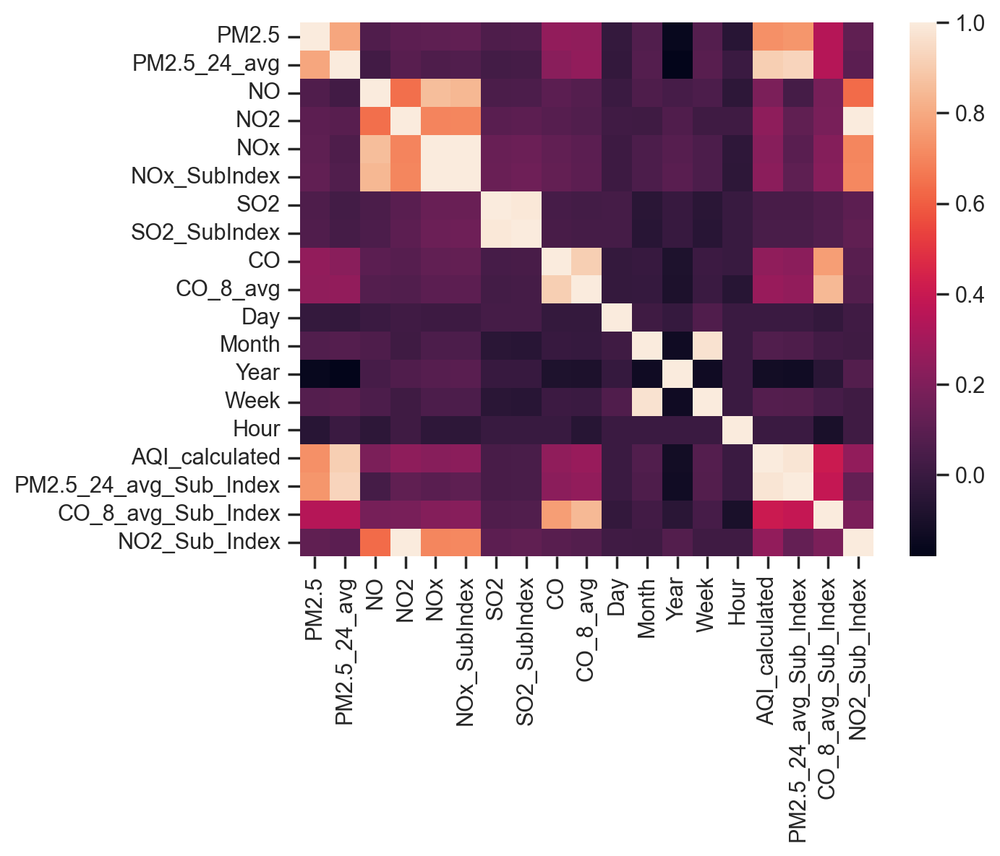

In [10]:
sns.heatmap(df.corr())

In [12]:
# Converting Categorical columns into Numeric by One Hot Encoding

df = pd.get_dummies(df, columns = ['Station', 'AQI_Bucket'])
df

,Datetime,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
0,2020-03-04 23:00:00,28.89,73.831667,7.25,21.37,28.63,35.7875,7.690000,9.612500,1.76,...,0,0,0,0,0,1,0,0,0,0
1,2020-03-05 00:00:00,21.17,71.019167,7.41,20.99,28.41,35.5125,7.440000,9.300000,1.71,...,0,0,0,0,0,1,0,0,0,0
2,2020-03-05 01:00:00,21.47,68.479583,7.48,20.49,27.97,34.9625,6.823333,8.529167,1.74,...,0,0,0,0,0,1,0,0,0,0
3,2020-03-05 02:00:00,31.70,66.369167,7.28,14.93,22.22,27.7750,6.633333,8.291667,1.60,...,0,0,0,0,0,1,0,0,0,0
4,2020-03-05 03:00:00,25.81,63.180417,7.85,17.92,25.77,32.2125,6.583333,8.229167,1.56,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147411,2023-03-26 03:00:00,83.22,49.372083,23.90,49.59,70.03,87.5375,41.300000,51.376923,0.87,...,0,0,0,1,0,0,0,1,0,0
147412,2023-03-26 04:00:00,71.96,50.378750,24.25,53.15,71.91,89.8875,40.560000,50.447179,0.66,...,0,0,0,1,0,0,0,1,0,0
147413,2023-03-26 05:00:00,75.47,51.747083,24.55,54.38,64.34,80.4250,40.820000,50.773846,0.28,...,0,0,0,1,0,0,0,1,0,0
147414,2023-03-26 06:00:00,69.07,52.885000,23.09,54.48,72.73,90.9125,39.290000,49.112500,0.43,...,0,0,0,1,0,0,0,1,0,0


In [13]:
# Checking NaNs 

df.isna().sum()
df.shape

Datetime                   0
PM2.5                      0
PM2.5_24_avg               0
NO                         0
NO2                        0
NOx                        0
NOx_SubIndex               0
SO2                        0
SO2_SubIndex               0
CO                         0
CO_8_avg                   0
Day                        0
Month                      0
Year                       0
Week                       0
Hour                       0
AQI_calculated             0
PM2.5_24_avg_Sub_Index     0
CO_8_avg_Sub_Index         0
NO2_Sub_Index              9
Station_NISE               0
Station_No Station         0
Station_Sector 51          0
Station_Teri Gram          0
Station_Vikas Sadan        0
AQI_Bucket_Good            0
AQI_Bucket_Moderate        0
AQI_Bucket_Poor            0
AQI_Bucket_Satisfactory    0
AQI_Bucket_Severe          0
AQI_Bucket_Very Poor       0
dtype: int64

(147416, 31)

- We see 9 NaNs in NO2_Sub_Index.

- Let's fix it.

In [14]:
# Remove NaNs

df[df['NO2_Sub_Index'].isna()]

,Datetime,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
21067,2022-07-30 18:00:00,17.29,15.032917,5.96,400.05,26.81,33.512500,4.396667,5.495833,1.04,...,0,0,0,0,1,0,0,0,0,0
22336,2022-09-21 15:00:00,42.35,39.991250,7.50,403.17,23.77,29.712500,4.540000,5.675000,0.57,...,0,0,0,0,0,0,0,1,0,0
34630,2016-10-20 03:00:00,64.32,60.990000,479.65,423.16,232.95,252.950000,4.480000,5.600000,0.34,...,1,0,0,0,0,0,1,0,0,0
34631,2016-10-20 04:00:00,64.57,61.052500,479.65,485.16,232.95,252.950000,7.180000,8.975000,0.25,...,1,0,0,0,0,0,1,0,0,0
34647,2016-10-20 20:00:00,64.25,69.726250,254.56,495.56,273.45,293.450000,4.450000,5.562500,0.62,...,1,0,0,0,0,0,1,0,0,0
37194,2017-02-03 23:00:00,354.82,289.357500,482.51,411.88,17.90,22.375000,11.600000,14.500000,2.06,...,1,0,0,0,0,0,0,0,1,0
39800,2017-05-23 13:00:00,69.45,267.099583,446.33,454.46,17.90,22.375000,0.260000,0.325000,0.78,...,1,0,0,0,0,0,0,0,1,0
55049,2019-02-17 22:00:00,74.18,57.266667,372.05,405.80,451.28,442.733333,8.370000,10.462500,2.42,...,1,0,0,0,0,0,0,0,1,0
136987,2022-01-15 19:00:00,122.85,114.531667,124.57,452.13,40.15,50.187500,7.390000,9.237500,0.65,...,0,0,0,1,0,0,1,0,0,0


In [17]:
df = df[~df['NO2_Sub_Index'].isna()]
df # Now removed

,Datetime,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
0,2020-03-04 23:00:00,28.89,73.831667,7.25,21.37,28.63,35.7875,7.690000,9.612500,1.76,...,0,0,0,0,0,1,0,0,0,0
1,2020-03-05 00:00:00,21.17,71.019167,7.41,20.99,28.41,35.5125,7.440000,9.300000,1.71,...,0,0,0,0,0,1,0,0,0,0
2,2020-03-05 01:00:00,21.47,68.479583,7.48,20.49,27.97,34.9625,6.823333,8.529167,1.74,...,0,0,0,0,0,1,0,0,0,0
3,2020-03-05 02:00:00,31.70,66.369167,7.28,14.93,22.22,27.7750,6.633333,8.291667,1.60,...,0,0,0,0,0,1,0,0,0,0
4,2020-03-05 03:00:00,25.81,63.180417,7.85,17.92,25.77,32.2125,6.583333,8.229167,1.56,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147411,2023-03-26 03:00:00,83.22,49.372083,23.90,49.59,70.03,87.5375,41.300000,51.376923,0.87,...,0,0,0,1,0,0,0,1,0,0
147412,2023-03-26 04:00:00,71.96,50.378750,24.25,53.15,71.91,89.8875,40.560000,50.447179,0.66,...,0,0,0,1,0,0,0,1,0,0
147413,2023-03-26 05:00:00,75.47,51.747083,24.55,54.38,64.34,80.4250,40.820000,50.773846,0.28,...,0,0,0,1,0,0,0,1,0,0
147414,2023-03-26 06:00:00,69.07,52.885000,23.09,54.48,72.73,90.9125,39.290000,49.112500,0.43,...,0,0,0,1,0,0,0,1,0,0


In [18]:
# Creating a copy

df_time_index = df.copy()
df_time_index

,Datetime,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
0,2020-03-04 23:00:00,28.89,73.831667,7.25,21.37,28.63,35.7875,7.690000,9.612500,1.76,...,0,0,0,0,0,1,0,0,0,0
1,2020-03-05 00:00:00,21.17,71.019167,7.41,20.99,28.41,35.5125,7.440000,9.300000,1.71,...,0,0,0,0,0,1,0,0,0,0
2,2020-03-05 01:00:00,21.47,68.479583,7.48,20.49,27.97,34.9625,6.823333,8.529167,1.74,...,0,0,0,0,0,1,0,0,0,0
3,2020-03-05 02:00:00,31.70,66.369167,7.28,14.93,22.22,27.7750,6.633333,8.291667,1.60,...,0,0,0,0,0,1,0,0,0,0
4,2020-03-05 03:00:00,25.81,63.180417,7.85,17.92,25.77,32.2125,6.583333,8.229167,1.56,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147411,2023-03-26 03:00:00,83.22,49.372083,23.90,49.59,70.03,87.5375,41.300000,51.376923,0.87,...,0,0,0,1,0,0,0,1,0,0
147412,2023-03-26 04:00:00,71.96,50.378750,24.25,53.15,71.91,89.8875,40.560000,50.447179,0.66,...,0,0,0,1,0,0,0,1,0,0
147413,2023-03-26 05:00:00,75.47,51.747083,24.55,54.38,64.34,80.4250,40.820000,50.773846,0.28,...,0,0,0,1,0,0,0,1,0,0
147414,2023-03-26 06:00:00,69.07,52.885000,23.09,54.48,72.73,90.9125,39.290000,49.112500,0.43,...,0,0,0,1,0,0,0,1,0,0


In [19]:
# Convert the dtype of Datetime column

df_time_index['Datetime'] = pd.to_datetime(df_time_index['Datetime'])
df_time_index

,Datetime,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
0,2020-03-04 23:00:00,28.89,73.831667,7.25,21.37,28.63,35.7875,7.690000,9.612500,1.76,...,0,0,0,0,0,1,0,0,0,0
1,2020-03-05 00:00:00,21.17,71.019167,7.41,20.99,28.41,35.5125,7.440000,9.300000,1.71,...,0,0,0,0,0,1,0,0,0,0
2,2020-03-05 01:00:00,21.47,68.479583,7.48,20.49,27.97,34.9625,6.823333,8.529167,1.74,...,0,0,0,0,0,1,0,0,0,0
3,2020-03-05 02:00:00,31.70,66.369167,7.28,14.93,22.22,27.7750,6.633333,8.291667,1.60,...,0,0,0,0,0,1,0,0,0,0
4,2020-03-05 03:00:00,25.81,63.180417,7.85,17.92,25.77,32.2125,6.583333,8.229167,1.56,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147411,2023-03-26 03:00:00,83.22,49.372083,23.90,49.59,70.03,87.5375,41.300000,51.376923,0.87,...,0,0,0,1,0,0,0,1,0,0
147412,2023-03-26 04:00:00,71.96,50.378750,24.25,53.15,71.91,89.8875,40.560000,50.447179,0.66,...,0,0,0,1,0,0,0,1,0,0
147413,2023-03-26 05:00:00,75.47,51.747083,24.55,54.38,64.34,80.4250,40.820000,50.773846,0.28,...,0,0,0,1,0,0,0,1,0,0
147414,2023-03-26 06:00:00,69.07,52.885000,23.09,54.48,72.73,90.9125,39.290000,49.112500,0.43,...,0,0,0,1,0,0,0,1,0,0


In [20]:
# Set the index

df_time_index.set_index('Datetime', drop=True, inplace=True)

In [21]:
df_time_index

,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,CO_8_avg,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
Datetime,,,,,,,,,,,,,,,,,,,,,
2020-03-04 23:00:00,28.89,73.831667,7.25,21.37,28.63,35.7875,7.690000,9.612500,1.76,1.75000,...,0,0,0,0,0,1,0,0,0,0
2020-03-05 00:00:00,21.17,71.019167,7.41,20.99,28.41,35.5125,7.440000,9.300000,1.71,1.72750,...,0,0,0,0,0,1,0,0,0,0
2020-03-05 01:00:00,21.47,68.479583,7.48,20.49,27.97,34.9625,6.823333,8.529167,1.74,1.72125,...,0,0,0,0,0,1,0,0,0,0
2020-03-05 02:00:00,31.70,66.369167,7.28,14.93,22.22,27.7750,6.633333,8.291667,1.60,1.71250,...,0,0,0,0,0,1,0,0,0,0
2020-03-05 03:00:00,25.81,63.180417,7.85,17.92,25.77,32.2125,6.583333,8.229167,1.56,1.71125,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-26 03:00:00,83.22,49.372083,23.90,49.59,70.03,87.5375,41.300000,51.376923,0.87,1.71000,...,0,0,0,1,0,0,0,1,0,0
2023-03-26 04:00:00,71.96,50.378750,24.25,53.15,71.91,89.8875,40.560000,50.447179,0.66,1.51125,...,0,0,0,1,0,0,0,1,0,0
2023-03-26 05:00:00,75.47,51.747083,24.55,54.38,64.34,80.4250,40.820000,50.773846,0.28,0.94250,...,0,0,0,1,0,0,0,1,0,0


In [22]:
df_time_index.index

DatetimeIndex(['2020-03-04 23:00:00', '2020-03-05 00:00:00',
               '2020-03-05 01:00:00', '2020-03-05 02:00:00',
               '2020-03-05 03:00:00', '2020-03-05 04:00:00',
               '2020-03-05 05:00:00', '2020-03-05 06:00:00',
               '2020-03-05 07:00:00', '2020-03-05 08:00:00',
               ...
               '2023-03-25 22:00:00', '2023-03-25 23:00:00',
               '2023-03-26 00:00:00', '2023-03-26 01:00:00',
               '2023-03-26 02:00:00', '2023-03-26 03:00:00',
               '2023-03-26 04:00:00', '2023-03-26 05:00:00',
               '2023-03-26 06:00:00', '2023-03-26 07:00:00'],
              dtype='datetime64[ns]', name='Datetime', length=147407, freq=None)

<Figure size 3000x800 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='AQI_calculated'>

Text(0.5, 1.0, 'AQI data 2016 to 2023 March')

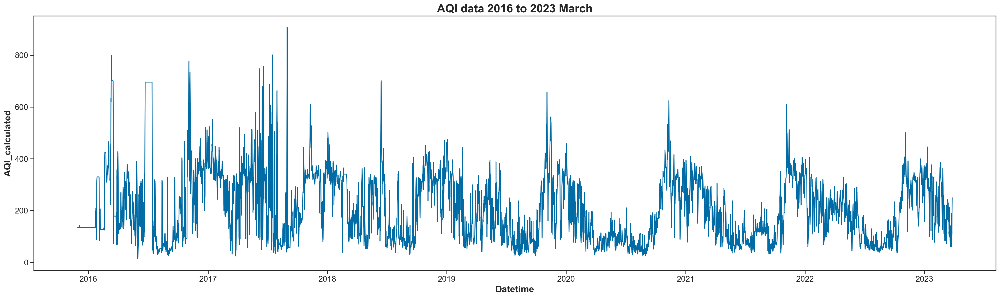

In [25]:
plt.figure(figsize=(30,8))
sns.lineplot(data = df_time_index, x=df_time_index.index, y = 'AQI_calculated', errorbar=None)
plt.title("AQI data 2016 to 2023 March")

## Without feature scaling like normalizaton & standardization

In [18]:
df 

,Datetime,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
0,2020-03-04 23:00:00,28.89,73.831667,7.25,21.37,28.63,35.7875,7.690000,9.612500,1.76,...,0,0,0,0,0,1,0,0,0,0
1,2020-03-05 00:00:00,21.17,71.019167,7.41,20.99,28.41,35.5125,7.440000,9.300000,1.71,...,0,0,0,0,0,1,0,0,0,0
2,2020-03-05 01:00:00,21.47,68.479583,7.48,20.49,27.97,34.9625,6.823333,8.529167,1.74,...,0,0,0,0,0,1,0,0,0,0
3,2020-03-05 02:00:00,31.70,66.369167,7.28,14.93,22.22,27.7750,6.633333,8.291667,1.60,...,0,0,0,0,0,1,0,0,0,0
4,2020-03-05 03:00:00,25.81,63.180417,7.85,17.92,25.77,32.2125,6.583333,8.229167,1.56,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147411,2023-03-26 03:00:00,83.22,49.372083,23.90,49.59,70.03,87.5375,41.300000,51.376923,0.87,...,0,0,0,1,0,0,0,1,0,0
147412,2023-03-26 04:00:00,71.96,50.378750,24.25,53.15,71.91,89.8875,40.560000,50.447179,0.66,...,0,0,0,1,0,0,0,1,0,0
147413,2023-03-26 05:00:00,75.47,51.747083,24.55,54.38,64.34,80.4250,40.820000,50.773846,0.28,...,0,0,0,1,0,0,0,1,0,0
147414,2023-03-26 06:00:00,69.07,52.885000,23.09,54.48,72.73,90.9125,39.290000,49.112500,0.43,...,0,0,0,1,0,0,0,1,0,0


In [19]:
X_train, X_test, y_train, y_test = train_test_split(df.drop([
     'Datetime','PM2.5_24_avg', 'NOx_SubIndex', 'SO2_SubIndex', 'CO_8_avg', 'Day', 'Month',
    'Year', 'Week', 'Hour', 'PM2.5_24_avg_Sub_Index', 'Station_NISE',
    'Station_No Station', 'Station_Sector 51', 'Station_Teri Gram',
    'Station_Vikas Sadan', 'CO_8_avg_Sub_Index', 'NO2_Sub_Index',
    'AQI_Bucket_Good', 'AQI_Bucket_Moderate', 'AQI_Bucket_Poor',
    'AQI_Bucket_Satisfactory', 'AQI_Bucket_Severe', 'AQI_Bucket_Very Poor', 'AQI_calculated'
],
                                                                       axis=1),
                                                    df['AQI_calculated'],
                                                    train_size=0.7)

In [20]:
X_train
X_test
y_train
y_test

,PM2.5,NO,NO2,NOx,SO2,CO
79174,107.91,6.02,2.02,5.88,5.36,0.59
73185,132.83,1.58,6.61,11.76,2.60,0.56
117586,58.20,34.61,46.65,52.13,5.96,0.89
30893,68.79,0.63,7.00,9.00,12.20,1.05
124451,58.35,3.56,6.03,2.36,2.05,0.05
...,...,...,...,...,...,...
59118,17.69,7.42,5.72,9.30,5.10,0.42
64770,27.01,4.95,17.98,12.28,15.48,0.48
66795,43.47,7.07,8.58,10.54,2.96,0.39
101059,176.53,63.53,10.05,56.20,9.62,1.70


,PM2.5,NO,NO2,NOx,SO2,CO
141156,46.20,9.71,11.54,16.65,6.350000,0.41
123857,52.50,4.54,8.35,8.01,8.170000,0.04
12840,1.71,448.38,184.34,265.93,1.376667,1.29
132623,41.17,4.83,31.39,20.29,6.760000,0.68
20651,7.09,7.73,23.72,31.45,4.126667,0.82
...,...,...,...,...,...,...
82503,103.78,16.19,25.99,6.09,1.400000,0.92
38184,103.17,9.43,18.13,17.90,26.910000,0.58
131725,71.33,5.46,34.92,22.65,18.510000,0.00
118400,145.20,5.15,32.00,20.84,6.630000,1.14


79174     111.0
73185     348.0
117586    229.0
30893     168.0
124451     81.0
          ...  
59118      79.0
64770      29.0
66795      81.0
101059    245.0
91172     316.0
Name: AQI_calculated, Length: 103184, dtype: float64

141156     77.0
123857     75.0
12840     286.0
132623     86.0
20651      50.0
          ...  
82503     316.0
38184     291.0
131725    107.0
118400    324.0
140190    307.0
Name: AQI_calculated, Length: 44223, dtype: float64

LinearRegression()


LinearRegression()

,y_pred,y_test
103639,119.846041,73.0
74486,171.855502,212.0
78298,139.601302,84.0
49781,126.269099,101.0
57868,147.032371,155.0
...,...,...
4401,135.194877,69.0
137247,168.156719,245.0
118943,143.079071,177.0
69036,135.304369,226.0



Correlation b/w actual and predicted 0.7518516595925709


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'LinearRegression()')


score(X_test, y_test)  0.5652727951495575

CV scores [0.58610507 0.41399557 0.55727591 0.55706576 0.55975128]

Average cv score  0.5348387146880529

mean_squared_log_error  0.5262959544014745

mean_squared_error  7006.502284661499

r2_score  0.5652727951495575



DecisionTreeRegressor()


DecisionTreeRegressor()

,y_pred,y_test
103639,187.0,73.0
74486,209.0,212.0
78298,488.0,84.0
49781,64.0,101.0
57868,112.0,155.0
...,...,...
4401,139.0,69.0
137247,186.0,245.0
118943,67.0,177.0
69036,92.0,226.0



Correlation b/w actual and predicted 0.7781350341438911


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'DecisionTreeRegressor()')


score(X_test, y_test)  0.5556451034343843

CV scores [0.3420004  0.3206078  0.29642654 0.31123143 0.22031496]

Average cv score  0.2981162261753509

mean_squared_log_error  0.48641033934873273

mean_squared_error  7161.67187893979

r2_score  0.5556451034343843



RandomForestRegressor()


RandomForestRegressor()

,y_pred,y_test
103639,100.010000,73.0
74486,212.420000,212.0
78298,171.414330,84.0
49781,76.070000,101.0
57868,149.880000,155.0
...,...,...
4401,118.930000,69.0
137247,202.990000,245.0
118943,109.270667,177.0
69036,94.480000,226.0



Correlation b/w actual and predicted 0.8814820969894872


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'RandomForestRegressor()')


score(X_test, y_test)  0.776906348781462

CV scores [0.65702382 0.54450719 0.6506553  0.6477377  0.63270776]

Average cv score  0.626526352252388

mean_squared_log_error  0.3556499602309641

mean_squared_error  3595.602390455209

r2_score  0.776906348781462



AdaBoostRegressor()


AdaBoostRegressor()

,y_pred,y_test
103639,213.718148,73.0
74486,233.389779,212.0
78298,213.718148,84.0
49781,193.415873,101.0
57868,224.767454,155.0
...,...,...
4401,239.220991,69.0
137247,211.876072,245.0
118943,217.241828,177.0
69036,239.220991,226.0



Correlation b/w actual and predicted 0.7338137435236467


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'AdaBoostRegressor()')


score(X_test, y_test)  0.104836555324896

CV scores [0.37636047 0.49687096 0.31081346 0.30092955 0.06972821]

Average cv score  0.31094052865320954

mean_squared_log_error  0.8355280992049688

mean_squared_error  14427.357318066383

r2_score  0.104836555324896



BaggingRegressor()


BaggingRegressor()

,y_pred,y_test
103639,87.9,73.0
74486,283.4,212.0
78298,129.8,84.0
49781,115.3,101.0
57868,196.7,155.0
...,...,...
4401,124.3,69.0
137247,205.7,245.0
118943,74.2,177.0
69036,82.6,226.0



Correlation b/w actual and predicted 0.8685024421304851


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'BaggingRegressor()')


score(X_test, y_test)  0.7539437657148625

CV scores [0.62182062 0.51872335 0.61682345 0.61187879 0.59827138]

Average cv score  0.5935035174931537

mean_squared_log_error  0.3736936151647242

mean_squared_error  3965.6905490125

r2_score  0.7539437657148625





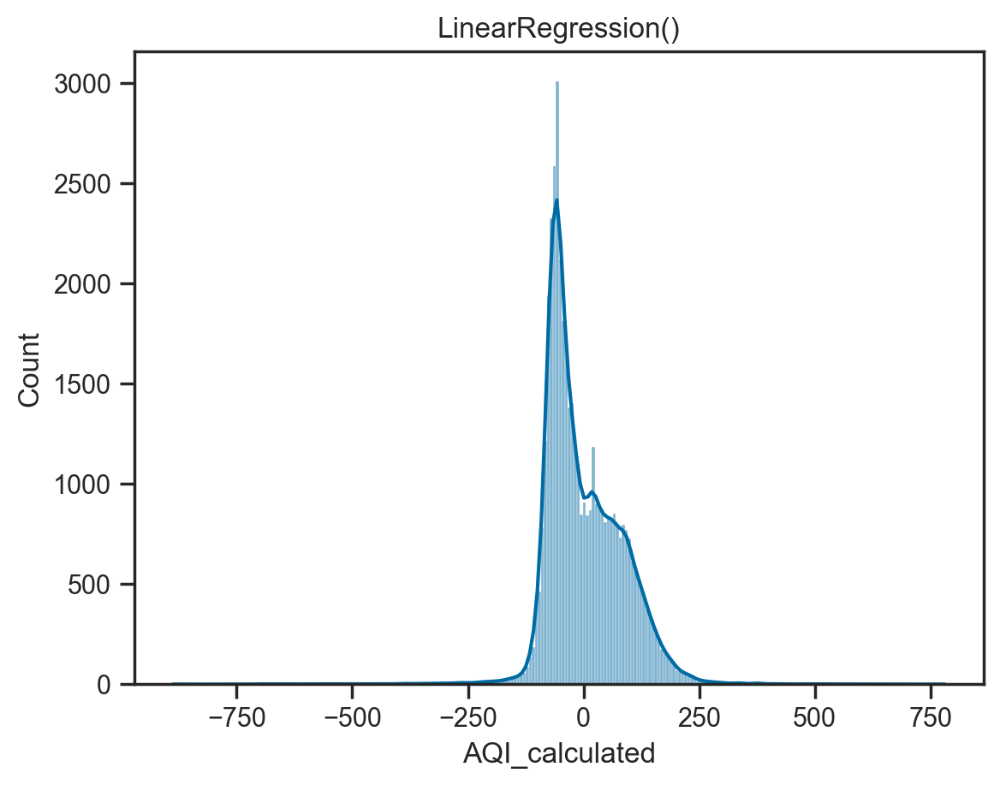

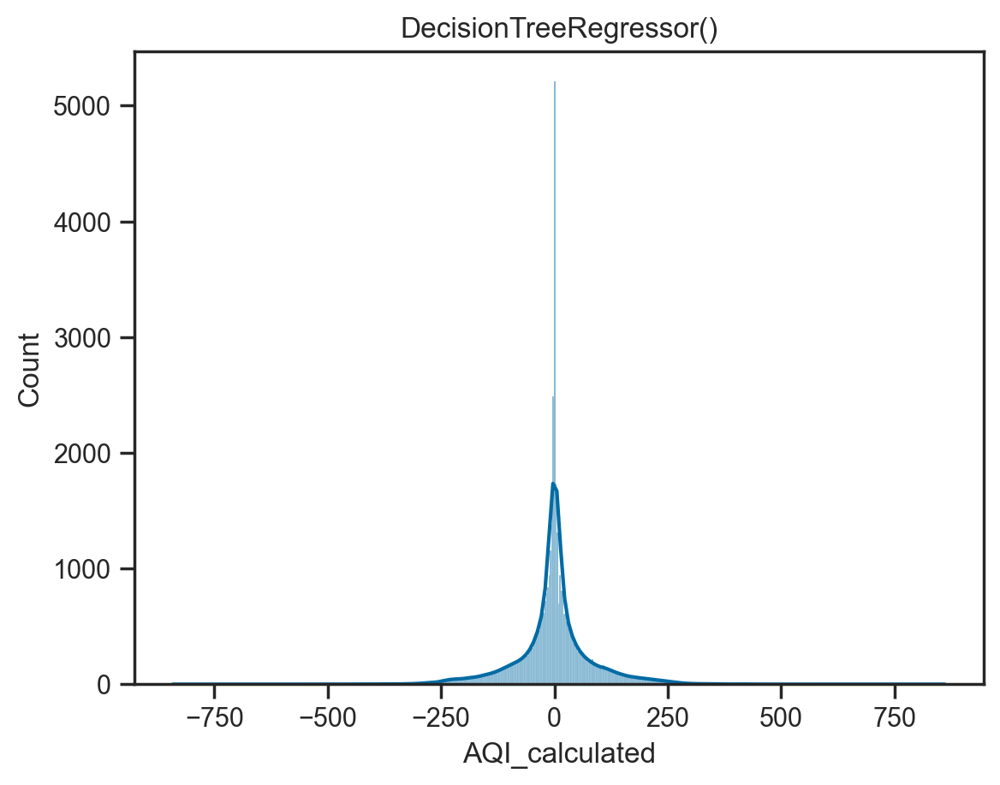

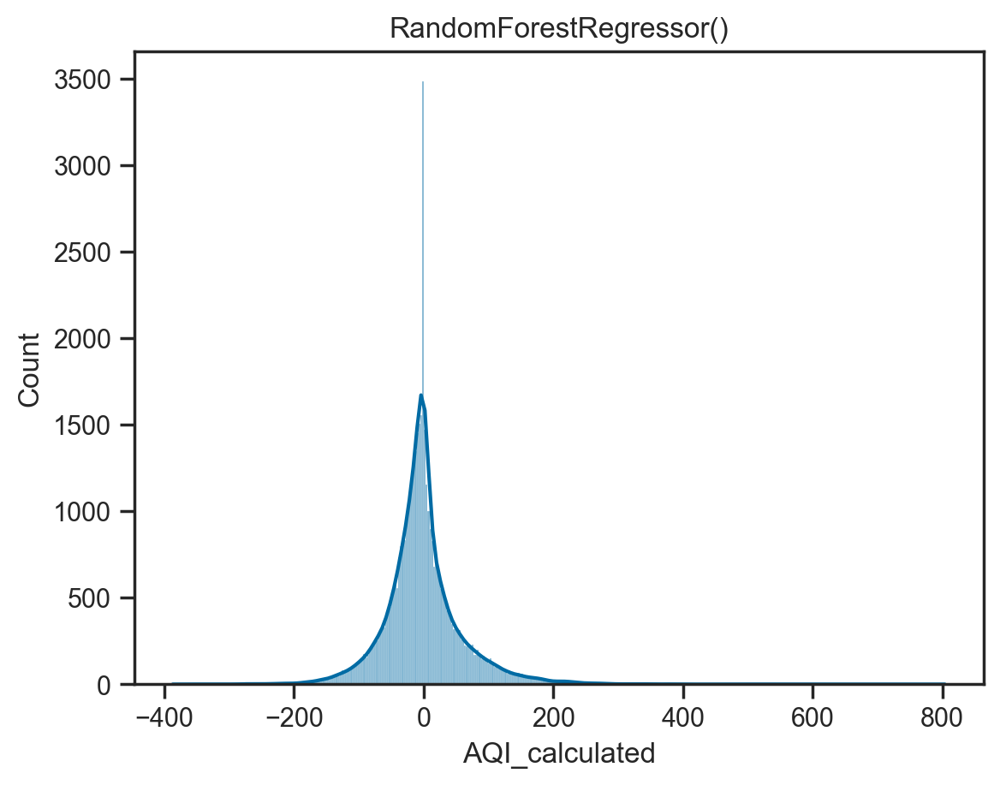

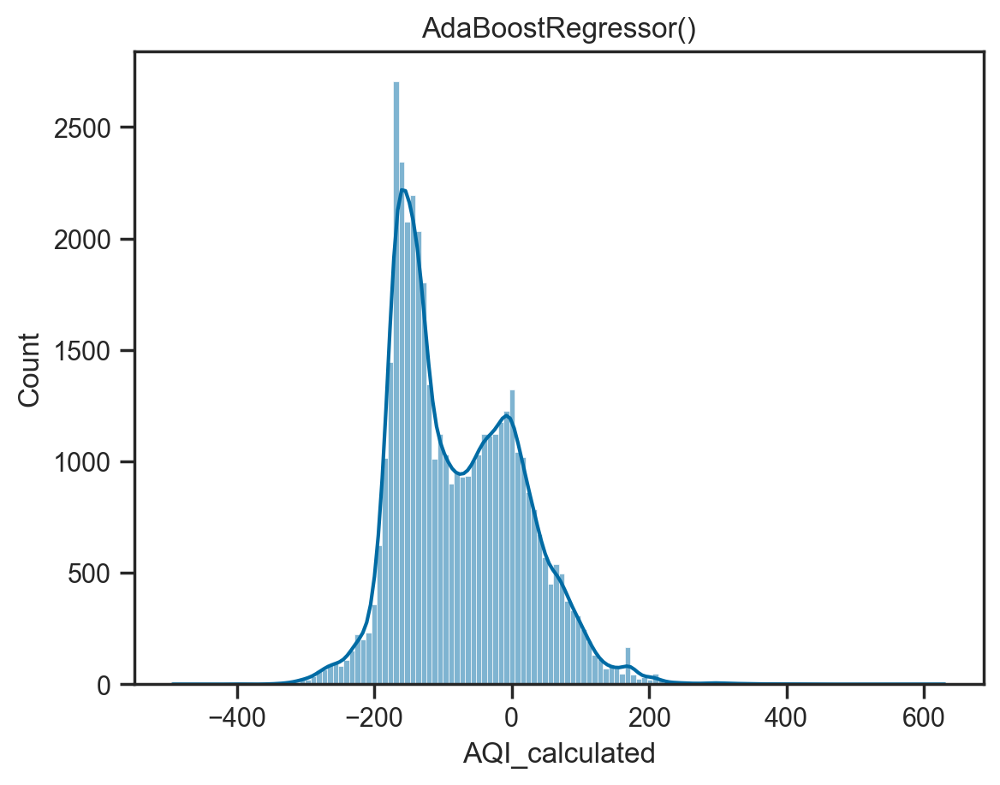

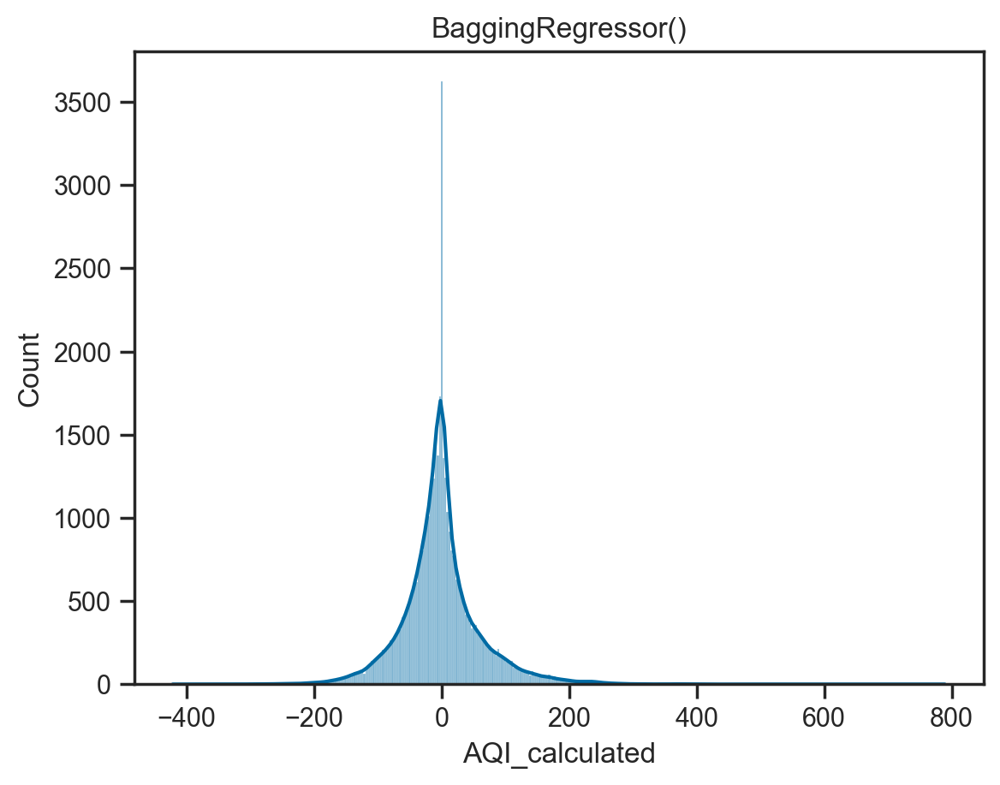

In [39]:
lr = LinearRegression()
d_tree = DecisionTreeRegressor()
rf = RandomForestRegressor()
ab = AdaBoostRegressor()
br = BaggingRegressor()

for i in [lr, d_tree, rf, ab, br]:
    #     helper(i)
    model = i
    print(i)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    predicted_actual = pd.DataFrame({'y_pred': y_pred, "y_test": y_test})
    predicted_actual
    print("\nCorrelation b/w actual and predicted",
          predicted_actual['y_pred'].corr(predicted_actual['y_test']))
    plt.figure()
    sns.histplot(y_test - y_pred, kde=True)
    plt.title(model)
    print("\nscore(X_test, y_test) ", model.score(X_test, y_test))

    s = cross_val_score(estimator=model,
                        X=df[['PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO']],
                        y=df['AQI_calculated'],
                        scoring='r2',
                        cv=5)
    print("\nCV scores", s)
    print("\nAverage cv score ", np.mean(s))
    print("\nmean_squared_log_error ",
          str(mean_squared_log_error(y_test, y_pred, squared=False)))
    print("\nmean_squared_error ", abs(mean_squared_error(y_test, y_pred)))
    print("\nr2_score ", r2_score(y_test, y_pred))
    print("\n\n")

In [21]:
# from sklearn.model_selection import GridSearchCV
# parameters = {'max_features': ['sqrt'], 'n_estimators': [1000]}
# clf_rf = GridSearchCV(RandomForestRegressor(), parameters)
# clf_rf.fit(X_train.values, y_train.values)
# clf_rf.best_params_
# clf_rf.best_score_

from sklearn.model_selection import GridSearchCV
parameters = {'max_features': ['sqrt'], 'n_estimators': [100]}
clf_rf = GridSearchCV(RandomForestRegressor(), parameters)
clf_rf.fit(X_train.values, y_train.values)
clf_rf.best_params_
clf_rf.best_score_

GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'max_features': ['sqrt'], 'n_estimators': [100]})

{'max_features': 'sqrt', 'n_estimators': 100}

0.7922629449344148

In [26]:
X_train.columns
# model_clf_rf.predict([[ 34, 121, 121, 8, 0, 0]])
clf_rf.predict([[ 34, 121, 121, 8, 0, 0]])

Index(['PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO'], dtype='object')

array([170.00389474])

In [23]:
import pickle

In [24]:
# pickle.dump(clf_rf, open('/Users/pranaii1729/Jupyter Notebooks/My-Jupyter-Notebooks/My-Jupyter-Notebooks/Omdena/gurugram-india-chapter-air-quality/model_clf_rf.pkl','wb'))

# model_clf_rf = pickle.load(open('/Users/pranaii1729/Jupyter Notebooks/My-Jupyter-Notebooks/My-Jupyter-Notebooks/Omdena/gurugram-india-chapter-air-quality/model_clf_rf.pkl', 'rb'))
# model_clf_rf

GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'max_features': ['sqrt'], 'n_estimators': [100]})

In [40]:
# pickle.dump(rf, open('/Users/pranaii1729/Jupyter Notebooks/My-Jupyter-Notebooks/My-Jupyter-Notebooks/Omdena/gurugram-india-chapter-air-quality/model_rf.pkl','wb'))

# model_rf = pickle.load(open('/Users/pranaii1729/Jupyter Notebooks/My-Jupyter-Notebooks/My-Jupyter-Notebooks/Omdena/gurugram-india-chapter-air-quality/model_rf.pkl', 'rb'))
# model_rf

RandomForestRegressor()

In [48]:
# X_train[:2]
# y_train[:2]
# rf.predict(X_train[:1])
# rf.predict(X_train[:2])
model_rf.predict([[ 34, 121, 121, 8, 0, 0]])
rf.predict([[ 34, 121, 121, 8, 0, 0]])

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


array([194.99])

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


array([194.99])

### Including datetime for training


In [27]:
X_train_date, X_test_date, y_train_date, y_test_date = train_test_split(df.drop([
     'Datetime','PM2.5_24_avg', 'NOx_SubIndex', 'SO2_SubIndex', 'CO_8_avg','PM2.5_24_avg_Sub_Index', 'Station_NISE',
    'Station_No Station', 'Station_Sector 51', 'Station_Teri Gram',
    'Station_Vikas Sadan', 'CO_8_avg_Sub_Index', 'NO2_Sub_Index',
    'AQI_Bucket_Good', 'AQI_Bucket_Moderate', 'AQI_Bucket_Poor',
    'AQI_Bucket_Satisfactory', 'AQI_Bucket_Severe', 'AQI_Bucket_Very Poor', 'AQI_calculated'
],
                                                                       axis=1),
                                                    df['AQI_calculated'],
                                                    train_size=0.7)

In [28]:
X_train_date
X_test_date
y_train_date
y_test_date

,PM2.5,NO,NO2,NOx,SO2,CO,Day,Month,Year,Week,Hour
140826,46.20,9.71,11.54,16.65,6.35,0.41,24,6,2022,25,18
62826,107.30,4.92,31.85,22.24,7.17,1.23,7,1,2020,2,23
28595,68.77,10.00,10.00,10.00,25.52,0.18,11,2,2016,6,16
52530,223.55,49.17,19.09,67.23,10.85,0.46,4,11,2018,44,23
32675,17.87,4.00,11.09,5.00,1.02,0.06,30,7,2016,30,16
...,...,...,...,...,...,...,...,...,...,...,...
102163,131.60,40.33,12.75,53.08,1.02,1.78,15,2,2021,7,4
65868,56.64,5.96,22.88,12.09,7.30,0.52,13,5,2020,20,17
36840,147.98,6.19,9.58,17.90,6.76,0.70,20,1,2017,3,5
66640,64.38,5.12,9.54,9.66,7.52,0.55,14,6,2020,24,21


,PM2.5,NO,NO2,NOx,SO2,CO,Day,Month,Year,Week,Hour
136796,53.20,15.02,35.38,22.55,7.790000,0.76,7,1,2022,1,20
141862,46.20,9.71,11.54,16.65,6.350000,0.41,6,8,2022,31,22
90398,117.70,8.78,28.43,16.28,2.560000,1.61,3,11,2022,44,17
96697,88.28,10.81,2.99,10.05,11.390000,0.81,2,7,2020,27,10
55085,69.07,27.10,149.97,90.14,7.790000,0.55,19,2,2019,8,10
...,...,...,...,...,...,...,...,...,...,...,...
75840,109.17,1.24,7.37,14.95,1.030000,1.21,7,3,2021,9,3
25519,84.35,3.54,14.86,18.39,7.623333,0.33,1,2,2023,5,6
27287,71.08,11.98,15.13,14.59,4.560000,1.36,19,12,2015,51,4
17501,84.91,3.11,12.27,15.38,7.143333,0.79,4,3,2022,9,4


140826     77.0
62826     200.0
28595     128.0
52530     273.0
32675      34.0
          ...  
102163    203.0
65868     112.0
36840     342.0
66640     143.0
67935      86.0
Name: AQI_calculated, Length: 103184, dtype: float64

136796    109.0
141862     77.0
90398     442.0
96697     167.0
55085     170.0
          ...  
75840     278.0
25519     122.0
27287     135.0
17501     138.0
86775     182.0
Name: AQI_calculated, Length: 44223, dtype: float64

LinearRegression()


LinearRegression()

,y_pred_date,y_test_date
136796,154.098168,109.0
141862,134.912509,77.0
90398,215.152046,442.0
96697,162.052459,167.0
55085,252.710340,170.0
...,...,...
75840,179.474456,278.0
25519,154.787145,122.0
27287,168.946872,135.0
17501,156.043581,138.0



Correlation b/w actual and predicted 0.7549789182547638


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'LinearRegression()')


score(X_test, y_test_date)  0.569986854130694

CV scores [0.59351497 0.33318544 0.55465196 0.55032107 0.55003425]

Average cv score  0.51634153727578

mean_squared_log_error  0.5280993488030746

mean_squared_error  6875.485512858773

r2_score  0.569986854130694



DecisionTreeRegressor()


DecisionTreeRegressor()

,y_pred_date,y_test_date
136796,111.0,109.0
141862,77.0,77.0
90398,330.0,442.0
96697,167.0,167.0
55085,120.0,170.0
...,...,...
75840,275.0,278.0
25519,207.0,122.0
27287,135.0,135.0
17501,76.0,138.0



Correlation b/w actual and predicted 0.905463225980504


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'DecisionTreeRegressor()')


score(X_test, y_test_date)  0.8109036050497762

CV scores [0.39464873 0.22808773 0.56359099 0.53655227 0.52666685]

Average cv score  0.44990931430126563

mean_squared_log_error  0.30943221739704047

mean_squared_error  3023.4645998688466

r2_score  0.8109036050497762



RandomForestRegressor()


RandomForestRegressor()

,y_pred_date,y_test_date
136796,110.25,109.0
141862,77.00,77.0
90398,351.61,442.0
96697,165.07,167.0
55085,173.50,170.0
...,...,...
75840,280.30,278.0
25519,159.14,122.0
27287,135.00,135.0
17501,122.43,138.0



Correlation b/w actual and predicted 0.9512846521868535


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'RandomForestRegressor()')


score(X_test, y_test_date)  0.904418051889981

CV scores [0.62997039 0.45074482 0.77024853 0.76853302 0.79037567]

Average cv score  0.6819744877542522

mean_squared_log_error  0.22678847596791177

mean_squared_error  1528.2609516337652

r2_score  0.904418051889981



AdaBoostRegressor()


AdaBoostRegressor()

,y_pred_date,y_test_date
136796,229.673888,109.0
141862,152.643522,77.0
90398,337.790035,442.0
96697,222.744660,167.0
55085,284.756444,170.0
...,...,...
75840,260.064924,278.0
25519,249.424882,122.0
27287,298.901158,135.0
17501,210.379799,138.0



Correlation b/w actual and predicted 0.7982703943544698


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'AdaBoostRegressor()')


score(X_test, y_test_date)  0.47363959750016704

CV scores [0.32137225 0.44132727 0.50741398 0.58932057 0.62890783]

Average cv score  0.49766837879302794

mean_squared_log_error  0.6646634653168069

mean_squared_error  8415.982991901446

r2_score  0.47363959750016704



BaggingRegressor()


BaggingRegressor()

,y_pred_date,y_test_date
136796,111.2,109.0
141862,77.0,77.0
90398,367.6,442.0
96697,158.7,167.0
55085,189.6,170.0
...,...,...
75840,282.8,278.0
25519,160.9,122.0
27287,135.0,135.0
17501,102.5,138.0



Correlation b/w actual and predicted 0.9434333760949088


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'BaggingRegressor()')


score(X_test, y_test_date)  0.8899889157464547

CV scores [0.59398821 0.45712088 0.7505302  0.74367066 0.76593197]

Average cv score  0.6622483853419711

mean_squared_log_error  0.24281494207699747

mean_squared_error  1758.968588065034

r2_score  0.8899889157464547





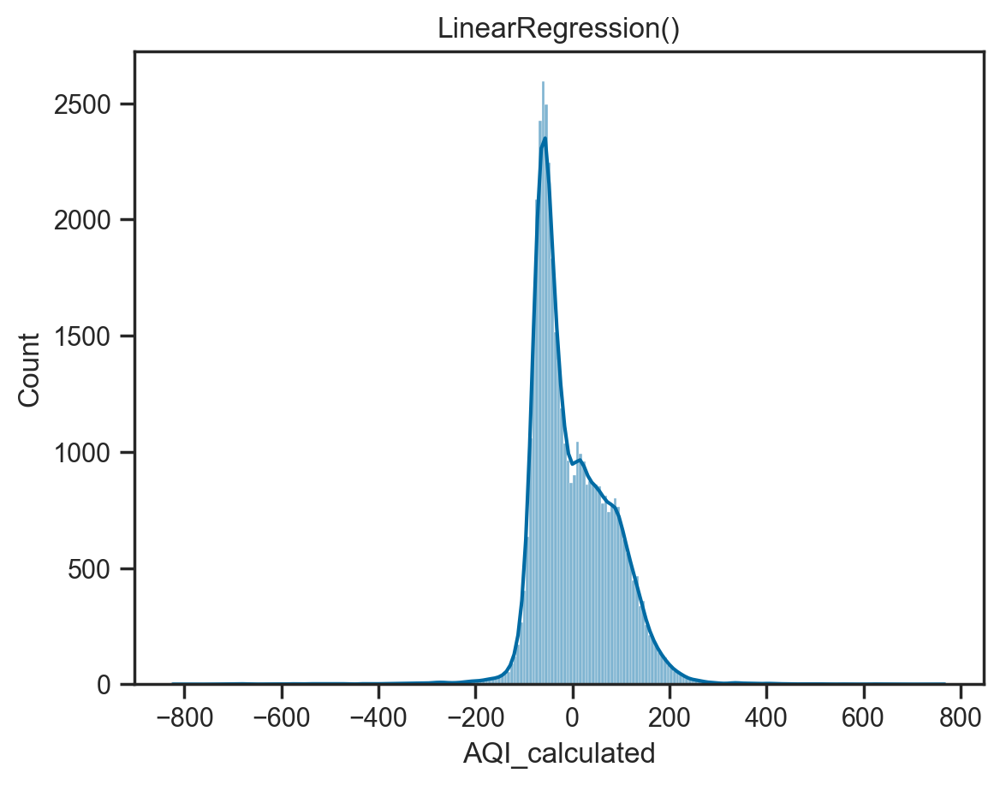

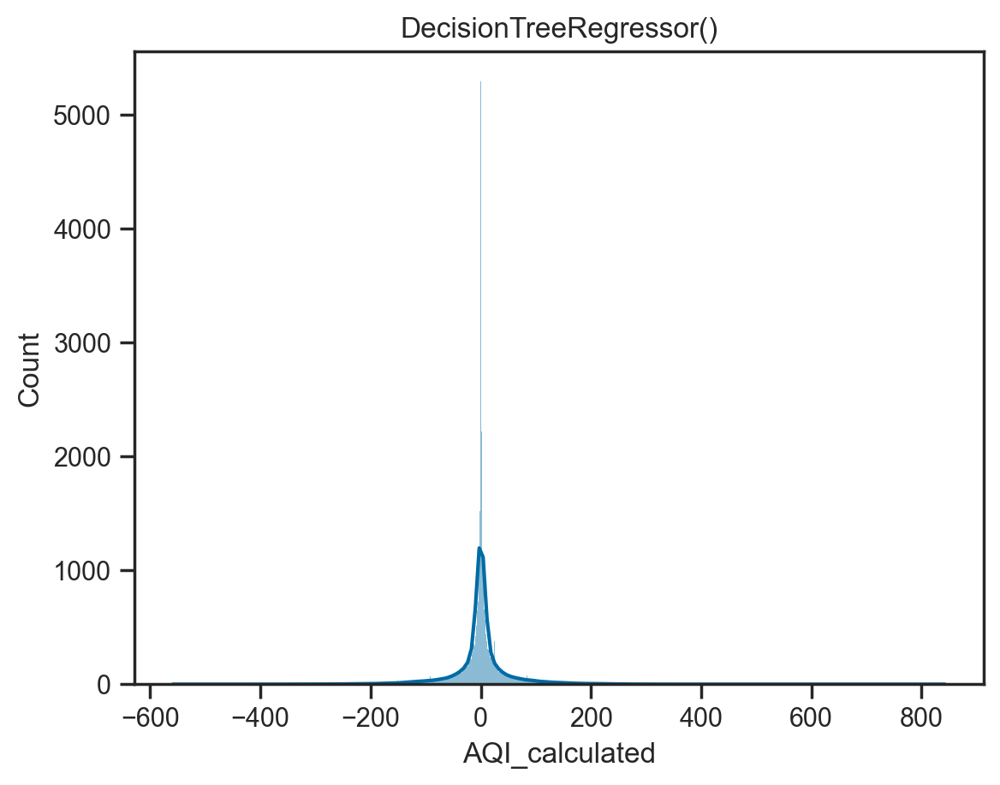

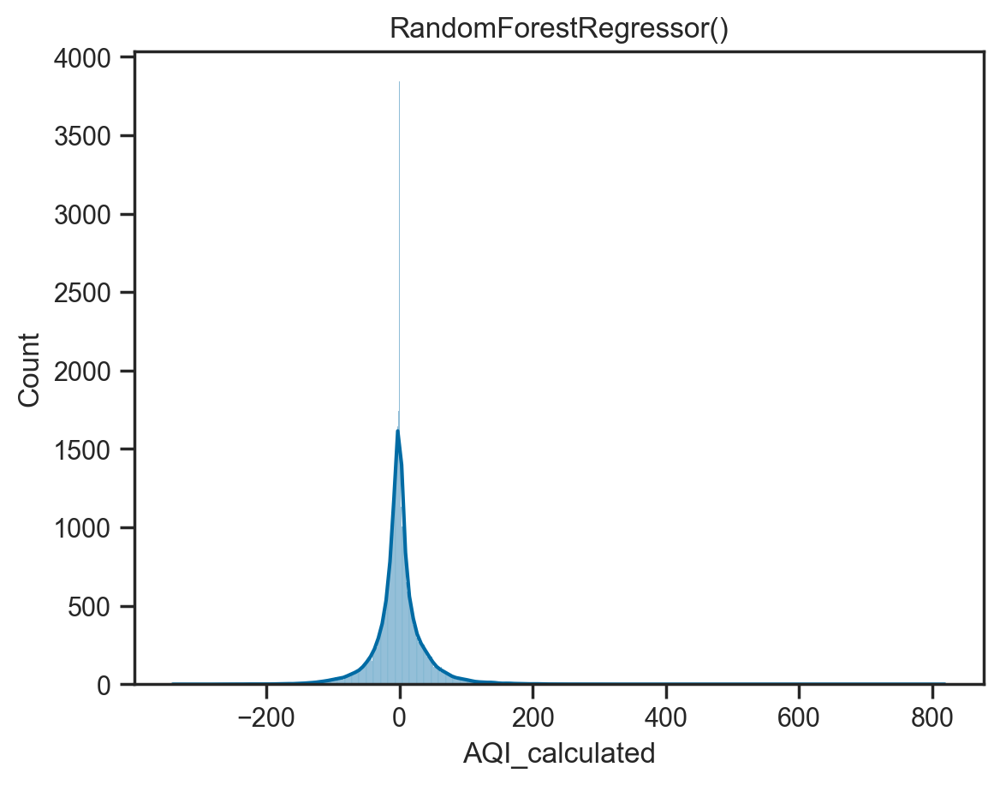

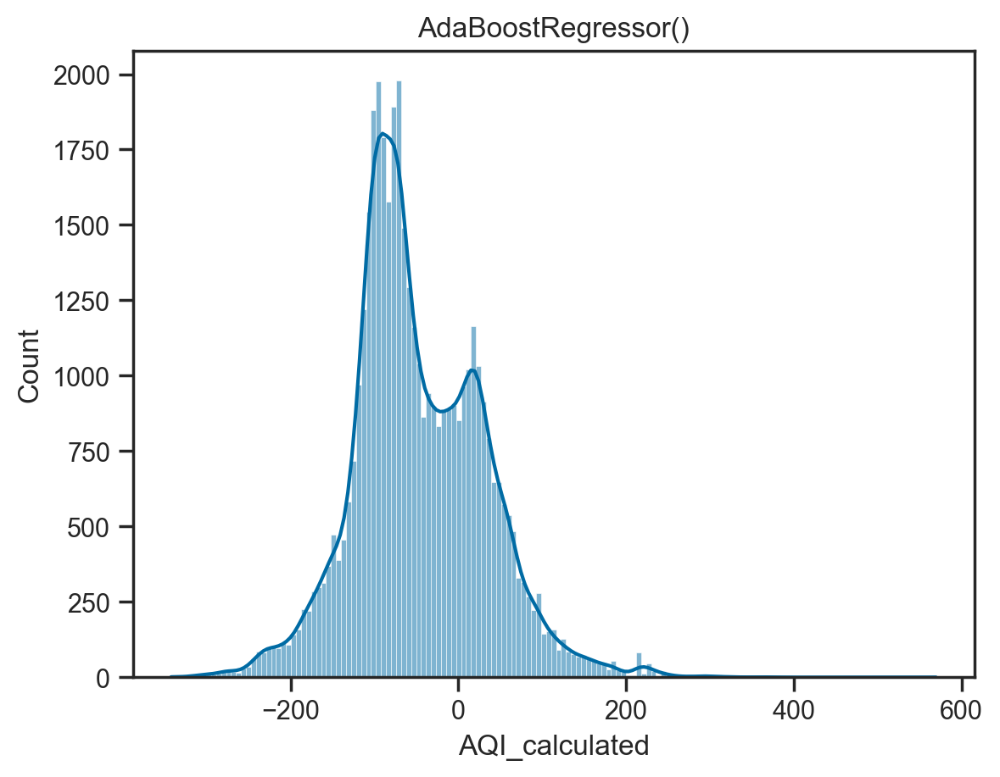

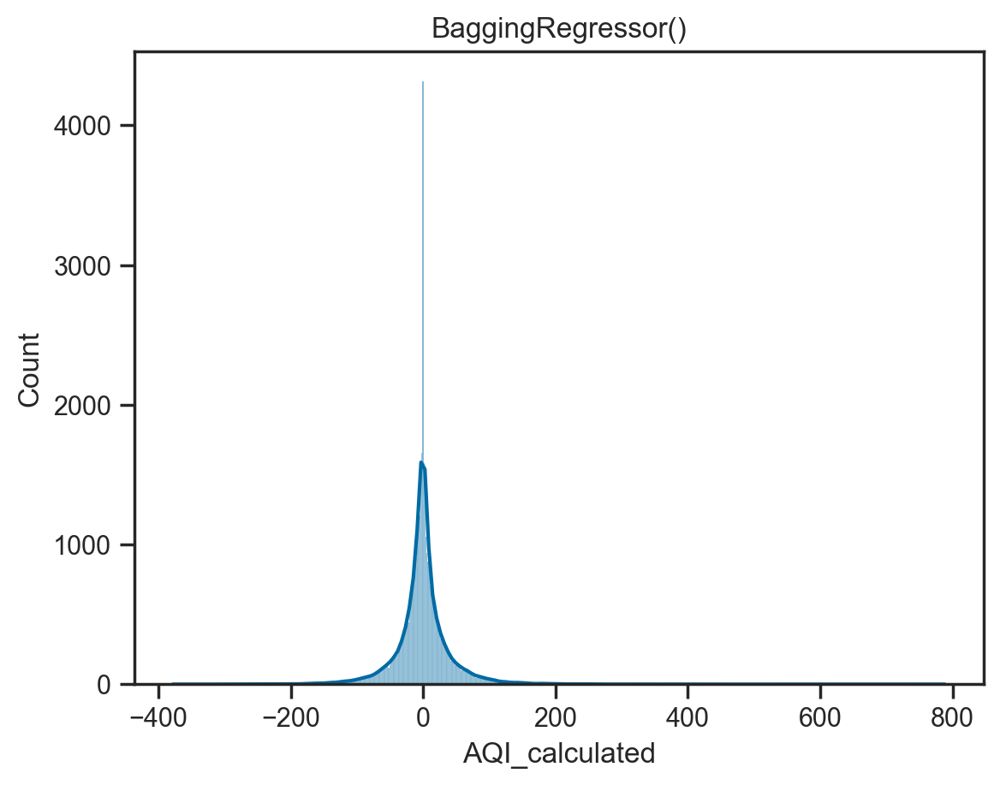

In [30]:
lr_date = LinearRegression()
d_tree_date = DecisionTreeRegressor()
rf_date = RandomForestRegressor()
ab_date = AdaBoostRegressor()
br_date = BaggingRegressor()

for i in [lr_date, d_tree_date, rf_date, ab_date, br_date]:
    #     helper(i)
    model = i
    print(i)
    model.fit(X_train_date, y_train_date)
    y_pred_date = model.predict(X_test_date)
    predicted_actual = pd.DataFrame({
        'y_pred_date': y_pred_date,
        "y_test_date": y_test_date
    })
    predicted_actual
    print(
        "\nCorrelation b/w actual and predicted",
        predicted_actual['y_pred_date'].corr(predicted_actual['y_test_date']))
    plt.figure()
    sns.histplot(y_test_date - y_pred_date, kde=True)
    plt.title(model)
    print("\nscore(X_test, y_test_date) ", model.score(X_test_date,
                                                       y_test_date))

    s = cross_val_score(estimator=model,
                        X=df[X_train_date.columns],
                        y=df['AQI_calculated'],
                        scoring='r2',
                        cv=5)
    print("\nCV scores", s)
    print("\nAverage cv score ", np.mean(s))
    print("\nmean_squared_log_error ",
          str(mean_squared_log_error(y_test_date, y_pred_date, squared=False)))
    print("\nmean_squared_error ",
          abs(mean_squared_error(y_test_date, y_pred_date)))
    print("\nr2_score ", r2_score(y_test_date, y_pred_date))
    print("\n\n")

In [31]:
# pickle.dump(rf_date, open('/Users/pranaii1729/Jupyter Notebooks/My-Jupyter-Notebooks/My-Jupyter-Notebooks/Omdena/gurugram-india-chapter-air-quality/model_rf_date.pkl','wb'))

model_rf_date = pickle.load(open('/Users/pranaii1729/Jupyter Notebooks/My-Jupyter-Notebooks/My-Jupyter-Notebooks/Omdena/gurugram-india-chapter-air-quality/model_rf_date.pkl', 'rb'))

model_rf_date

RandomForestRegressor()

In [32]:
parameters = {'max_features': ['sqrt'], 'n_estimators': [100, 1000]}

model = GridSearchCV(RandomForestRegressor(), parameters)
model.fit(X_train_date, y_train_date)
model.best_params_
model.best_score_




GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'max_features': ['sqrt'], 'n_estimators': [100, 1000]})

{'max_features': 'sqrt', 'n_estimators': 1000}

0.909162392358118

In [33]:
model = RandomForestRegressor(n_estimators=1000, max_features='sqrt')
model.fit(X_train_date, y_train_date)
model.score(X_test_date, y_test_date)
y_pred_date = model.predict(X_test_date)
predicted_actual = pd.DataFrame({
    'y_pred_date': y_pred_date,
    "y_test_date": y_test_date
})
predicted_actual
# sns.scatterplot()

RandomForestRegressor(max_features='sqrt', n_estimators=1000)

0.9172793016817538

,y_pred_date,y_test_date
136796,111.311,109.0
141862,77.000,77.0
90398,384.095,442.0
96697,162.335,167.0
55085,175.838,170.0
...,...,...
75840,263.382,278.0
25519,163.092,122.0
27287,135.000,135.0
17501,116.967,138.0


In [36]:
plt.figure(figsize=(100,30))
sns.scatterplot(predicted_actual, x='y_pred_date', y='y_test_date')

<Figure size 10000x3000 with 0 Axes>

<AxesSubplot: xlabel='y_pred_date', ylabel='y_test_date'>

## Normalization
#### While normalizing, should you also normalize target column?
     - Answer is Yes

In [19]:
from sklearn.preprocessing import MinMaxScaler
# df_normalized = MinMaxScaler().fit_transform(df.drop(['Datetime','AQI_Bucket','Station'],axis=1).copy())
# df_normalized = pd.DataFrame(df_normalized)
# df_normalized.columns = df.drop(['Datetime','AQI_Bucket','Station'],axis=1).columns 
# df_normalized

df_normalized = MinMaxScaler().fit_transform(df.drop(['Datetime'], axis = 1))
df_normalized = pd.DataFrame(df_normalized)
df_normalized.columns = df.drop(['Datetime'], axis = 1).columns 
df_normalized

,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,CO_8_avg,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
0,0.028881,0.081109,0.014481,0.053411,0.057637,0.074463,0.038523,0.068483,0.035722,0.038093,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,0.021160,0.078014,0.014801,0.052460,0.057194,0.073891,0.037269,0.066254,0.034707,0.037603,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2,0.021460,0.075219,0.014941,0.051210,0.056308,0.072746,0.034176,0.060755,0.035316,0.037467,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,0.031691,0.072897,0.014541,0.037307,0.044733,0.057791,0.033223,0.059061,0.032474,0.037277,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,0.025801,0.069388,0.015681,0.044784,0.051879,0.067024,0.032972,0.058615,0.031662,0.037250,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147402,0.083212,0.054191,0.047782,0.123975,0.140982,0.182139,0.207113,0.366417,0.017658,0.037222,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
147403,0.071951,0.055299,0.048482,0.132877,0.144767,0.187029,0.203401,0.359785,0.013396,0.032896,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
147404,0.075462,0.056805,0.049082,0.135952,0.129527,0.167340,0.204705,0.362115,0.005683,0.020516,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
147405,0.069061,0.058057,0.046162,0.136202,0.146418,0.189161,0.197030,0.350263,0.008727,0.016489,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0


In [20]:
df_normalized['AQI_calculated']

0         0.146697
1         0.135498
2         0.126540
3         0.117581
4         0.105263
            ...   
147402    0.082867
147403    0.085106
147404    0.080627
147405    0.086226
147406    0.085106
Name: AQI_calculated, Length: 147407, dtype: float64

### Training with all the columns

In [98]:
# Before training, standardize/normalize 

X_train, X_test, y_train, y_test = train_test_split(
    df_normalized,
                                                    df['AQI_calculated'],
                                                    train_size=0.8)

In [99]:
X_train
X_test
y_train
y_test

,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,CO_8_avg,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
124413,0.045511,0.048183,0.005100,0.006226,0.001933,0.002497,0.017606,0.031299,0.002233,0.003510,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
27221,0.071071,0.078081,0.023781,0.047159,0.027057,0.034956,0.005718,0.010165,0.025776,0.033468,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
75264,0.414398,0.205798,0.005680,0.022154,0.008033,0.010377,0.011386,0.020242,0.019079,0.017577,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
93315,0.057371,0.081533,0.000780,0.067739,0.029151,0.037661,0.009330,0.016586,0.008930,0.014611,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
21782,0.078552,0.053182,0.050762,0.051510,0.092626,0.119666,0.020532,0.036501,0.006292,0.008136,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48131,0.152553,0.072446,0.025201,0.046484,0.049786,0.064320,0.018008,0.032012,0.006901,0.003782,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
120872,0.033091,0.057307,0.000280,0.061212,0.022668,0.029286,0.015199,0.027019,0.000000,0.018666,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
134378,0.031391,0.039393,0.006920,0.024630,0.011153,0.014409,0.031049,0.055197,0.016237,0.013387,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
80518,0.040371,0.036356,0.005600,0.018379,0.005999,0.007751,0.014496,0.025770,0.008524,0.009687,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,CO_8_avg,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
100160,0.179914,0.140507,0.019861,0.049085,0.036700,0.047414,0.002759,0.004904,0.038360,0.035399,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
130774,0.056641,0.066505,0.023501,0.111122,0.065790,0.084996,0.063553,0.112980,0.013193,0.014775,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
42904,0.117342,0.102665,0.018861,0.054186,0.046021,0.059456,0.051916,0.092292,0.021717,0.026910,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
29685,0.300186,0.176889,0.037582,0.114398,0.049544,0.064007,0.046148,0.082037,0.033083,0.025958,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
79446,0.024280,0.029117,0.001340,0.022029,0.012401,0.016021,0.010935,0.019439,0.005480,0.006421,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33624,0.027861,0.030528,0.002280,0.004326,0.002899,0.003745,0.002257,0.004013,0.011975,0.012843,...,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
130953,0.052771,0.060849,0.005000,0.028181,0.015944,0.020599,0.055427,0.098534,0.000609,0.000354,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
2554,0.046381,0.049548,0.007360,0.040533,0.040082,0.051783,0.015299,0.027197,0.021311,0.023155,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
42343,0.033981,0.037357,0.009420,0.064938,0.036036,0.046556,0.031802,0.056534,0.021514,0.025958,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


124421     73.0
27223     135.0
75272     352.0
93323     146.0
21783      80.0
          ...  
48138     118.0
120880     87.0
134386     59.0
80526      55.0
93339     127.0
Name: AQI_calculated, Length: 117925, dtype: float64

100168    306.0
130782    100.0
42911     209.0
29687     332.0
79454      44.0
          ...  
33626      46.0
130961     92.0
2554       75.0
42350      56.0
135626    362.0
Name: AQI_calculated, Length: 29482, dtype: float64

LinearRegression()
score(X_test, y_test)  0.9904846449316694
CV scores [0.9907106  0.9912673  0.99140641 0.99113773 0.99018444]
Average cv score  0.9909412953987504
 mean_squared_log_error  0.08748491900475756
 mean_squared_error  154.78936120915645
r2_score  0.9904846449316694

DecisionTreeRegressor()
score(X_test, y_test)  0.9998643287793582
CV scores [0.99985013 0.9998877  0.99980349 0.99988721 0.99983387]
Average cv score  0.9998524773226976
 mean_squared_log_error  0.006669667647865477
 mean_squared_error  2.207007665694322
r2_score  0.9998643287793582

RandomForestRegressor()
score(X_test, y_test)  0.9998967101906713
CV scores [0.9998447  0.99989121 0.99989556 0.99990943 0.99990933]
Average cv score  0.9998900457433397
 mean_squared_log_error  0.0056543013792967655
 mean_squared_error  1.6802487653483478
r2_score  0.9998967101906713

AdaBoostRegressor()
score(X_test, y_test)  0.9771935404878154
CV scores [0.97618315 0.97704474 0.97820688 0.98055726 0.98053578]
Average cv score  0

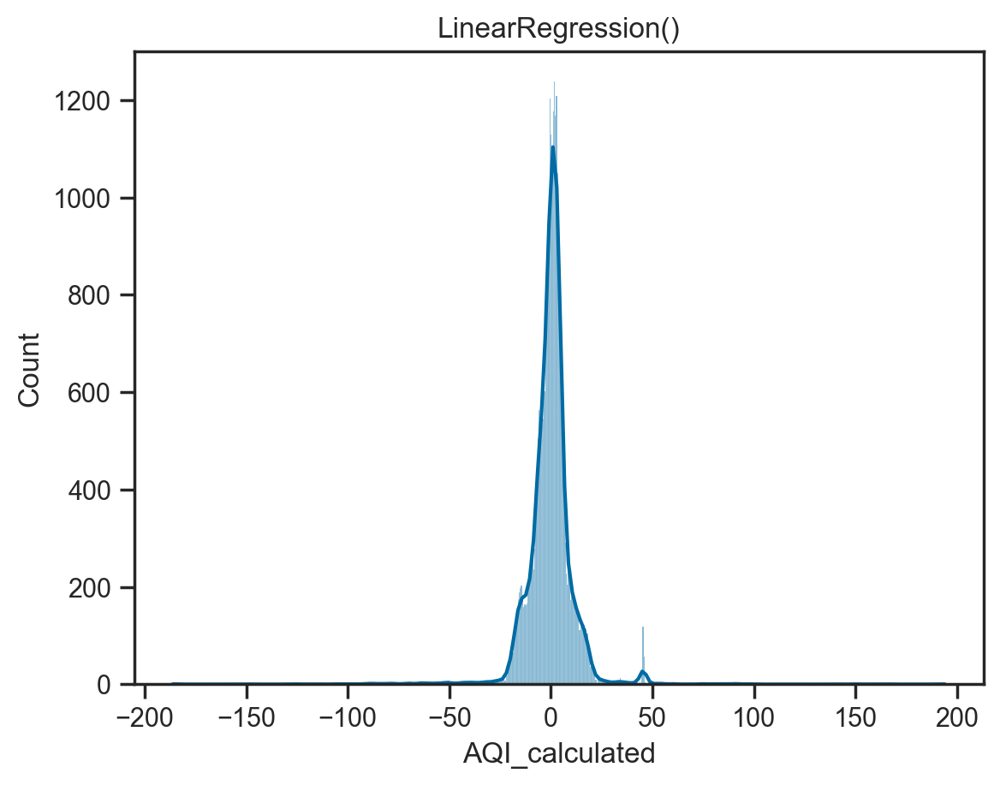

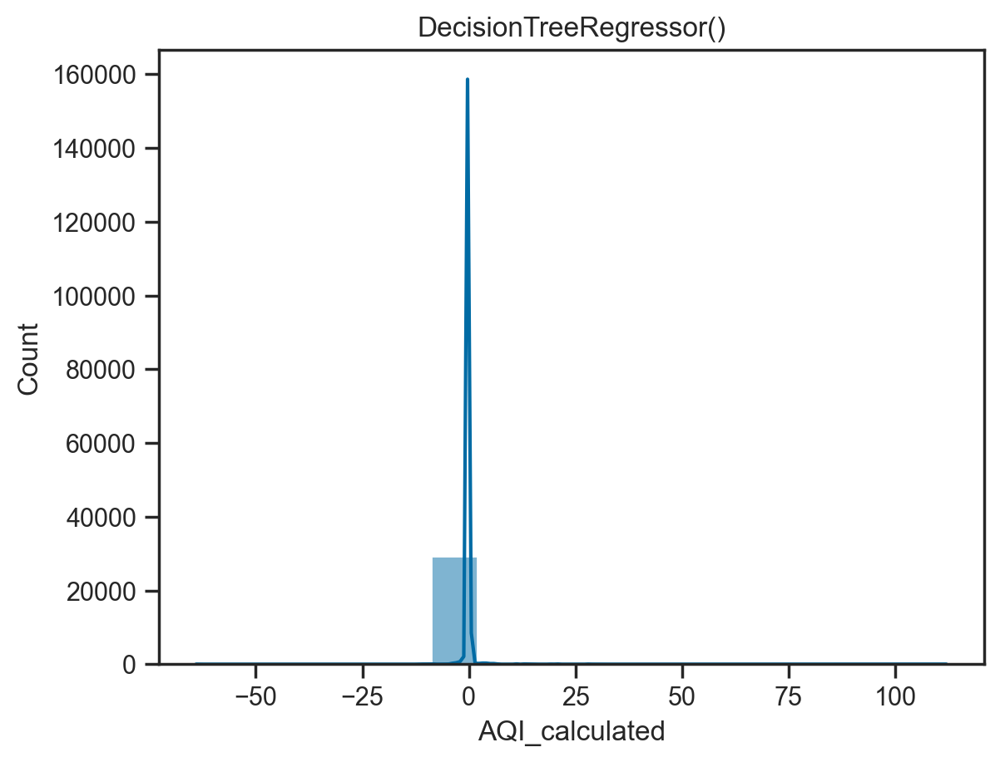

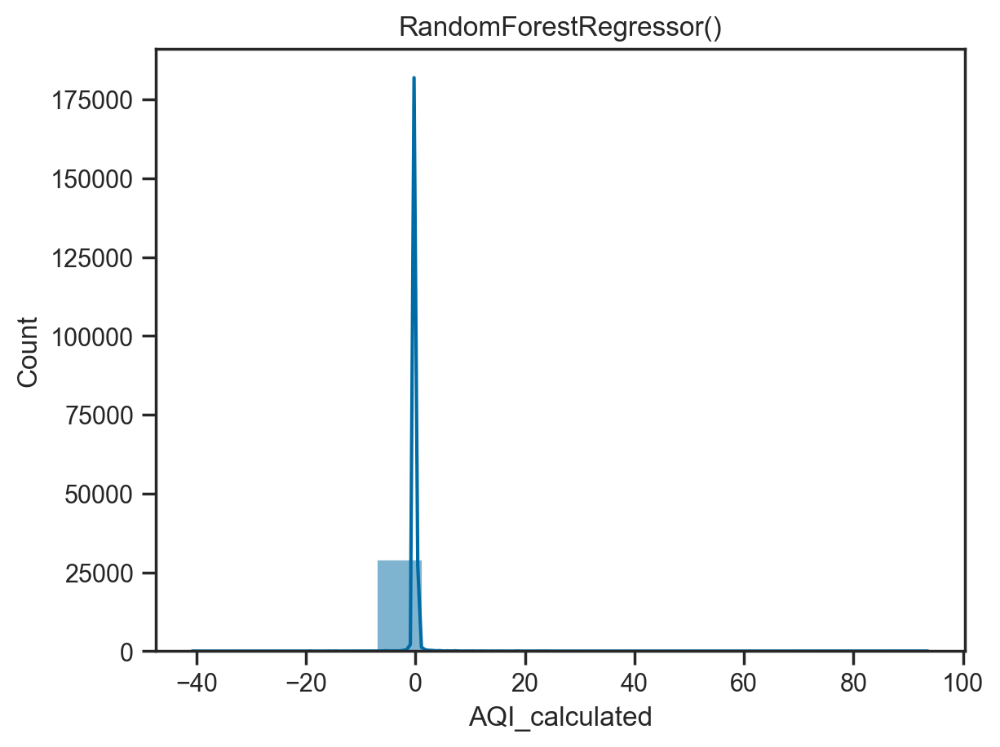

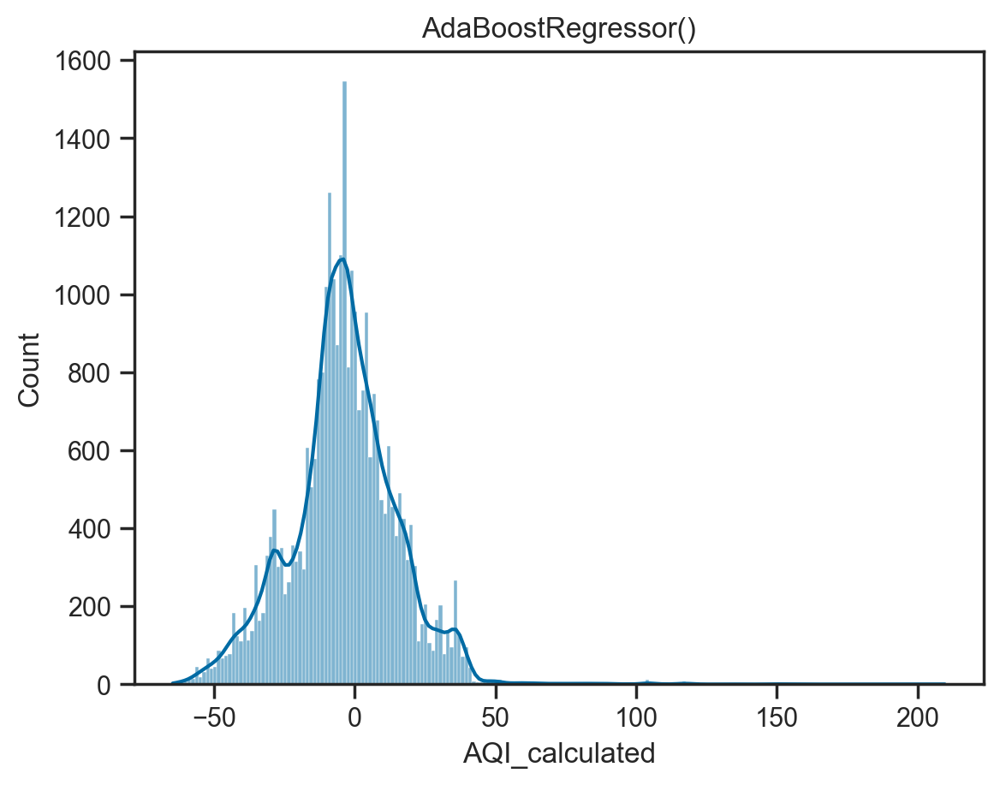

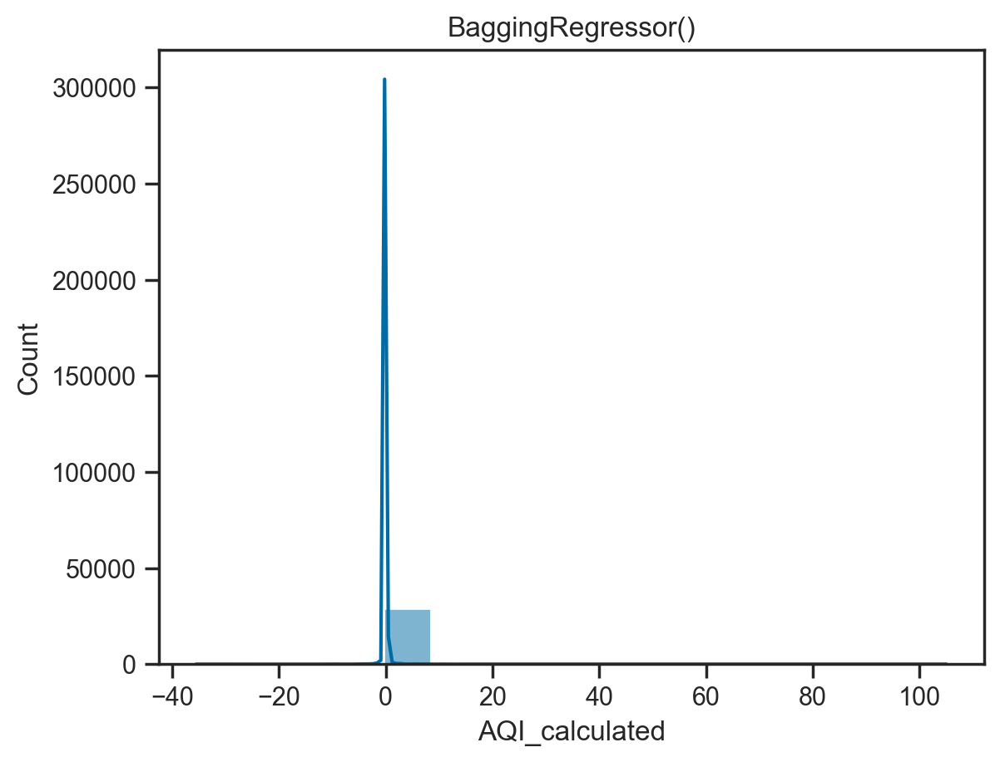

In [109]:
def helper(model):
    print(model)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    plt.figure()
    sns.histplot(y_test - y_pred, kde=True)
    plt.title(model)
    print("score(X_test, y_test) ", model.score(X_test, y_test))
    s = cross_val_score(estimator=model,
                        X=X_train,
                        y=y_train,
                        scoring='r2',
                        cv=5)
    print("CV scores",s)
    print("Average cv score ", np.mean(s))
    print(" mean_squared_log_error ",
          str(mean_squared_log_error(y_test, y_pred, squared=False)))
    print(" mean_squared_error ",
      abs(mean_squared_error(y_test, y_pred)))
    print("r2_score ",
      r2_score(y_test, y_pred))
    
    print()


lr = LinearRegression()
tree = DecisionTreeRegressor()
rf = RandomForestRegressor()
ab = AdaBoostRegressor()
br = BaggingRegressor()
for i in [lr, tree, rf, ab, br]:
    helper(i)

### How to use CV ?
- ### refer to - https://www.kaggle.com/code/jnikhilsai/cross-validation-with-linear-regression

In [95]:
# ValueError: Mean Squared Logarithmic Error cannot be used when targets contain negative values.
# Checking if AQI_calculated has negative 

# df_normalized['AQI_calculated'].plot.box()

KeyError: 'AQI_calculated'

LinearRegression()

<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'LinearRegression()')

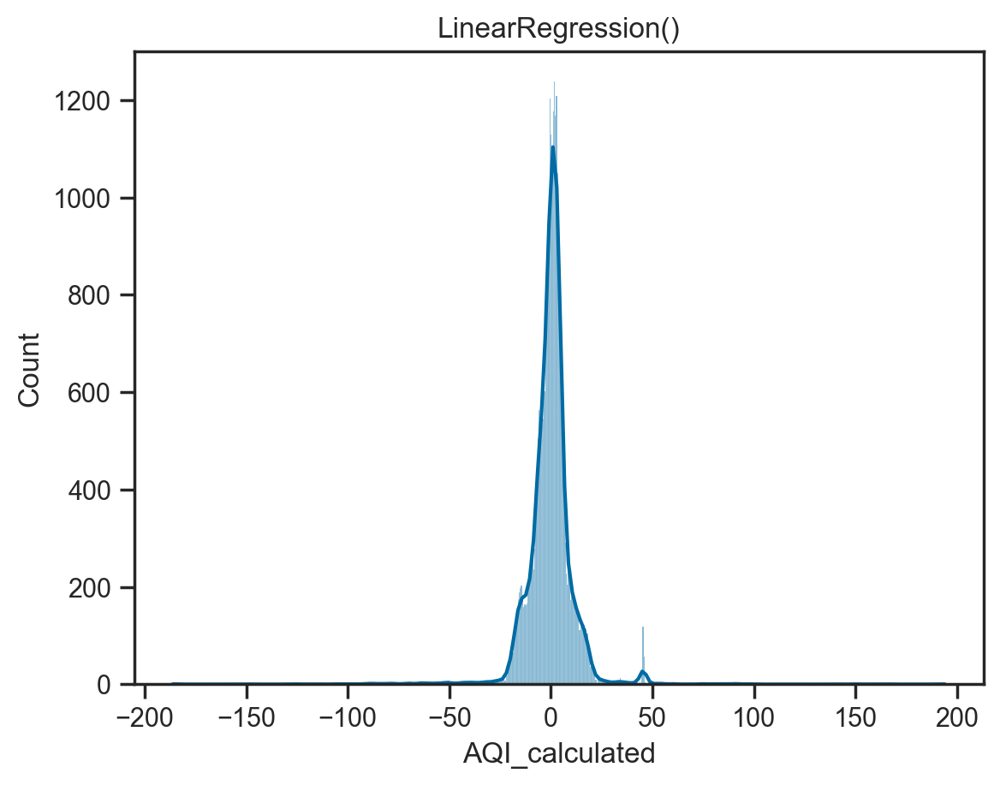

In [113]:
model = LinearRegression()
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
plt.figure()
sns.histplot(y_test - y_pred, kde=True)
plt.title(model)

RandomForestRegressor()

100168    0.00
130782    0.02
42911     0.00
29687     0.00
79454     0.00
          ... 
33626     0.00
130961    0.00
2554      0.00
42350    -0.25
135626    0.00
Name: AQI_calculated, Length: 29482, dtype: float64

<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'RandomForestRegressor()')

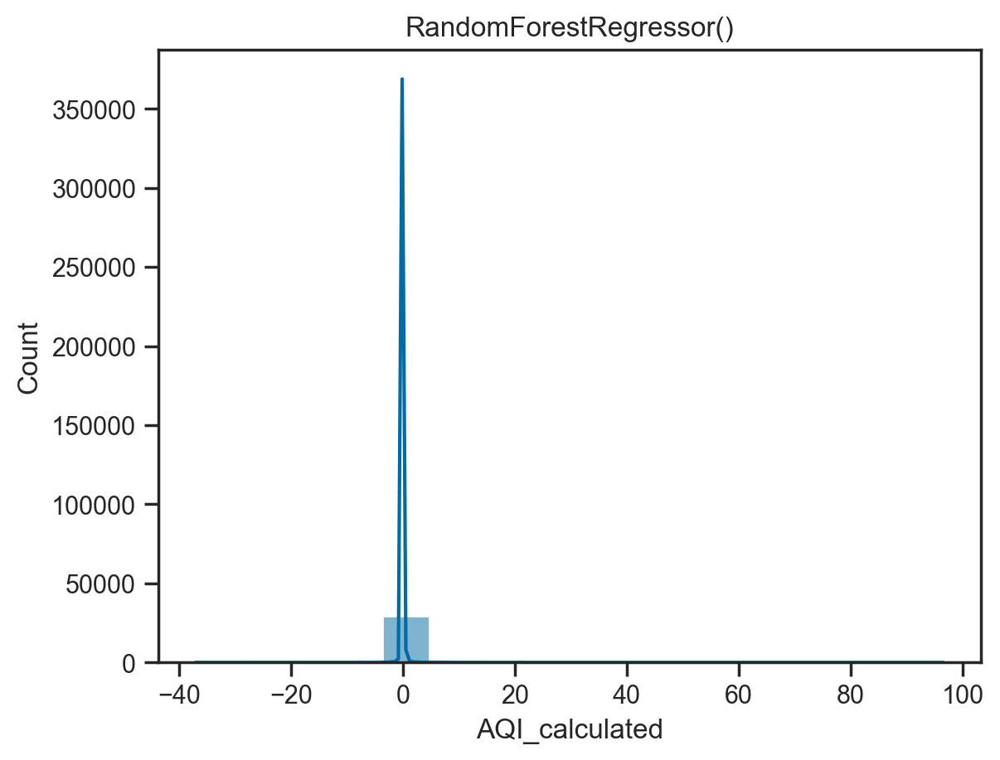

In [114]:
model = RandomForestRegressor()
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
y_test - y_pred
plt.figure()
sns.histplot(y_test - y_pred, kde=True)
plt.title(model)

### Training with few columns only

In [115]:
df_normalized.columns

Index(['PM2.5', 'PM2.5_24_avg', 'NO', 'NO2', 'NOx', 'NOx_SubIndex', 'SO2',
       'SO2_SubIndex', 'CO', 'CO_8_avg', 'Day', 'Month', 'Year', 'Week',
       'Hour', 'PM2.5_24_avg_Sub_Index', 'CO_8_avg_Sub_Index', 'NO2_Sub_Index',
       'Station_NISE', 'Station_No Station', 'Station_Sector 51',
       'Station_Teri Gram', 'Station_Vikas Sadan', 'AQI_Bucket_Good',
       'AQI_Bucket_Moderate', 'AQI_Bucket_Poor', 'AQI_Bucket_Satisfactory',
       'AQI_Bucket_Severe', 'AQI_Bucket_Very Poor'],
      dtype='object')

In [19]:
X_train, X_test, y_train, y_test = train_test_split(
    df_normalized.drop([
        'PM2.5_24_avg', 'NOx_SubIndex', 'SO2_SubIndex', 'CO_8_avg', 'PM2.5_24_avg_Sub_Index',
           'CO_8_avg_Sub_Index', 'NO2_Sub_Index', 'AQI_Bucket_Good', 'AQI_Bucket_Moderate',
       'AQI_Bucket_Poor', 'AQI_Bucket_Satisfactory', 'AQI_Bucket_Severe',
       'AQI_Bucket_Very Poor'
    ],
                       axis=1),
    df['AQI_calculated'],
    train_size=0.8)

In [20]:
X_train
X_test
y_train
y_test

,PM2.5,NO,NO2,NOx,SO2,CO,Day,Month,Year,Week,Hour,AQI_calculated,Station_NISE,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan
92479,0.070411,0.018561,0.090218,0.051638,0.021469,0.015222,0.933333,0.000000,1.000,0.057692,0.782609,0.362822,0.0,0.0,1.0,0.0,0.0
119786,0.113042,0.012120,0.035032,0.024540,0.041132,0.015628,0.600000,0.090909,1.000,0.115385,0.826087,0.357223,0.0,0.0,0.0,1.0,0.0
8484,0.125423,0.011700,0.041483,0.045216,0.011085,0.015019,0.666667,0.090909,0.750,0.115385,0.478261,0.316909,1.0,0.0,0.0,0.0,0.0
84931,0.058471,0.033601,0.067564,0.013871,0.018258,0.024559,0.666667,0.181818,0.875,0.211538,0.260870,0.312430,0.0,0.0,1.0,0.0,0.0
107599,0.051021,0.014901,0.016478,0.038170,0.008828,0.017049,0.966667,0.727273,0.750,0.730769,0.000000,0.050392,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
138429,0.070241,0.019481,0.089368,0.049826,0.025933,0.016846,0.533333,0.181818,0.875,0.192308,0.260870,0.175812,0.0,0.0,0.0,0.0,1.0
49664,0.080822,0.017821,0.049560,0.044108,0.008477,0.029430,0.233333,0.545455,0.375,0.500000,0.869565,0.170213,0.0,1.0,0.0,0.0,0.0
83605,0.358677,0.038942,0.057912,0.018501,0.011988,0.056221,0.800000,0.000000,0.875,0.057692,0.000000,0.294513,0.0,0.0,1.0,0.0,0.0
103907,0.133903,0.024761,0.020979,0.028829,0.012841,0.025167,0.933333,0.272727,0.750,0.307692,0.173913,0.255319,0.0,0.0,0.0,1.0,0.0


,PM2.5,NO,NO2,NOx,SO2,CO,Day,Month,Year,Week,Hour,AQI_calculated,Station_NISE,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan
59440,0.054631,0.015521,0.025880,0.035955,0.318770,0.011975,0.633333,0.636364,0.500,0.634615,0.217391,0.072788,0.0,1.0,0.0,0.0,0.0
64949,0.031701,0.011660,0.028081,0.018481,0.082715,0.008524,0.133333,0.272727,0.625,0.250000,0.782609,0.071669,0.0,1.0,0.0,0.0,0.0
10910,0.015080,0.012961,0.018254,0.027782,0.022823,0.006495,0.033333,0.454545,0.750,0.403846,0.565217,0.049272,1.0,0.0,0.0,0.0,0.0
74970,0.159343,0.040602,0.030731,0.039780,0.007474,0.007713,0.966667,0.000000,0.750,0.057692,0.217391,0.354983,0.0,0.0,1.0,0.0,0.0
30485,0.207814,0.004160,0.034032,0.014414,0.064657,0.029430,0.966667,0.272727,0.125,0.307692,0.521739,0.350504,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76591,0.044001,0.011040,0.025380,0.041854,0.013543,0.006698,0.200000,0.272727,0.750,0.250000,0.782609,0.361702,0.0,0.0,1.0,0.0,0.0
8113,0.124202,0.012180,0.042934,0.046846,0.021419,0.013599,0.166667,0.090909,0.750,0.076923,0.000000,0.104143,1.0,0.0,0.0,0.0,0.0
73652,0.159773,0.000500,0.013953,0.022346,0.007875,0.028212,0.166667,1.000000,0.625,0.923077,0.304348,0.335946,0.0,0.0,1.0,0.0,0.0
10554,0.018230,0.008280,0.014978,0.020434,0.026201,0.010757,0.566667,0.363636,0.750,0.365385,0.739130,0.032475,1.0,0.0,0.0,0.0,0.0


92487     338.0
119794    333.0
8484      297.0
84939     293.0
107607     59.0
          ...  
138438    171.0
49671     166.0
83613     277.0
103915    242.0
16464     315.0
Name: AQI_calculated, Length: 117925, dtype: float64

59448      79.0
64957      78.0
10910      58.0
74978     331.0
30487     327.0
          ...  
76599     337.0
8113      107.0
73660     314.0
10554      43.0
146283    248.0
Name: AQI_calculated, Length: 29482, dtype: float64

LinearRegression()
score(X_test, y_test)  0.5822219983422314
CV scores [0.57350103 0.59054628 0.57993068 0.57522101 0.56990434]
Average cv score  0.5778206676156249
 mean_squared_log_error  0.5170069404019422
 mean_squared_error  6730.921303954654
r2_score  0.5822219983422314

DecisionTreeRegressor()
score(X_test, y_test)  0.8274928733889962
CV scores [0.81228356 0.80998701 0.80885384 0.81426086 0.81564258]
Average cv score  0.8122055695551167
 mean_squared_log_error  0.2912598848200422
 mean_squared_error  2779.30357506275
r2_score  0.8274928733889962

RandomForestRegressor()
score(X_test, y_test)  0.9166979600379669
CV scores [0.90132669 0.90767394 0.90618663 0.9041116  0.90353762]
Average cv score  0.904567294407995
 mean_squared_log_error  0.21181326564457725
 mean_squared_error  1342.099089033987
r2_score  0.9166979600379669

AdaBoostRegressor()
score(X_test, y_test)  0.5711899332489399
CV scores [0.59783888 0.59355588 0.59141257 0.5881798  0.56313285]
Average cv score  0.58682399

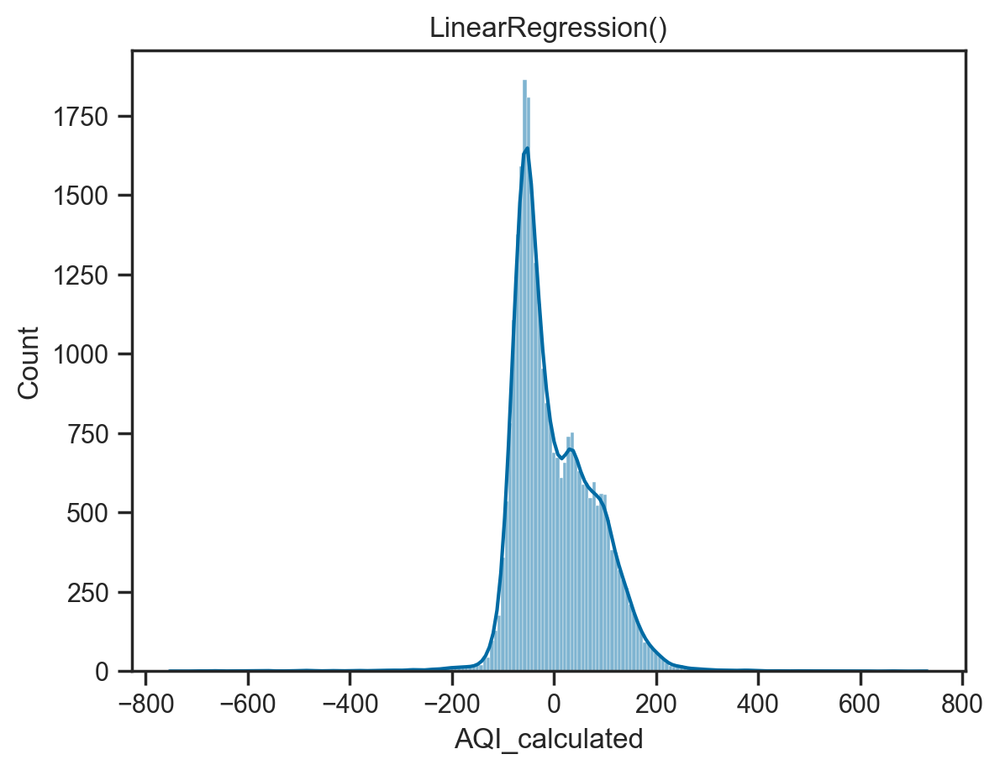

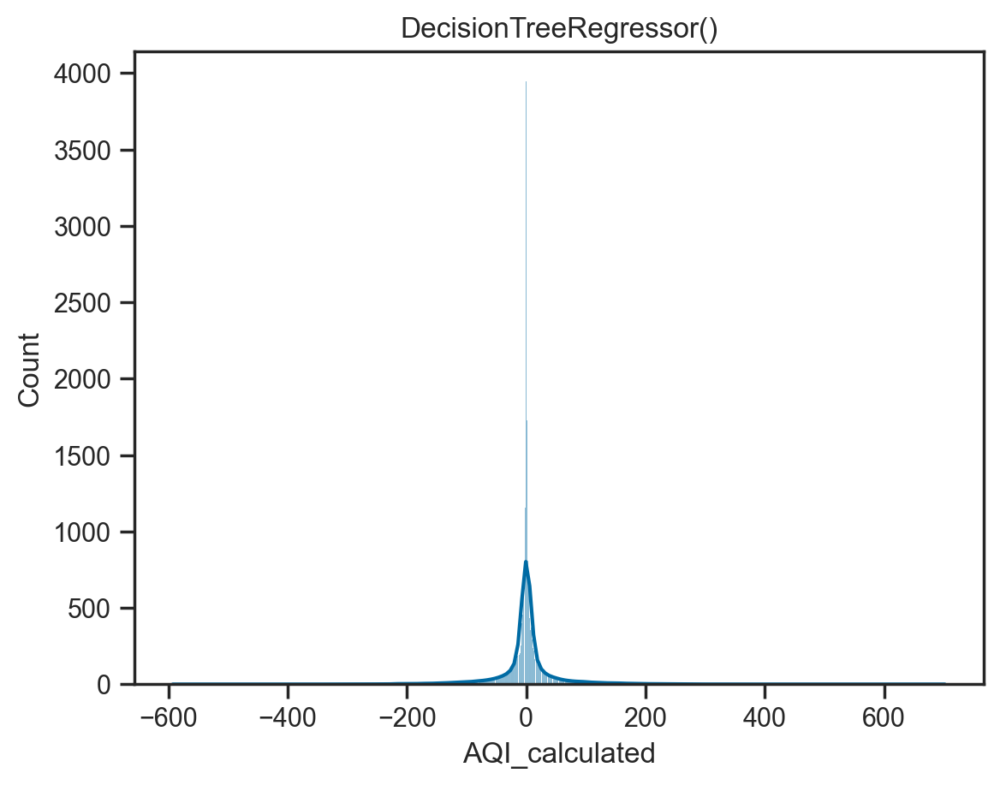

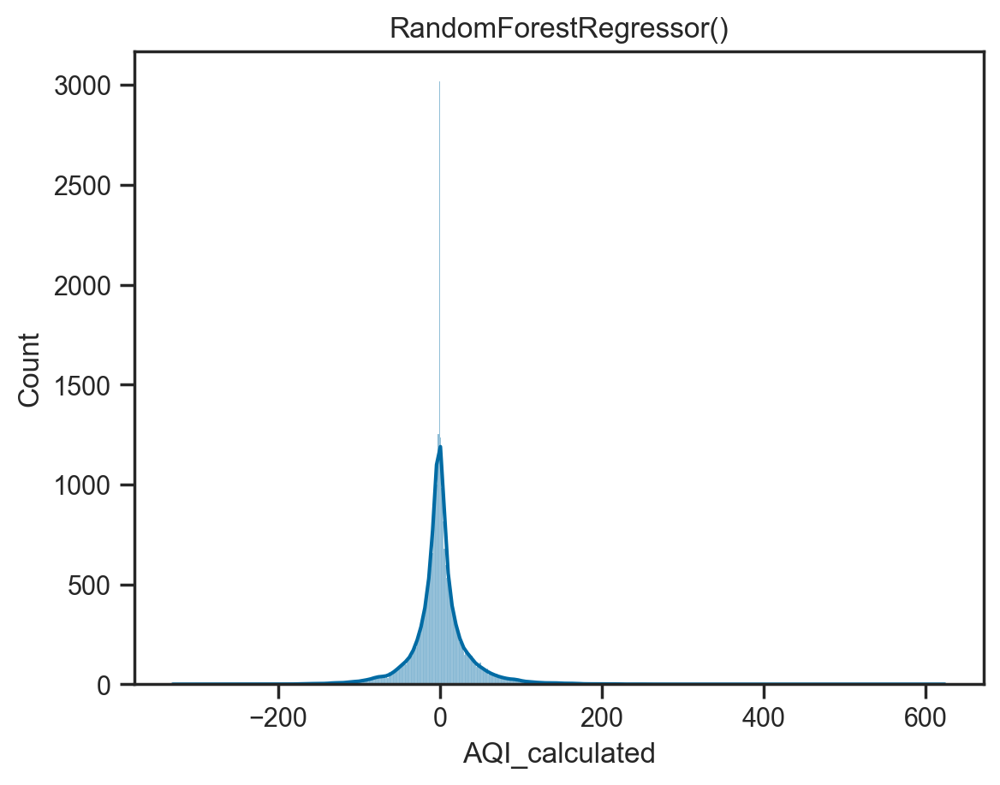

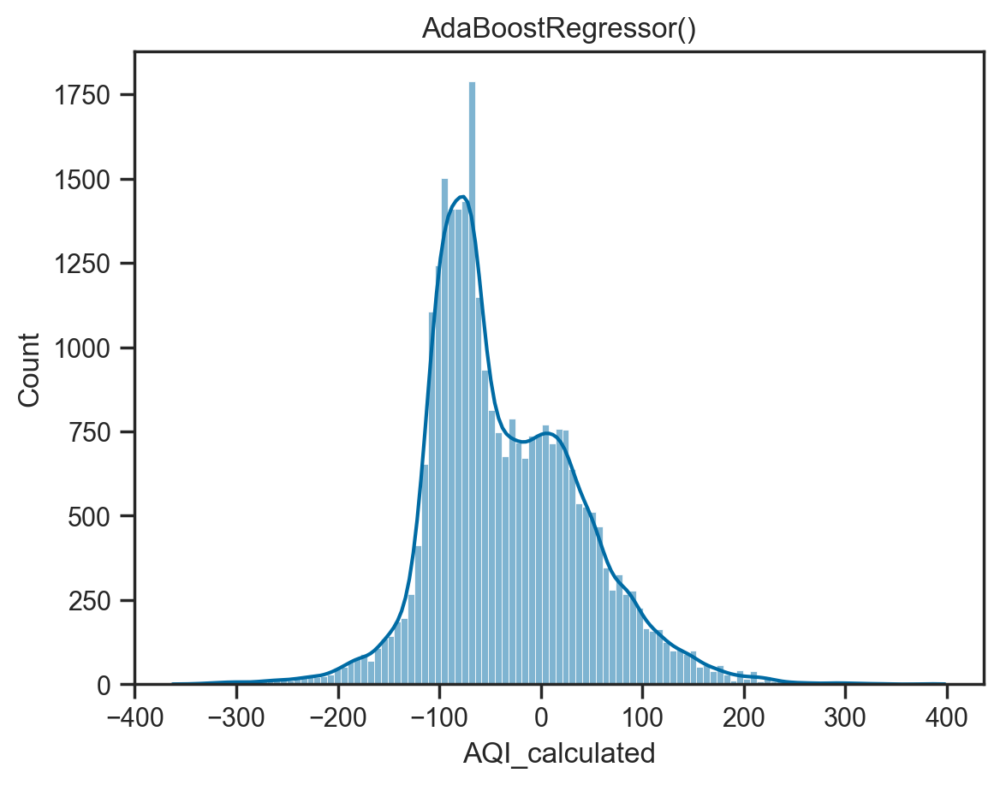

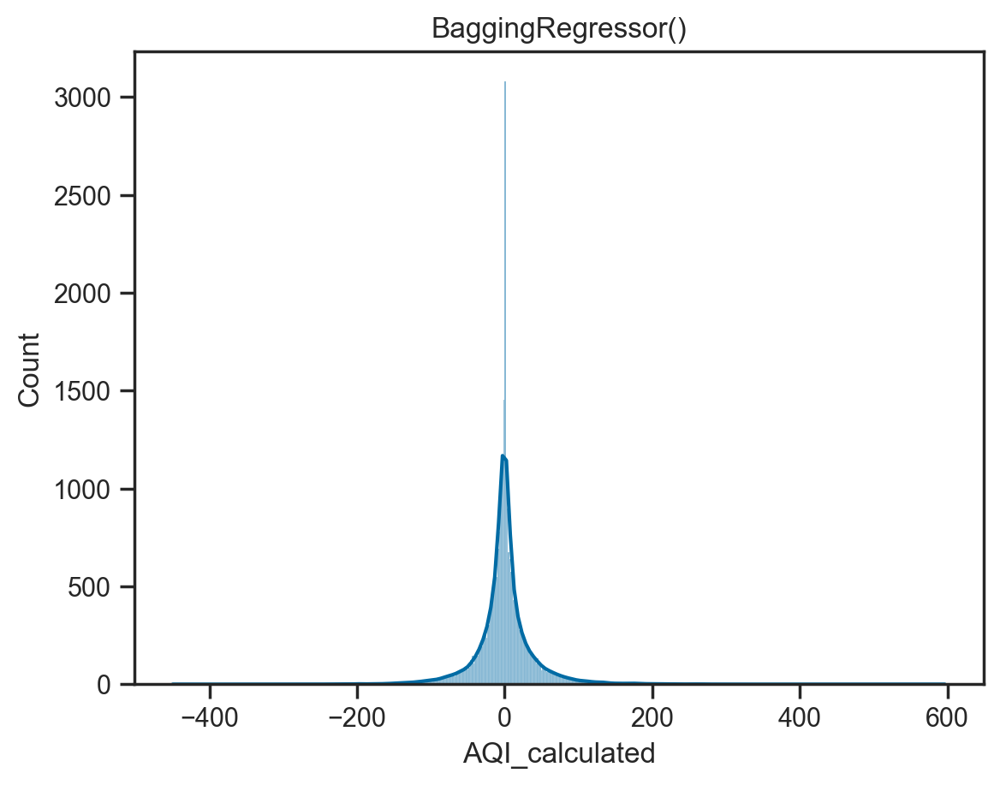

In [119]:

lr = LinearRegression()
tree = DecisionTreeRegressor()
rf = RandomForestRegressor()
ab = AdaBoostRegressor()
br = BaggingRegressor()
for i in [lr, tree, rf, ab, br]:
    helper(i)

# Assumptions (which columns to choose for training?)

- In web app, we get inputs like date, PM2.5, NO, NO2, NOx,  SO2, CO etc
- Initially, we calculated 24,8 hour averages, sub index for each pollutant and then calculated AQI
    - This is just for filling missing values in AQI

- Now, given a new test instance of (PM2.5, NO, NO2, NOx,  SO2, CO), we can do 2 things
    - Calculate sub index and then predict AQI (but why use ML for this, directly you can use a formula??)
    - In our model, only pollutants columns will be there along with datetime. This will predict AQI.
- Columns not to choose for sure,
    - Date, week, year, month. Because they are nowhere a good AQI predictors. You cannot assume AQI depends on these parameters. It would be a coincidence.
    - AQI Bucket columns also are not useful because we don't give it as an input from web app.
    - Station is optional. It can or can't be useful. So test with both.
    - 24-hour averages, 8-hour averages are not required because
        - Given a new single test instance, we can't calculate it's 24-hour average (as we need at least 24 data points) & 8-hour average. But, we have only 1 test instance.
        - They are correlated with pollutants (Multi-collinearity)
    - Remove multi-correlated features as this is dangerous in regression
- Our model should not be trained on averages & sub indices in predicting AQI (Only pollutants are used to predict)
- Questions to be answered,
    - How to use CV for regression? 
    - How to use Datetime as it is not int?
    - Evaluation metrics and reporting it.
    - Should you normalize/standardize target column as well?

### Training with required columns only

In [31]:
df_normalized.columns

Index(['PM2.5', 'PM2.5_24_avg', 'NO', 'NO2', 'NOx', 'NOx_SubIndex', 'SO2',
       'SO2_SubIndex', 'CO', 'CO_8_avg', 'Day', 'Month', 'Year', 'Week',
       'Hour', 'AQI_calculated', 'PM2.5_24_avg_Sub_Index',
       'CO_8_avg_Sub_Index', 'NO2_Sub_Index', 'Station_NISE',
       'Station_No Station', 'Station_Sector 51', 'Station_Teri Gram',
       'Station_Vikas Sadan', 'AQI_Bucket_Good', 'AQI_Bucket_Moderate',
       'AQI_Bucket_Poor', 'AQI_Bucket_Satisfactory', 'AQI_Bucket_Severe',
       'AQI_Bucket_Very Poor'],
      dtype='object')

In [21]:
X_train, X_test, y_train, y_test = train_test_split(df_normalized.drop([
    'PM2.5_24_avg', 'NOx_SubIndex', 'SO2_SubIndex', 'CO_8_avg', 'Day', 'Month',
    'Year', 'Week', 'Hour', 'PM2.5_24_avg_Sub_Index', 'Station_NISE',
    'Station_No Station', 'Station_Sector 51', 'Station_Teri Gram',
    'Station_Vikas Sadan', 'CO_8_avg_Sub_Index', 'NO2_Sub_Index',
    'AQI_Bucket_Good', 'AQI_Bucket_Moderate', 'AQI_Bucket_Poor',
    'AQI_Bucket_Satisfactory', 'AQI_Bucket_Severe', 'AQI_Bucket_Very Poor', 'AQI_calculated'
],
                                                                       axis=1),
                                                    df_normalized['AQI_calculated'],
                                                    train_size=0.7)

In [22]:
X_train
X_test
y_train
y_test

,PM2.5,NO,NO2,NOx,SO2,CO
18273,0.114172,0.009720,0.031981,0.035573,0.013226,0.015425
7431,0.131663,0.015341,0.061937,0.065368,0.013343,0.071443
22788,0.006790,0.016081,0.041558,0.049685,0.035413,0.028212
69793,0.038941,0.001760,0.020554,0.010086,0.027438,0.008727
102740,0.124652,0.013481,0.037508,0.026695,0.008477,0.018876
...,...,...,...,...,...,...
109603,0.179344,0.016621,0.069839,0.011737,0.015951,0.011366
82797,0.447619,0.026001,0.057061,0.005979,0.016954,0.067993
94808,0.056141,0.000660,0.002851,0.000000,0.092998,0.012381
64906,0.024500,0.010520,0.034382,0.020695,0.079605,0.009742


,PM2.5,NO,NO2,NOx,SO2,CO
18529,0.086122,0.013961,0.090868,0.087230,0.010718,0.012584
140005,0.076392,0.039122,0.041133,0.024017,0.024127,0.010351
84314,0.141763,0.045542,0.096444,0.026252,0.033708,0.014410
8591,0.091722,0.010680,0.038058,0.041431,0.028725,0.013802
144846,0.072791,0.057762,0.065788,0.106054,0.031150,0.002841
...,...,...,...,...,...,...
11836,0.031961,0.010520,0.030381,0.035089,0.019830,0.007510
95702,0.082532,0.021421,0.007502,0.020112,0.074589,0.019890
21565,0.039161,0.033421,0.050010,0.073944,0.018309,0.007713
29332,0.641163,0.076343,0.137803,0.073340,0.044894,0.034504


18273     0.174692
7431      0.181411
22788     0.059351
69793     0.086226
102740    0.335946
            ...   
109603    0.353863
82797     0.446809
94808     0.075028
64906     0.034714
107792    0.143337
Name: AQI_calculated, Length: 103184, dtype: float64

18529     0.087346
140005    0.090705
84314     0.286674
8591      0.181411
144846    0.249720
            ...   
11836     0.032475
95702     0.108623
21565     0.035834
29332     0.769317
105963    0.034714
Name: AQI_calculated, Length: 44223, dtype: float64

In [23]:
X_train.columns
y_train

Index(['PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO'], dtype='object')

18273     0.174692
7431      0.181411
22788     0.059351
69793     0.086226
102740    0.335946
            ...   
109603    0.353863
82797     0.446809
94808     0.075028
64906     0.034714
107792    0.143337
Name: AQI_calculated, Length: 103184, dtype: float64

LinearRegression()


LinearRegression()

,y_pred,y_test
18529,0.196459,0.087346
140005,0.168253,0.090705
84314,0.252336,0.286674
8591,0.183371,0.181411
144846,0.175549,0.249720
...,...,...
11836,0.118099,0.032475
95702,0.162568,0.108623
21565,0.134829,0.035834
29332,0.790074,0.769317



Correlation b/w actual and predicted 0.7509820205041644


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'LinearRegression()')


score(X_test, y_test)  0.5639680345649514

CV scores [0.58610507 0.41399557 0.55727591 0.55706576 0.55975128]

Average cv score  0.5348387146880524

mean_squared_log_error  0.0739664952147624

mean_squared_error  0.008744650411837043

r2_score  0.5639680345649514



DecisionTreeRegressor()


DecisionTreeRegressor()

,y_pred,y_test
18529,0.085106,0.087346
140005,0.092497,0.090705
84314,0.136618,0.286674
8591,0.127660,0.181411
144846,0.328108,0.249720
...,...,...
11836,0.035834,0.032475
95702,0.107503,0.108623
21565,0.038074,0.035834
29332,0.771377,0.769317



Correlation b/w actual and predicted 0.7779034991492693


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'DecisionTreeRegressor()')


score(X_test, y_test)  0.5530389695775997

CV scores [0.32622695 0.24744398 0.30682638 0.30487829 0.21918693]

Average cv score  0.28091250663882594

mean_squared_log_error  0.07630469991326565

mean_squared_error  0.008963833545686606

r2_score  0.5530389695775997



RandomForestRegressor()


RandomForestRegressor()

,y_pred,y_test
18529,0.097996,0.087346
140005,0.092487,0.090705
84314,0.309686,0.286674
8591,0.205084,0.181411
144846,0.203281,0.249720
...,...,...
11836,0.062710,0.032475
95702,0.126290,0.108623
21565,0.068925,0.035834
29332,0.771434,0.769317



Correlation b/w actual and predicted 0.8846092235820289


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'RandomForestRegressor()')


score(X_test, y_test)  0.7823590892801651

CV scores [0.66089723 0.53669078 0.65023858 0.64749656 0.63500496]

Average cv score  0.6260656228595181

mean_squared_log_error  0.05340546615627764

mean_squared_error  0.004364803111762442

r2_score  0.7823590892801651



AdaBoostRegressor()


AdaBoostRegressor()

,y_pred,y_test
18529,0.273233,0.087346
140005,0.251712,0.090705
84314,0.307061,0.286674
8591,0.258537,0.181411
144846,0.252753,0.249720
...,...,...
11836,0.157843,0.032475
95702,0.251712,0.108623
21565,0.251712,0.035834
29332,0.516513,0.769317



Correlation b/w actual and predicted 0.731906955474207


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'AdaBoostRegressor()')


score(X_test, y_test)  0.12652933384873055

CV scores [ 0.33553533  0.52203306  0.40368697  0.22463245 -0.17424265]

Average cv score  0.2623290339460771

mean_squared_log_error  0.11113378028494303

mean_squared_error  0.017517512994411556

r2_score  0.12652933384873055



BaggingRegressor()


BaggingRegressor()

,y_pred,y_test
18529,0.123628,0.087346
140005,0.092350,0.090705
84314,0.309295,0.286674
8591,0.189586,0.181411
144846,0.176036,0.249720
...,...,...
11836,0.035498,0.032475
95702,0.112206,0.108623
21565,0.079619,0.035834
29332,0.771158,0.769317



Correlation b/w actual and predicted 0.8723745591999079


<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'BaggingRegressor()')


score(X_test, y_test)  0.7608453950925225

CV scores [0.62087777 0.51065876 0.61714892 0.61104682 0.59973181]

Average cv score  0.5918928157703514

mean_squared_log_error  0.05604612154385851

mean_squared_error  0.0047962616965714685

r2_score  0.7608453950925225





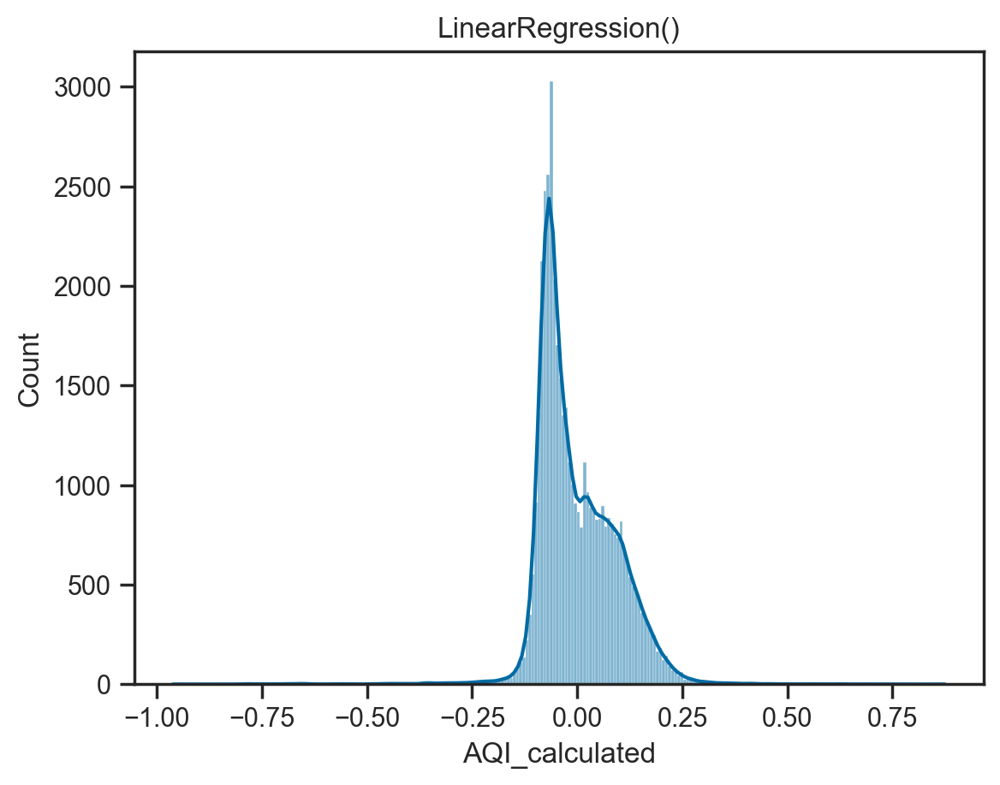

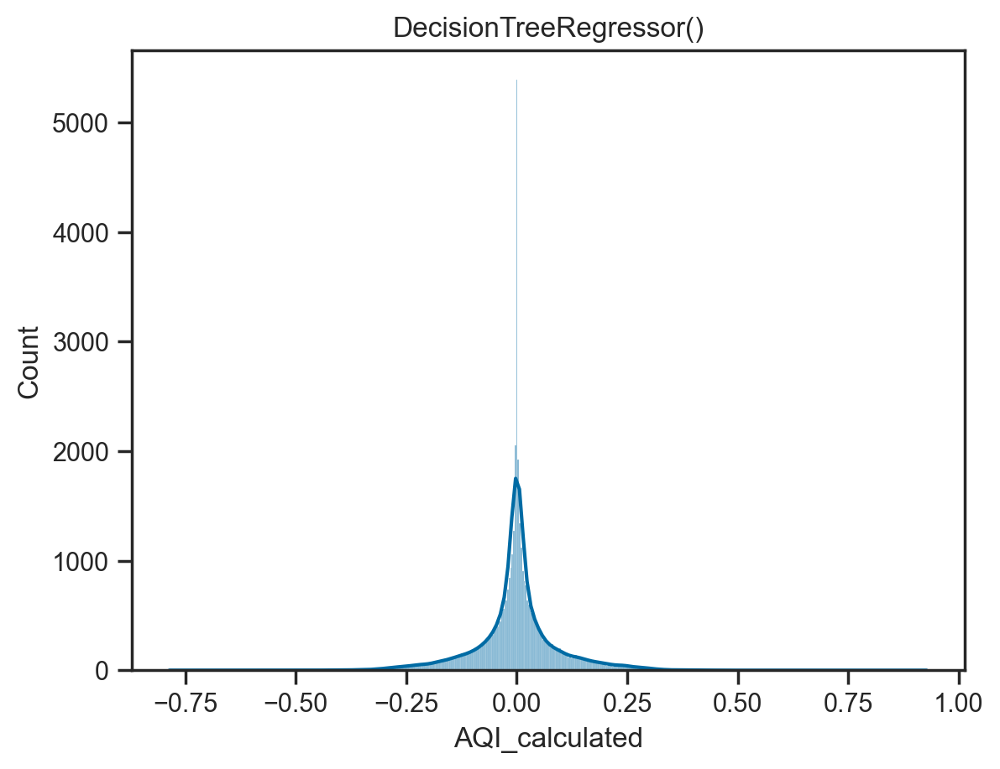

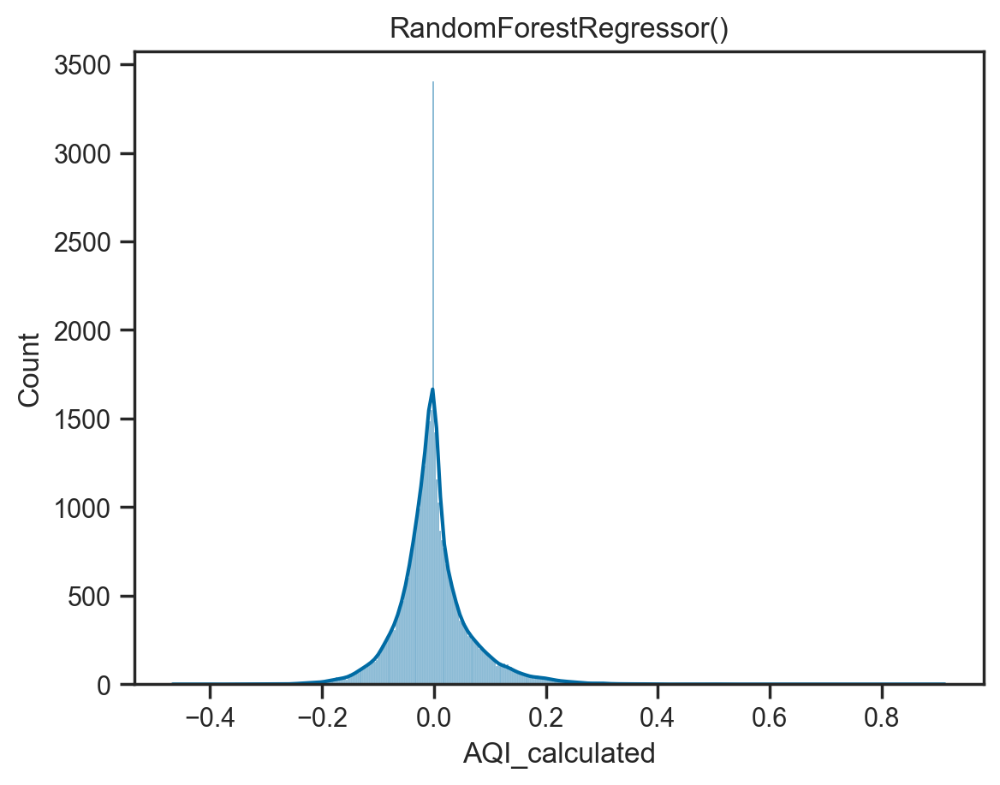

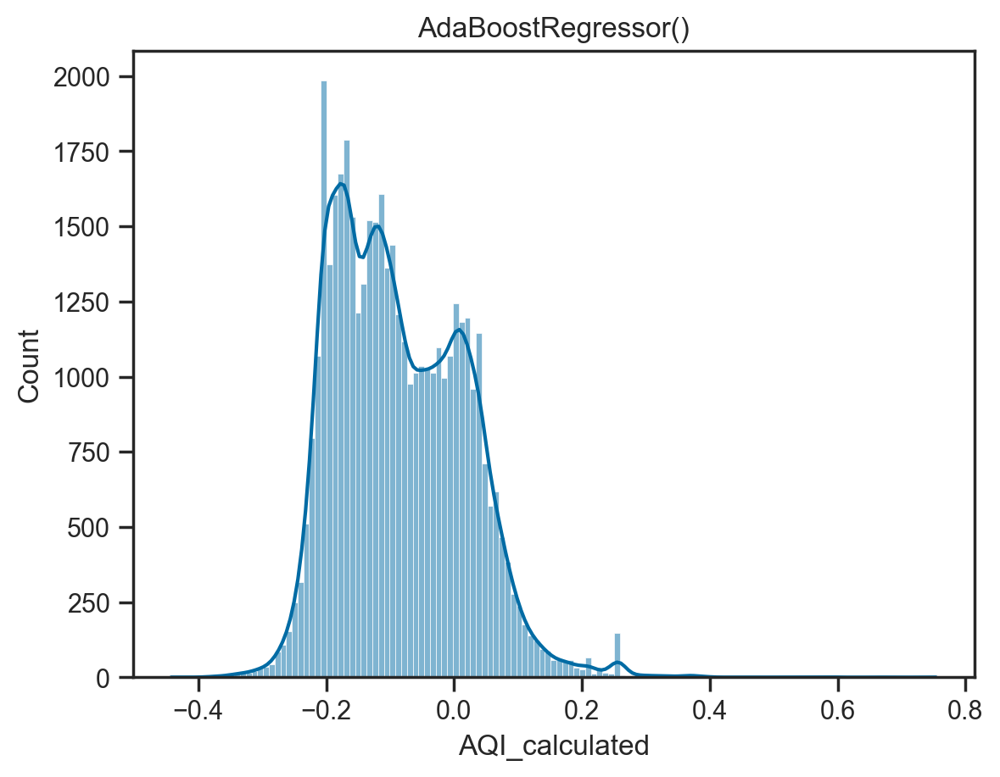

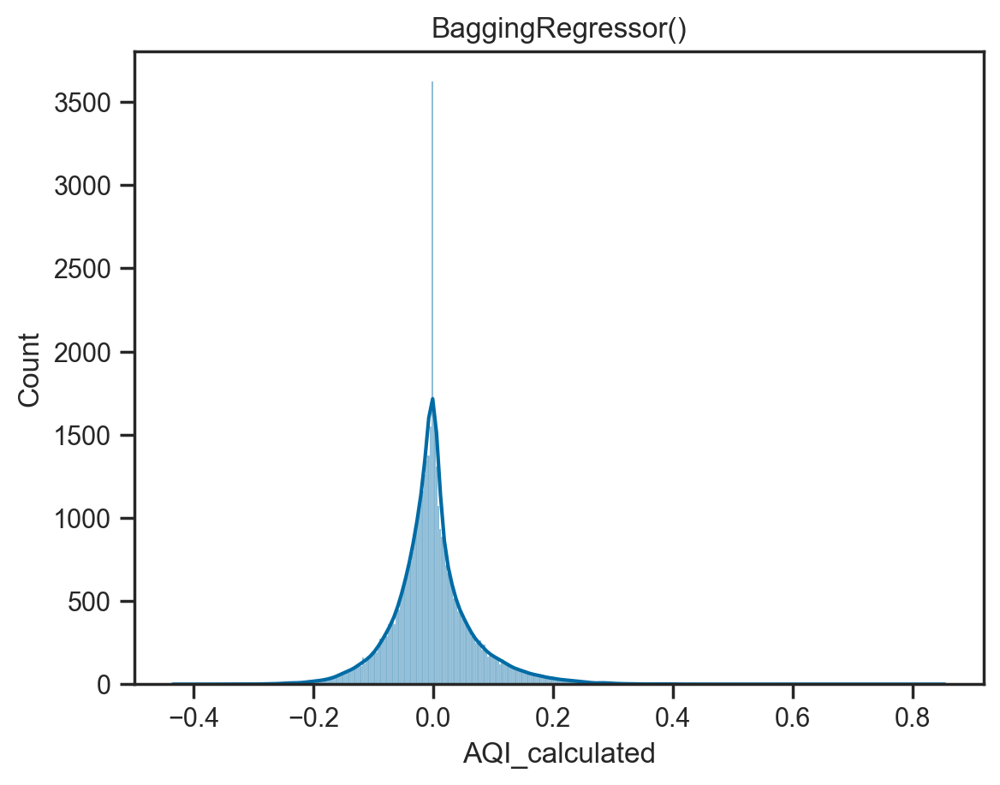

In [24]:
lr = LinearRegression()
tree = DecisionTreeRegressor()
rf_norm = RandomForestRegressor()
ab = AdaBoostRegressor()
br = BaggingRegressor()

for i in [lr, tree, rf_norm, ab, br]:
#     helper(i)
    model = i
    print(i)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    predicted_actual = pd.DataFrame({ 'y_pred' : y_pred, "y_test" : y_test })
    predicted_actual
    print("\nCorrelation b/w actual and predicted", predicted_actual['y_pred'].corr(predicted_actual['y_test']))
    plt.figure()
    sns.histplot(y_test - y_pred, kde=True)
    plt.title(model)
    print("\nscore(X_test, y_test) ", model.score(X_test, y_test))
    
    
    s = cross_val_score(estimator=model, X=df_normalized[['PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO']], y=df_normalized['AQI_calculated'], scoring='r2', cv=5)
    print("\nCV scores", s)
    print("\nAverage cv score ", np.mean(s))
    
    
    print("\nmean_squared_log_error ",
          str(mean_squared_log_error(y_test, y_pred, squared=False)))
    print("\nmean_squared_error ", abs(mean_squared_error(y_test, y_pred)))
    print("\nr2_score ", r2_score(y_test, y_pred))
    print("\n\n")

In [26]:
import pickle
pickle.dump(rf_norm, open('/Users/pranaii1729/Jupyter Notebooks/My-Jupyter-Notebooks/My-Jupyter-Notebooks/Omdena/gurugram-india-chapter-air-quality/model_rf_norm.pkl','wb'))

model_rf_norm = pickle.load(open('/Users/pranaii1729/Jupyter Notebooks/My-Jupyter-Notebooks/My-Jupyter-Notebooks/Omdena/gurugram-india-chapter-air-quality/model_rf_norm.pkl', 'rb'))
model_rf_norm

RandomForestRegressor()

In [27]:
X_train.columns
# y_train.columns

Index(['PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO'], dtype='object')

In [28]:
X_train[:2]

,PM2.5,NO,NO2,NOx,SO2,CO
18273,0.114172,0.009720,0.031981,0.035573,0.013226,0.015425
7431,0.131663,0.015341,0.061937,0.065368,0.013343,0.071443


In [33]:
rf.predict([[ 34, 121, 121, 8, 0, 0]])

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


array([0.60580067])

In [34]:
import graphviz

dot_data = export_graphviz(tree, out_file=None, 
                                feature_names=X_train.columns,  
                                filled=True)

# Draw graph
# graph = graphviz.Source(dot_data, format="png") 
# graph

KeyboardInterrupt: 

In [28]:
# tree.plot_tree()
from sklearn.tree import plot_tree, export_graphviz
# plot_tree(tree)

# fig = plt.figure(figsize=(25,20))
# _ = plot_tree(tree, 
#                    feature_names=df.columns,  
#                    class_names=iris.target_names,
#                    filled=True)

## To do- 
- ### Compare average CV score vs train-test split score. They should be similar. 
- ### Visualize random forests & decision trees

In [142]:
tree.feature_importances_
tree.feature_names_in_

array([0.71893158, 0.05273711, 0.05832459, 0.07331525, 0.0488857 ,
       0.04780576])

array(['PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO'], dtype=object)

<Figure size 1200x400 with 0 Axes>

Text(0.5, 1.0, 'Feature importance - Random Forest - Accuracy 78%')

Text(0, 3, '0.72')

Text(0, 3, '0.05')

Text(0, 3, '0.06')

Text(0, 3, '0.07')

Text(0, 3, '0.05')

Text(0, 3, '0.05')

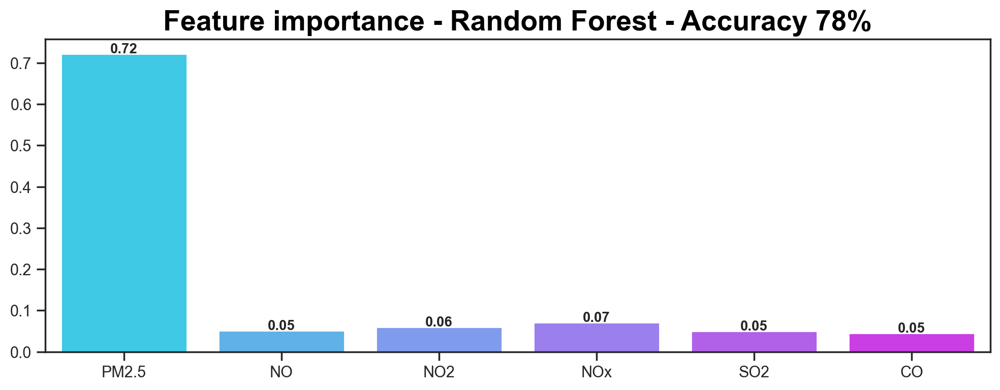

In [36]:
plt.figure(figsize=(12,4))
ax = sns.barplot(y = rf.feature_importances_, x = rf.feature_names_in_, palette='cool')

plt.title('Feature importance - Random Forest - Accuracy 78%',
          fontdict={
              'fontsize': 20,
              'color': 'black',
              'fontweight': 'bold'
          })

for p in ax.patches:
    ax.annotate(
        format(p.get_height(), '.2f') ,
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center',
                va='center',
                fontsize=10,
                fontweight='bold',
                xytext=(0, 3),
                textcoords='offset points')

## Hyperparameter tuning, CV, Grid search/Random search, Overfit curve

RandomForestRegressor()


RandomForestRegressor()

<Figure size 640x480 with 0 Axes>

<AxesSubplot: xlabel='AQI_calculated', ylabel='Count'>

Text(0.5, 1.0, 'RandomForestRegressor()')

score(X_test, y_test)  0.781571375870804
CV scores [0.68998631 0.64477106 0.55371161 0.57063157 0.67342874 0.59015021
 0.6397667  0.6257675  0.62729305 0.69633753]
Average cv score  0.6311844286565264
 mean_squared_log_error  0.05355632900094157
 mean_squared_error  0.004418942457289798
r2_score  0.781571375870804



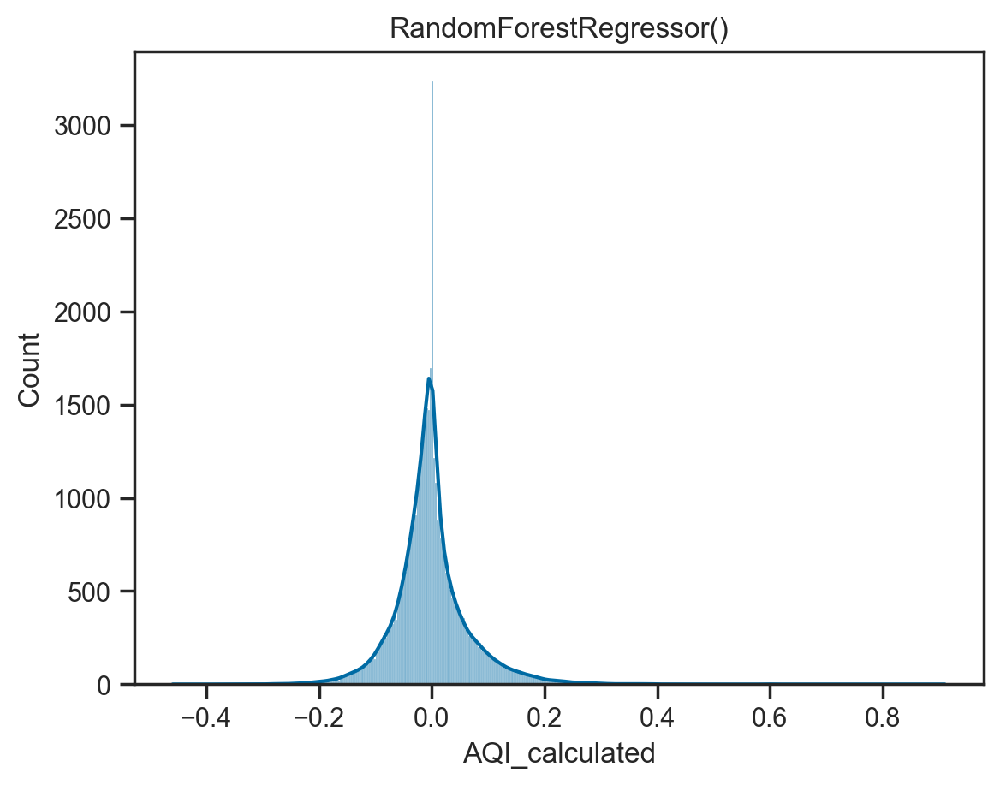

In [206]:
rf = RandomForestRegressor()

for i in [rf]:
    model = i
    print(i)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    plt.figure()
    sns.histplot(y_test - y_pred, kde=True)
    plt.title(model)
    print("score(X_test, y_test) ", model.score(X_test, y_test))

    # Cross Validation

    s = cross_val_score(
        estimator=model,
        X=df_normalized[['PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO']],
        y=df_normalized['AQI_calculated'],
        scoring='r2',
        cv=10)

    #         s = cross_val_score(estimator=model,
    #                         X=X_train,
    #                         y=y_train,
    #                         scoring='r2',
    #                         cv=5)

    print("CV scores", s)
    print("Average cv score ", np.mean(s))
    print(" mean_squared_log_error ",
          str(mean_squared_log_error(y_test, y_pred, squared=False)))
    print(" mean_squared_error ", abs(mean_squared_error(y_test, y_pred)))
    print("r2_score ", r2_score(y_test, y_pred))
    print()

In [22]:
from sklearn.model_selection import GridSearchCV

parameters = {'n_estimators':(1, 5, 10, 20, 40, 50, 75, 100, 200, 300, 500, 1000), 'max_depth':[1, 2, 3, 4, 5]}
clf_rf = GridSearchCV(RandomForestRegressor(), parameters)
# clf_rf.fit(X_train, y_train)
# clf_rf.best_params_
# clf_rf.best_score_

# Result is

# {'max_depth': 5, 'n_estimators': 1000}
# 0.7055529881696524




# rf = RandomForestRegressor()

# for i in [rf]:
#     model = i
#     print(i)
#     model.fit(X_train, y_train)
#     y_pred = model.predict(X_test)
#     plt.figure()
#     sns.histplot(y_test - y_pred, kde=True)
#     plt.title(model)
#     print("score(X_test, y_test) ", model.score(X_test, y_test))

#     # Cross Validation

#     s = cross_val_score(
#         estimator=model,
#         X=df_normalized[['PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO']],
#         y=df_normalized['AQI_calculated'],
#         scoring='r2',
#         cv=10)

#     print("CV scores", s)
#     print("Average cv score ", np.mean(s))
#     print(" mean_squared_log_error ",
#           str(mean_squared_log_error(y_test, y_pred, squared=False)))
#     print(" mean_squared_error ", abs(mean_squared_error(y_test, y_pred)))
#     print("r2_score ", r2_score(y_test, y_pred))
#     print()

#### n_estimators = 2000

In [40]:
parameters = {'n_estimators':([2000])}
clf_rf = GridSearchCV(RandomForestRegressor(), parameters)
clf_rf.fit(X_train, y_train)
clf_rf.best_params_
clf_rf.best_score_

GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'n_estimators': [2000]})

{'n_estimators': 2000}

0.7811639850894837

#### max_depth tuning

In [41]:
parameters = {'max_depth':[None, 1, 3, 5, 10 ]}

clf_rf = GridSearchCV(RandomForestRegressor(), parameters)
clf_rf.fit(X_train, y_train)
clf_rf.best_params_
clf_rf.best_score_

GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'max_depth': [None, 1, 3, 5, 10]})

{'max_depth': None}

0.7785790338439513

#### n_estimators with max_depth

In [42]:
parameters = {'n_estimators':(50, 100, 200, 400, 500), 'max_depth':[None, 1, 3, 5, 10 ]} 

clf_rf = GridSearchCV(RandomForestRegressor(), parameters)
clf_rf.fit(X_train, y_train)
clf_rf.best_params_
clf_rf.best_score_

GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'max_depth': [None, 1, 3, 5, 10],
                         'n_estimators': (50, 100, 200, 400, 500)})

{'max_depth': None, 'n_estimators': 500}

0.7808046217930454

#### n_estimators, max_depth, max_features, 

In [43]:
parameters = {'n_estimators':(50, 100, 500), 'max_depth':[None, 1, 3],
             'max_features': ['auto', 'sqrt', 'log2']
             } 

clf_rf = GridSearchCV(RandomForestRegressor(), parameters)
clf_rf.fit(X_train, y_train)
clf_rf.best_params_
clf_rf.best_score_

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviou

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviou

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:416: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0` or remove this parameter as it is also the default value for RandomForestRegressors and ExtraTreesRegressors.
  warn(


GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'max_depth': [None, 1, 3],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': (50, 100, 500)})

{'max_depth': None, 'max_features': 'log2', 'n_estimators': 500}

0.7958966303682248

In [44]:
parameters = {'n_estimators':([1000]),
             'max_features': [0.1, 0.3, 0.5, 1, 'sqrt', 'log2']
             } 

clf_rf = GridSearchCV(RandomForestRegressor(), parameters)
clf_rf.fit(X_train, y_train)
clf_rf.best_params_
clf_rf.best_score_

GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'max_features': [0.1, 0.3, 0.5, 1, 'sqrt', 'log2'],
                         'n_estimators': [1000]})

{'max_features': 'sqrt', 'n_estimators': 1000}

0.7960219189126747

In [45]:
parameters = {'n_estimators':([100, 500]),
             'max_features': [0.1, 0.3, 0.5, 1, 'sqrt', 'log2']
             } 

clf_rf = GridSearchCV(RandomForestRegressor(), parameters)
clf_rf.fit(X_train, y_train)
clf_rf.best_params_
clf_rf.best_score_

GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'max_features': [0.1, 0.3, 0.5, 1, 'sqrt', 'log2'],
                         'n_estimators': [100, 500]})

{'max_features': 'sqrt', 'n_estimators': 500}

0.7959221132005387

#### n_estimators = 100 (default)

In [39]:
parameters = {'n_estimators':([100])}
clf_rf = GridSearchCV(RandomForestRegressor(), parameters)
clf_rf.fit(X_train, y_train)
clf_rf.best_params_
clf_rf.best_score_

GridSearchCV(estimator=RandomForestRegressor(),
             param_grid={'n_estimators': [100]})

{'n_estimators': 100}

0.7789931916399234

In [37]:
model = RandomForestRegressor()
model.fit(X_train, y_train)
model.score(X_test, y_test)

RandomForestRegressor()

0.7797793508974145

#### n_estimators = 1000

In [38]:
model = RandomForestRegressor(n_estimators=1000)
model.fit(X_train, y_train)
model.score(X_test, y_test)

RandomForestRegressor(n_estimators=1000)

0.7821173072583256

### Bagging tuning

#### Default parameters

In [47]:
model = BaggingRegressor()
model.fit(X_train, y_train)
model.score(X_test, y_test)

BaggingRegressor()

0.7582657370808834

#### n_estimators tuning

In [48]:
parameters = {'n_estimators':([10, 20, 50, 75, 100])}
clf_bag = GridSearchCV(BaggingRegressor(), parameters)
clf_bag.fit(X_train, y_train)
clf_bag.best_params_
clf_bag.best_score_

GridSearchCV(estimator=BaggingRegressor(),
             param_grid={'n_estimators': [10, 20, 50, 75, 100]})

{'n_estimators': 75}

0.7782879102347006

#### n_estimators tuning

In [49]:
parameters = {'n_estimators':([70, 73, 75, 80, 85])}
clf_bag = GridSearchCV(BaggingRegressor(), parameters)
clf_bag.fit(X_train, y_train)
clf_bag.best_params_
clf_bag.best_score_

GridSearchCV(estimator=BaggingRegressor(),
             param_grid={'n_estimators': [70, 73, 75, 80, 85]})

{'n_estimators': 85}

0.7783949638628803

In [50]:
parameters = {'n_estimators':([70, 73, 85, 90, 95]), 'warm_start': [True, False]}
clf_bag = GridSearchCV(BaggingRegressor(), parameters)
clf_bag.fit(X_train, y_train)
clf_bag.best_params_
clf_bag.best_score_

GridSearchCV(estimator=BaggingRegressor(),
             param_grid={'n_estimators': [70, 73, 85, 90, 95],
                         'warm_start': [True, False]})

{'n_estimators': 95, 'warm_start': False}

0.7786593101138507

### Stratified CV

In [52]:
from sklearn.model_selection import cross_val_score, StratifiedKFold

#Defining the k-fold cross-validation object
kfold = StratifiedKFold(n_splits=5, shuffle=True)

cv_scores = cross_val_score(RandomForestRegressor(), X_train, y_train, cv=kfold, scoring='r2')

# Cross-validation scores
print("Cross-validation scores:", cv_scores)
print("Mean CV accuracy:", cv_scores.mean())

ValueError: Supported target types are: ('binary', 'multiclass'). Got 'continuous' instead.

## Extra Tree Regressors

In [59]:
from sklearn.ensemble import ExtraTreesRegressor
extra_tree = ExtraTreesRegressor()
extra_tree.fit(X_train, y_train)
extra_tree.score(X_train, y_train)
extra_tree.score(X_test, y_test)

ExtraTreesRegressor()

0.9983415391413591

0.7720892631599037

In [63]:
lr.coef_
lr.intercept_

array([ 1.04205756,  0.0492929 ,  0.29073951,  0.05230224, -0.06349813,
        0.22060434])

0.0726372159093831

In [57]:
extra_tree.feature_importances_

array([0.70269931, 0.06117133, 0.06419313, 0.06441211, 0.04879944,
       0.05872467])

In [56]:
sns.displot(df['AQI_calculated'],hue='Year')

ValueError: The following variable cannot be assigned with wide-form data: `hue`

## Visualize actual vs predicted

<Figure size 10000x1000 with 0 Axes>

<AxesSubplot: ylabel='AQI_calculated'>

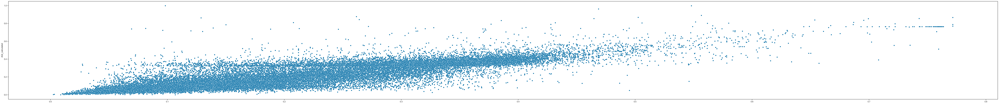

In [183]:
plt.figure(figsize=(100,100))
sns.scatterplot(x = y_pred, y = y_test)

In [186]:
predicted_actual = pd.DataFrame({ 'y_pred' : y_pred, "y_test" : y_test })
predicted_actual
predicted_actual['y_pred'].corr(predicted_actual['y_test'])
# [y_pred].corr([y_test])

,y_pred,y_test
128016,0.391321,0.465845
114582,0.098141,0.034714
77757,0.174849,0.139978
65767,0.107145,0.110862
125341,0.102969,0.096305
...,...,...
25590,0.283124,0.152296
69733,0.084166,0.066069
45625,0.190246,0.318029
45834,0.328455,0.358343


0.883935714721534

### There is 0.8839 correlation b/w actual vs predicted. Which is great.
- But for regression is correlation good or r-square good?
- Because, even for ada boost where accuracy is 38%, correlation is around 78%.
- Is correlation even a correct metric for evaluation?

In [199]:
plt.figure(figsize=(300, 20))
sns.regplot(data=predicted_actual, x='y_pred', y='y_test')

<Figure size 30000x2000 with 0 Axes>

<AxesSubplot: xlabel='y_pred', ylabel='y_test'>

In [200]:
plt.figure(figsize=(100, 20))
sns.regplot(data=predicted_actual, x='y_pred', y='y_test')

<Figure size 10000x2000 with 0 Axes>

<AxesSubplot: xlabel='y_pred', ylabel='y_test'>

In [191]:
plt.figure(figsize=(100, 100))
sns.regplot(data=predicted_actual, x='y_pred', y='y_test')

<Figure size 10000x10000 with 0 Axes>

<AxesSubplot: xlabel='y_pred', ylabel='y_test'>

### Training with sub indices

In [124]:
df_normalized.columns

Index(['PM2.5', 'PM2.5_24_avg', 'NO', 'NO2', 'NOx', 'NOx_SubIndex', 'SO2',
       'SO2_SubIndex', 'CO', 'CO_8_avg', 'Day', 'Month', 'Year', 'Week',
       'Hour', 'PM2.5_24_avg_Sub_Index', 'CO_8_avg_Sub_Index', 'NO2_Sub_Index',
       'Station_NISE', 'Station_No Station', 'Station_Sector 51',
       'Station_Teri Gram', 'Station_Vikas Sadan', 'AQI_Bucket_Good',
       'AQI_Bucket_Moderate', 'AQI_Bucket_Poor', 'AQI_Bucket_Satisfactory',
       'AQI_Bucket_Severe', 'AQI_Bucket_Very Poor'],
      dtype='object')

In [126]:
X_train, X_test, y_train, y_test = train_test_split(
    df_normalized[[
        'NOx_SubIndex', 'SO2_SubIndex', 'PM2.5_24_avg_Sub_Index',
           'CO_8_avg_Sub_Index', 'NO2_Sub_Index'
    ]],
    df['AQI_calculated'],
    train_size=0.8)

In [127]:
X_train
X_test
y_train
y_test

,NOx_SubIndex,SO2_SubIndex,PM2.5_24_avg_Sub_Index,CO_8_avg_Sub_Index,NO2_Sub_Index
8777,0.035606,0.045447,0.208878,0.062867,0.027599
62937,0.377792,0.078470,0.356731,0.212987,0.142634
120285,0.026061,0.120648,0.183298,0.070842,0.033600
47603,0.098755,0.013643,0.018149,0.237405,0.051915
90428,0.002393,0.027286,0.413854,0.120324,0.066012
...,...,...,...,...,...
106564,0.098885,0.029070,0.162314,0.078817,0.025880
145839,0.120680,0.065273,0.366663,0.113956,0.100830
141013,0.043304,0.056534,0.084365,0.043595,0.036038
118425,0.072174,0.055286,0.348235,0.101279,0.059417


,NOx_SubIndex,SO2_SubIndex,PM2.5_24_avg_Sub_Index,CO_8_avg_Sub_Index,NO2_Sub_Index
13377,0.071602,0.037184,0.050782,0.115548,0.060667
120338,0.013759,0.016051,0.273807,0.042399,0.022066
110563,0.016177,0.094878,0.222290,0.101944,0.107988
79627,0.044397,0.033172,0.067826,0.136244,0.021973
77842,0.018284,0.027019,0.059956,0.025386,0.043664
...,...,...,...,...,...
47434,0.110849,0.013643,0.166992,0.073899,0.047758
102607,0.022263,0.022204,0.341440,0.066722,0.044508
139600,0.039897,0.048776,0.422229,0.167505,0.027567
36001,0.046556,0.072228,0.390694,0.002127,0.032975


8777      190.0
62945     324.0
120293    166.0
47610     112.0
90436     375.0
          ...  
106572    147.0
145848    333.0
141022     77.0
118433    316.0
83660     314.0
Name: AQI_calculated, Length: 117925, dtype: float64

13377      54.0
120346    248.0
110571    202.0
79635      64.0
77850      55.0
          ...  
47441     152.0
102615    310.0
139609    383.0
36006     354.0
69855      77.0
Name: AQI_calculated, Length: 29482, dtype: float64

LinearRegression()
score(X_test, y_test)  0.9766838525502514
CV scores [0.97392435 0.9762501  0.97548886 0.97757825 0.97711386]
Average cv score  0.9760710830137231
 mean_squared_log_error  0.13678756782340104
 mean_squared_error  379.9066843214689
r2_score  0.9766838525502514

DecisionTreeRegressor()
score(X_test, y_test)  0.999638631642831
CV scores [0.99959562 0.99967545 0.99944087 0.99941831 0.99965946]
Average cv score  0.9995579409359495
 mean_squared_log_error  0.011182518744856124
 mean_squared_error  5.888033376297402
r2_score  0.999638631642831

RandomForestRegressor()
score(X_test, y_test)  0.9997048691753626
CV scores [0.99979961 0.99975885 0.99960884 0.99967546 0.99976869]
Average cv score  0.9997222904010169
 mean_squared_log_error  0.008782025042098554
 mean_squared_error  4.808777833932568
r2_score  0.9997048691753626

AdaBoostRegressor()
score(X_test, y_test)  0.9668817164446993
CV scores [0.93498105 0.92296963 0.92372787 0.92445054 0.92649207]
Average cv score  0.9265

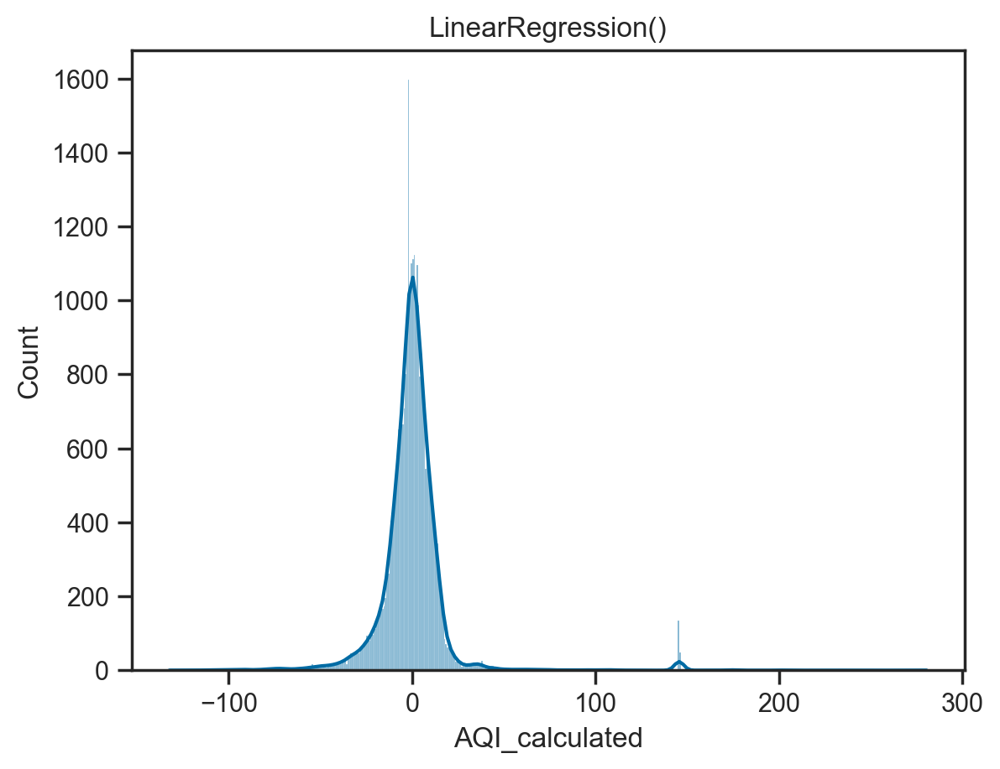

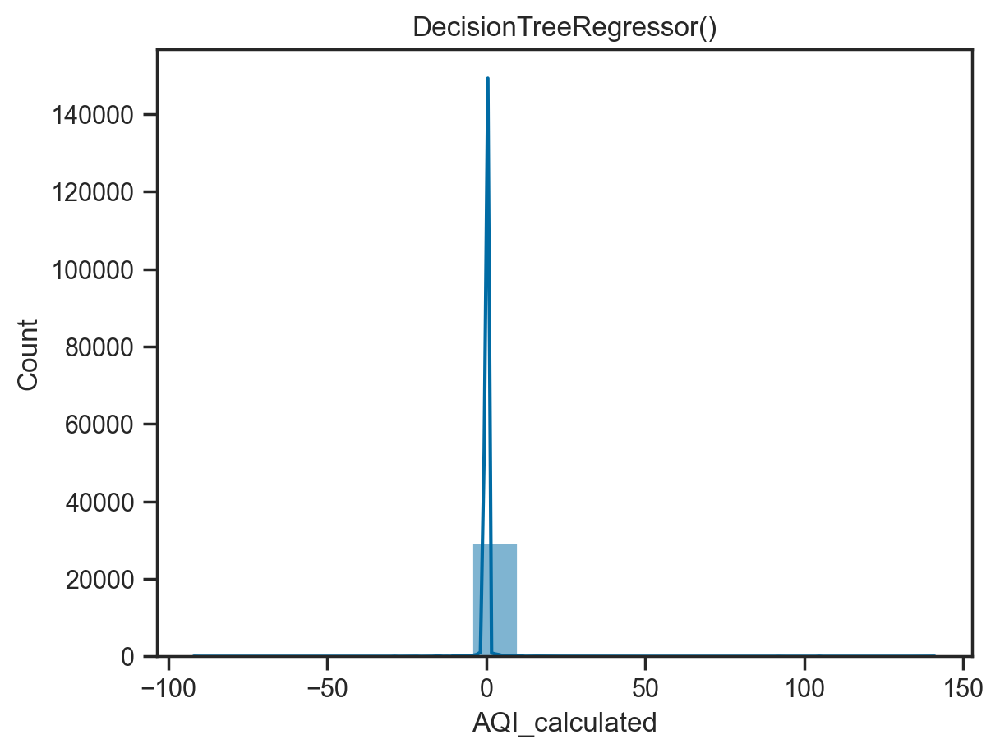

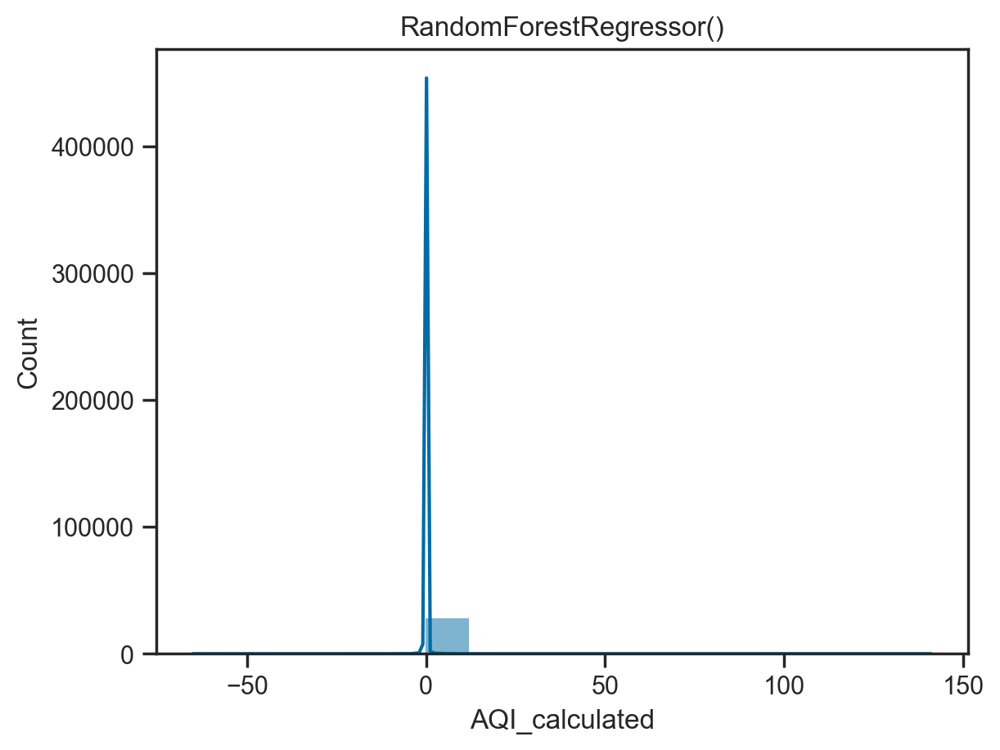

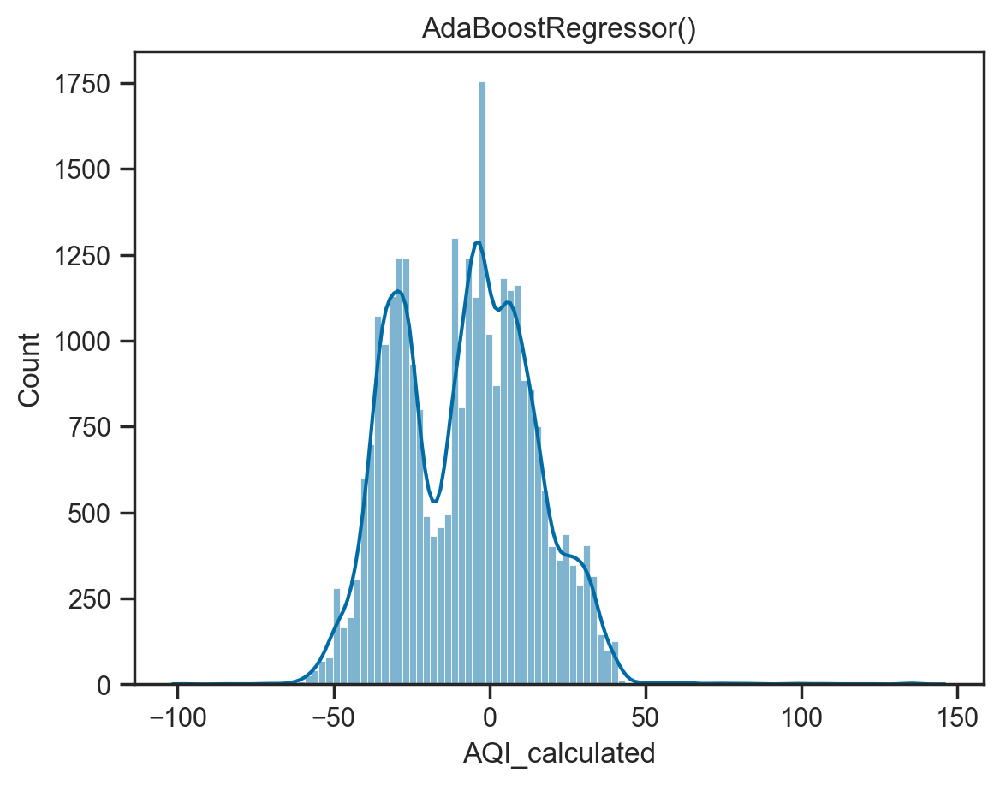

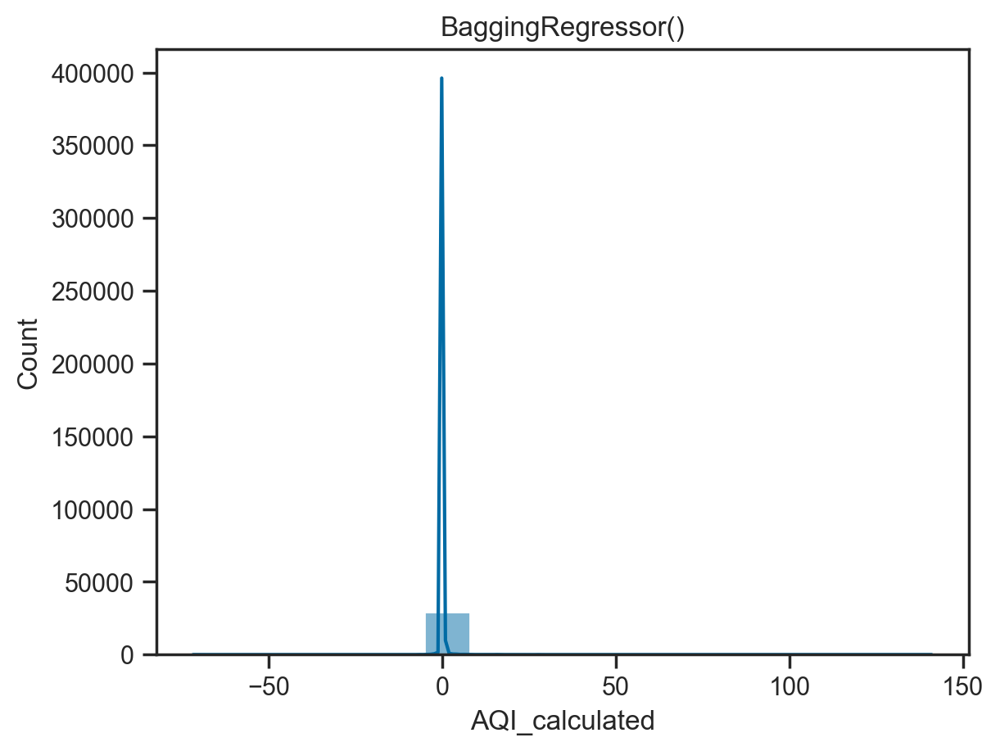

In [128]:

lr = LinearRegression()
tree = DecisionTreeRegressor()
rf = RandomForestRegressor()
ab = AdaBoostRegressor()
br = BaggingRegressor()
for i in [lr, tree, rf, ab, br]:
    helper(i)


### Training with 1 column that is highly correlated with target 

In [79]:
X_train, X_test, y_train, y_test = train_test_split(
    df_normalized.loc[:,['PM2.5_24_avg']],
    df_normalized['AQI_calculated'],
    train_size=0.8)

lr = LinearRegression()
tree = DecisionTreeRegressor()
rf = RandomForestRegressor()
ab = AdaBoostRegressor()
br = BaggingRegressor()
for i in [lr, tree, rf, ab, br]:
    helper(i)

LinearRegression()
score(X_test, y_test)  0.8270990138582306
CV scores [-0.00350682 -0.00342613 -0.00347612]
Average cv score  -0.0034696925408118653
 mean_squared_log_error  0.04636149889929995
 mean_squared_error  0.0035023025506045204
r2_score  0.8270990138582306

DecisionTreeRegressor()
score(X_test, y_test)  0.9770469887252663
CV scores [-0.00047347 -0.0004179  -0.00045385]
Average cv score  -0.0004484082563373703
 mean_squared_log_error  0.018181480490182558
 mean_squared_error  0.0004649388747016181
r2_score  0.9770469887252663

RandomForestRegressor()
score(X_test, y_test)  0.9827481383489383
CV scores [-0.00036488 -0.00031345 -0.0003535 ]
Average cv score  -0.0003439436035722996
 mean_squared_log_error  0.01593286535627553
 mean_squared_error  0.0003494557226738304
r2_score  0.9827481383489383

AdaBoostRegressor()
score(X_test, y_test)  0.7256679259691641
CV scores [-0.00147482 -0.00135958 -0.00065522]
Average cv score  -0.0011632052727186177
 mean_squared_log_error  0.0642327

In [78]:
df_normalized.loc[:,['PM2.5_24_avg']]

,PM2.5_24_avg
0,0.081109
1,0.078014
2,0.075219
3,0.072897
4,0.069388
...,...
147402,0.054191
147403,0.055299
147404,0.056805
147405,0.058057


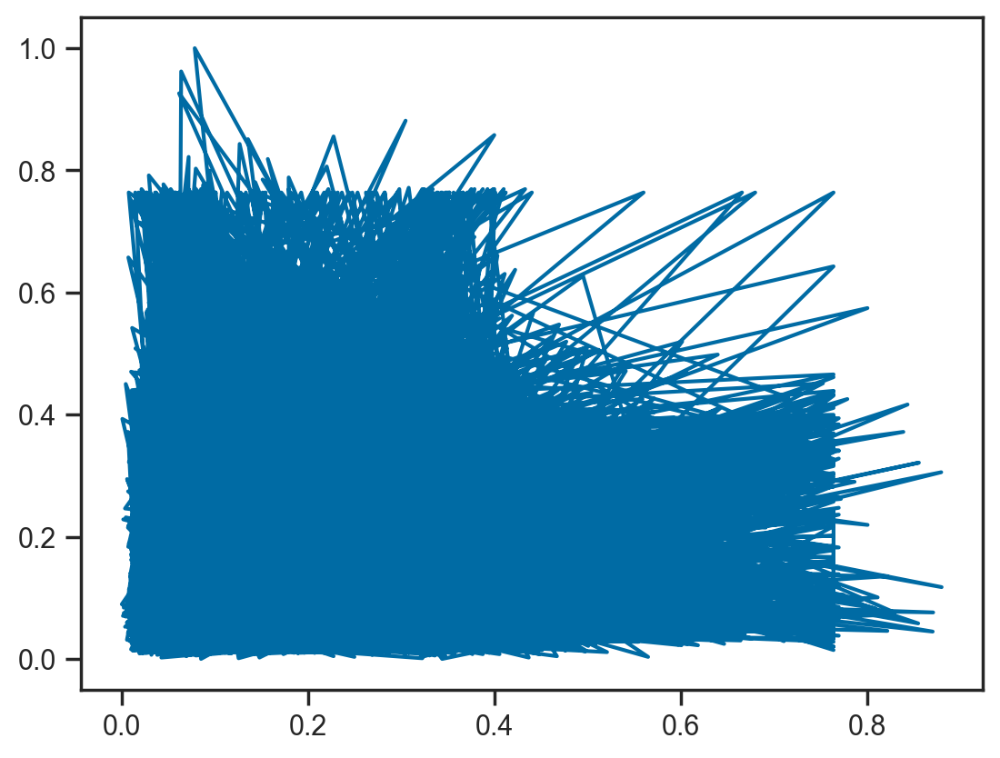

In [81]:
plt.plot(y_pred,y_test)

In [85]:
px.scatter(y_pred[:100],y_test[:100],color=y_test[:100])

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_59435/3808520363.py:1: FutureWarning:

The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.



In [89]:
pd.DataFrame({ 'y_pred' : y_pred[:100],
               'y_test' : y_test[:100]})

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_59435/4238656000.py:2: FutureWarning:

The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.



,y_pred,y_test
48161,0.385218,0.190370
18013,0.397536,0.128779
71335,0.374020,0.015677
137882,0.339306,0.200448
12783,0.324748,0.304591
...,...,...
9561,0.132139,0.042553
111568,0.032475,0.201568
106397,0.250840,0.064950
45119,0.119709,0.362822


/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_59435/689664235.py:1: FutureWarning:

The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.



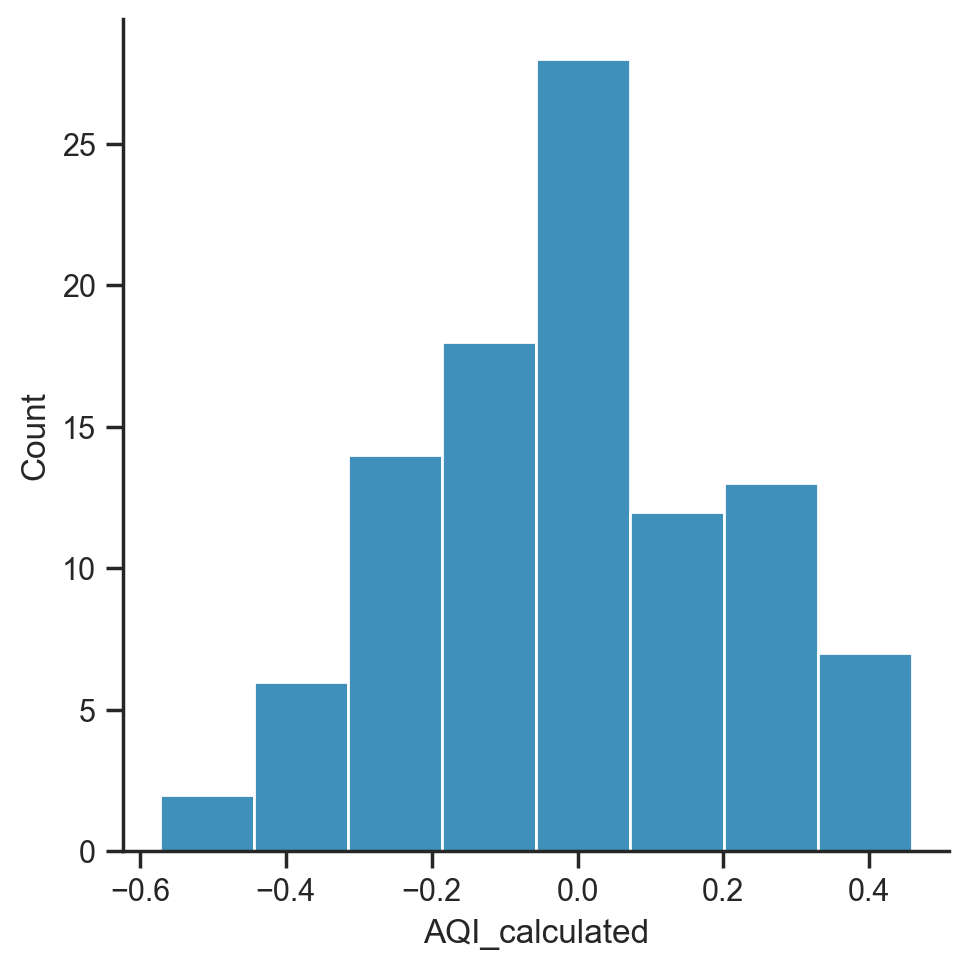

In [87]:
sns.displot(y_pred[:100]-y_test[:100])

### Include Datetime - But, how to include Datetime while training as it is not int??

### Checking multi-collinearity - very dangerous in regression

In [69]:
df.corr()

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_59435/1134722465.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,CO_8_avg,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
PM2.5,1.000000,0.790944,0.066914,0.101746,0.105676,0.115465,0.063418,0.067181,0.248702,0.246879,...,0.150082,0.040593,-0.055048,-0.043220,-0.236997,-0.128527,0.009431,-0.334091,0.530744,0.383766
PM2.5_24_avg,0.790944,1.000000,0.024966,0.088298,0.062186,0.071711,0.030809,0.033747,0.228182,0.250464,...,0.177715,0.047982,-0.065107,-0.051189,-0.287029,-0.160870,0.006217,-0.406771,0.688756,0.455172
NO,0.066914,0.024966,1.000000,0.642984,0.859559,0.840975,0.054366,0.059160,0.096781,0.081866,...,-0.013735,-0.034143,-0.055331,0.016146,-0.073964,-0.057943,0.173483,-0.130536,0.043171,0.081400
NO2,0.101746,0.088298,0.642984,1.000000,0.700923,0.703771,0.095589,0.104831,0.083772,0.069345,...,0.009454,-0.077419,-0.115790,0.086540,-0.122897,-0.021106,0.151319,-0.171436,0.054179,0.134459
NOx,0.105676,0.062186,0.859559,0.700923,1.000000,0.997072,0.133949,0.145452,0.116766,0.097411,...,-0.005296,-0.137584,-0.082691,0.060415,-0.095225,-0.045341,0.152278,-0.161496,0.046189,0.132039
NOx_SubIndex,0.115465,0.071711,0.840975,0.703771,0.997072,1.000000,0.141720,0.153866,0.120412,0.101166,...,-0.002959,-0.148768,-0.084100,0.062481,-0.100931,-0.042663,0.152673,-0.169065,0.044117,0.141867
SO2,0.063418,0.030809,0.054366,0.095589,0.133949,0.141720,1.000000,0.986258,0.040032,0.031169,...,0.079284,-0.128937,-0.097673,0.157941,-0.050165,0.029897,0.001107,-0.032221,0.023580,0.026555
SO2_SubIndex,0.067181,0.033747,0.059160,0.104831,0.145452,0.153866,0.986258,1.000000,0.043563,0.033894,...,0.083108,-0.141781,-0.103802,0.171060,-0.052381,0.026036,0.002339,-0.030523,0.024390,0.028627
CO,0.248702,0.228182,0.096781,0.083772,0.116766,0.120412,0.040032,0.043563,1.000000,0.910837,...,0.068324,-0.012234,-0.059886,-0.007004,-0.086949,-0.038201,-0.001514,-0.127605,0.200631,0.138726
CO_8_avg,0.246879,0.250464,0.081866,0.069345,0.097411,0.101166,0.031169,0.033894,0.910837,1.000000,...,0.072663,-0.012995,-0.063727,-0.007457,-0.093553,-0.042289,-0.003336,-0.137423,0.221428,0.149388


In [70]:
df.corr().style.highlight_between(left=0.4, right=1)

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_59435/2348886569.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr().style.highlight_between(left=0.4, right=1)


,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,CO_8_avg,Day,Month,Year,Week,Hour,AQI_calculated,PM2.5_24_avg_Sub_Index,CO_8_avg_Sub_Index,NO2_Sub_Index,Station_NISE,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
PM2.5,1.000000,0.790944,0.066914,0.101746,0.105676,0.115465,0.063418,0.067181,0.248702,0.246879,-0.018068,0.071429,-0.153291,0.078518,-0.052926,0.731369,0.745123,0.345829,0.112880,-0.115692,0.150082,0.040593,-0.055048,-0.043220,-0.236997,-0.128527,0.009431,-0.334091,0.530744,0.383766
PM2.5_24_avg,0.790944,1.000000,0.024966,0.088298,0.062186,0.071711,0.030809,0.033747,0.228182,0.250464,-0.022622,0.081048,-0.180718,0.089265,-0.000010,0.909951,0.926832,0.346923,0.100056,-0.136973,0.177715,0.047982,-0.065107,-0.051189,-0.287029,-0.160870,0.006217,-0.406771,0.688756,0.455172
NO,0.066914,0.024966,1.000000,0.642984,0.859559,0.840975,0.054366,0.059160,0.096781,0.081866,0.002379,0.059313,0.036976,0.058681,-0.042461,0.190665,0.033303,0.178686,0.631041,0.089200,-0.013735,-0.034143,-0.055331,0.016146,-0.073964,-0.057943,0.173483,-0.130536,0.043171,0.081400
NO2,0.101746,0.088298,0.642984,1.000000,0.700923,0.703771,0.095589,0.104831,0.083772,0.069345,0.017419,0.016391,0.069408,0.017711,0.014479,0.243231,0.112125,0.181659,0.997241,0.095763,0.009454,-0.077419,-0.115790,0.086540,-0.122897,-0.021106,0.151319,-0.171436,0.054179,0.134459
NOx,0.105676,0.062186,0.859559,0.700923,1.000000,0.997072,0.133949,0.145452,0.116766,0.097411,0.011658,0.057838,0.083673,0.057178,-0.037379,0.224412,0.092220,0.214500,0.703355,0.166001,-0.005296,-0.137584,-0.082691,0.060415,-0.095225,-0.045341,0.152278,-0.161496,0.046189,0.132039
NOx_SubIndex,0.115465,0.071711,0.840975,0.703771,0.997072,1.000000,0.141720,0.153866,0.120412,0.101166,0.011935,0.057659,0.091917,0.057015,-0.040356,0.232443,0.105689,0.224102,0.708725,0.173831,-0.002959,-0.148768,-0.084100,0.062481,-0.100931,-0.042663,0.152673,-0.169065,0.044117,0.141867
SO2,0.063418,0.030809,0.054366,0.095589,0.133949,0.141720,1.000000,0.986258,0.040032,0.031169,0.035448,-0.048850,-0.006574,-0.047034,-0.003490,0.043552,0.041581,0.064162,0.103682,-0.022893,0.079284,-0.128937,-0.097673,0.157941,-0.050165,0.029897,0.001107,-0.032221,0.023580,0.026555
SO2_SubIndex,0.067181,0.033747,0.059160,0.104831,0.145452,0.153866,0.986258,1.000000,0.043563,0.033894,0.034788,-0.054576,-0.007077,-0.052804,-0.004145,0.046187,0.045751,0.069428,0.113674,-0.021452,0.083108,-0.141781,-0.103802,0.171060,-0.052381,0.026036,0.002339,-0.030523,0.024390,0.028627
CO,0.248702,0.228182,0.096781,0.083772,0.116766,0.120412,0.040032,0.043563,1.000000,0.910837,-0.016067,-0.008531,-0.085501,0.003912,-0.002666,0.246257,0.229901,0.769040,0.087660,0.000206,0.068324,-0.012234,-0.059886,-0.007004,-0.086949,-0.038201,-0.001514,-0.127605,0.200631,0.138726
CO_8_avg,0.246879,0.250464,0.081866,0.069345,0.097411,0.101166,0.031169,0.033894,0.910837,1.000000,-0.019171,-0.011017,-0.090553,0.002250,-0.057998,0.267677,0.250860,0.843344,0.073105,0.000249,0.072663,-0.012995,-0.063727,-0.007457,-0.093553,-0.042289,-0.003336,-0.137423,0.221428,0.149388



### Question is, should you use subIndex or direct value for training? As they both are correlated highly for all paramters like CO, PM2.5, SO2 etc??
- ### Refer to notebooks in https://www.kaggle.com/datasets/rohanrao/air-quality-data-in-india/code?datasetId=630055&sortBy=voteCount

In [63]:
df_normalized.corr()

,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,CO_8_avg,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
PM2.5,1.000000,0.790944,0.066914,0.101746,0.105676,0.115465,0.063418,0.067181,0.248702,0.246879,...,0.150082,0.040593,-0.055048,-0.043220,-0.236997,-0.128527,0.009431,-0.334091,0.530744,0.383766
PM2.5_24_avg,0.790944,1.000000,0.024966,0.088298,0.062186,0.071711,0.030809,0.033747,0.228182,0.250464,...,0.177715,0.047982,-0.065107,-0.051189,-0.287029,-0.160870,0.006217,-0.406771,0.688756,0.455172
NO,0.066914,0.024966,1.000000,0.642984,0.859559,0.840975,0.054366,0.059160,0.096781,0.081866,...,-0.013735,-0.034143,-0.055331,0.016146,-0.073964,-0.057943,0.173483,-0.130536,0.043171,0.081400
NO2,0.101746,0.088298,0.642984,1.000000,0.700923,0.703771,0.095589,0.104831,0.083772,0.069345,...,0.009454,-0.077419,-0.115790,0.086540,-0.122897,-0.021106,0.151319,-0.171436,0.054179,0.134459
NOx,0.105676,0.062186,0.859559,0.700923,1.000000,0.997072,0.133949,0.145452,0.116766,0.097411,...,-0.005296,-0.137584,-0.082691,0.060415,-0.095225,-0.045341,0.152278,-0.161496,0.046189,0.132039
NOx_SubIndex,0.115465,0.071711,0.840975,0.703771,0.997072,1.000000,0.141720,0.153866,0.120412,0.101166,...,-0.002959,-0.148768,-0.084100,0.062481,-0.100931,-0.042663,0.152673,-0.169065,0.044117,0.141867
SO2,0.063418,0.030809,0.054366,0.095589,0.133949,0.141720,1.000000,0.986258,0.040032,0.031169,...,0.079284,-0.128937,-0.097673,0.157941,-0.050165,0.029897,0.001107,-0.032221,0.023580,0.026555
SO2_SubIndex,0.067181,0.033747,0.059160,0.104831,0.145452,0.153866,0.986258,1.000000,0.043563,0.033894,...,0.083108,-0.141781,-0.103802,0.171060,-0.052381,0.026036,0.002339,-0.030523,0.024390,0.028627
CO,0.248702,0.228182,0.096781,0.083772,0.116766,0.120412,0.040032,0.043563,1.000000,0.910837,...,0.068324,-0.012234,-0.059886,-0.007004,-0.086949,-0.038201,-0.001514,-0.127605,0.200631,0.138726
CO_8_avg,0.246879,0.250464,0.081866,0.069345,0.097411,0.101166,0.031169,0.033894,0.910837,1.000000,...,0.072663,-0.012995,-0.063727,-0.007457,-0.093553,-0.042289,-0.003336,-0.137423,0.221428,0.149388


<AxesSubplot: >

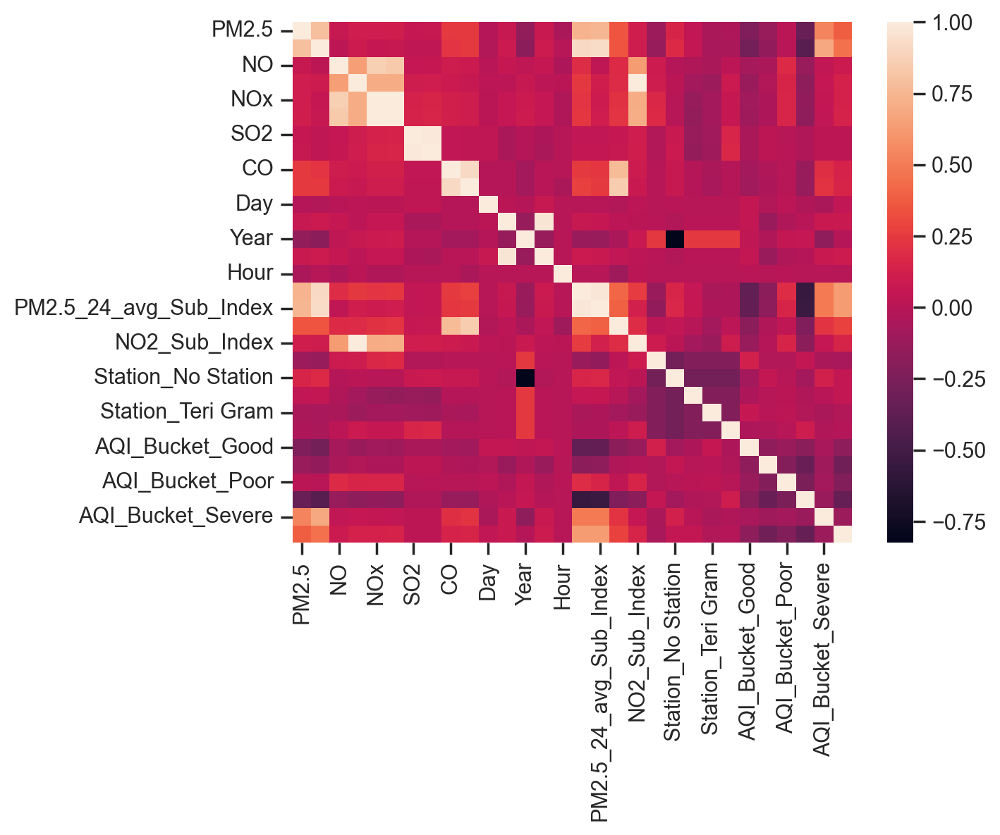

In [64]:
sns.heatmap(df_normalized.corr())

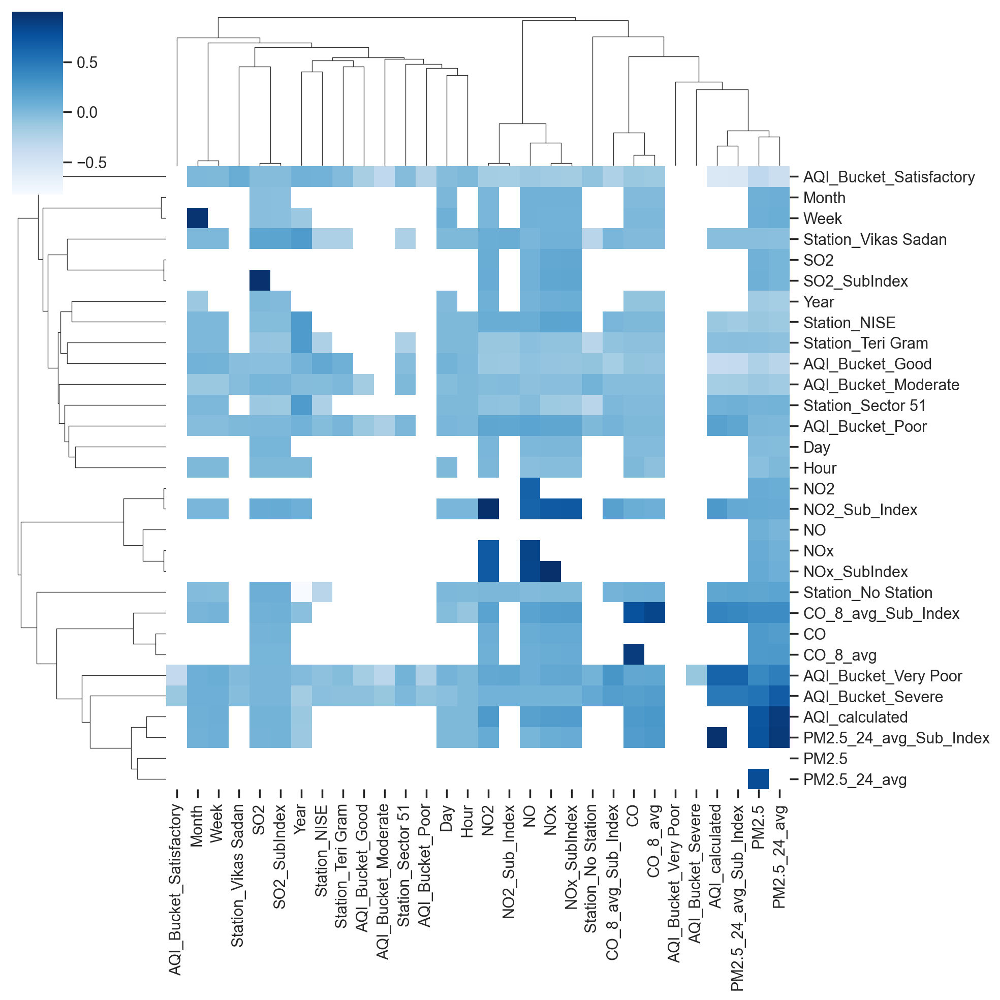

In [67]:
sns.clustermap(df_normalized.corr(), mask=np.triu(df_normalized.corr()), cmap="Blues")

In [68]:
sns.pairplot(df_normalized)

KeyboardInterrupt: 

Error in callback <function _draw_all_if_interactive at 0x154afee60> (for post_execute):


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x29e0a4a60> (for post_execute):


KeyboardInterrupt: 

# DO extensive EDA once again. As dataset is clean now
# In website/webapp, show nice graphs. How Gurgoan AQI is changing over time, race bar chart etc.

## Draw random forests boundary lines to understand the actual vs predicted scatter plot
## Learn non-linear regression curve
## DO Standardization & repeat training part

## Report all regression evaluation metrics

- ## Since our model is independent of location, check with Hyderabad AQI if our model gives correct predictions
- ### While doing web app, giving inputs, show some suggestions. Because normal people don't know what PM2.5 range will be. 
- ### Write down all hyper-parameter tuning in a table like (model, parameters, r2 score)

- ## Refer to this paper laso - Chenghao Shi, Yu Wang, Ying Wan, Shuguang Wu, “Air Quality Prediction Based on Machine Learning”, 2022 International Conference on Machine Learning and Knowledge Engineering (MLKE), IEEE Conference, 2022
- ### Do we have confusion matrix for regression?

In [65]:
df.columns

Index(['Datetime', 'PM2.5', 'PM2.5_24_avg', 'NO', 'NO2', 'NOx', 'NOx_SubIndex',
       'SO2', 'SO2_SubIndex', 'CO', 'CO_8_avg', 'Day', 'Month', 'Year', 'Week',
       'Hour', 'AQI_calculated', 'PM2.5_24_avg_Sub_Index',
       'CO_8_avg_Sub_Index', 'NO2_Sub_Index', 'Station_NISE',
       'Station_No Station', 'Station_Sector 51', 'Station_Teri Gram',
       'Station_Vikas Sadan', 'AQI_Bucket_Good', 'AQI_Bucket_Moderate',
       'AQI_Bucket_Poor', 'AQI_Bucket_Satisfactory', 'AQI_Bucket_Severe',
       'AQI_Bucket_Very Poor'],
      dtype='object')

<AxesSubplot: >

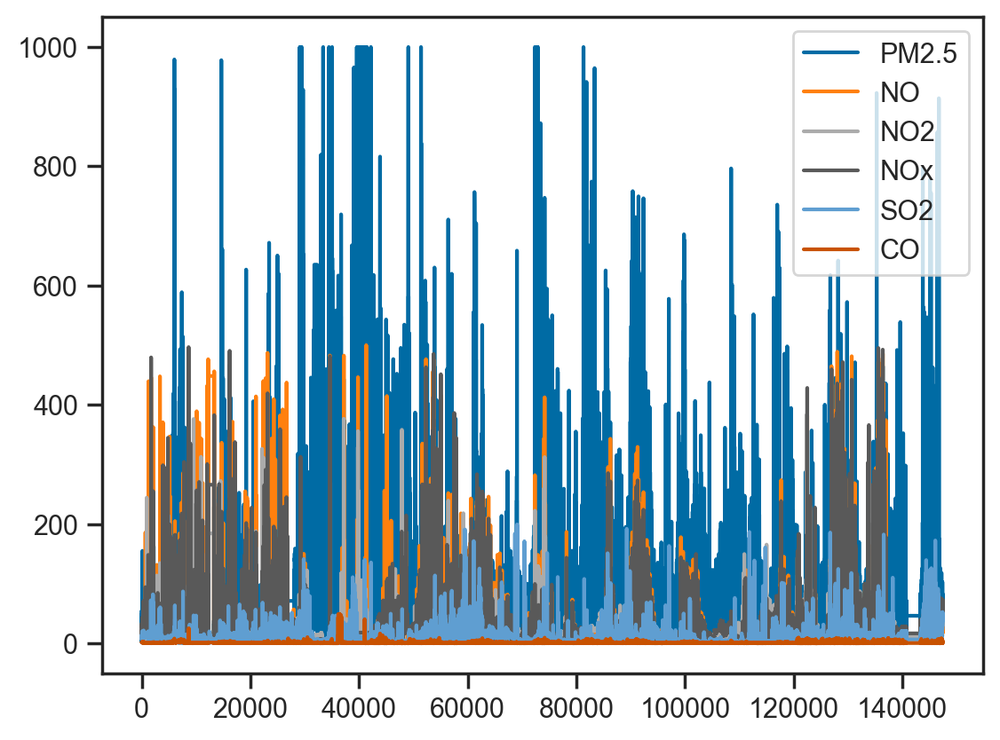

In [68]:
df[['Datetime', 'PM2.5','NO', 'NO2', 'NOx','SO2', 'CO']].plot()

<AxesSubplot: xlabel='Datetime', ylabel='PM2.5'>

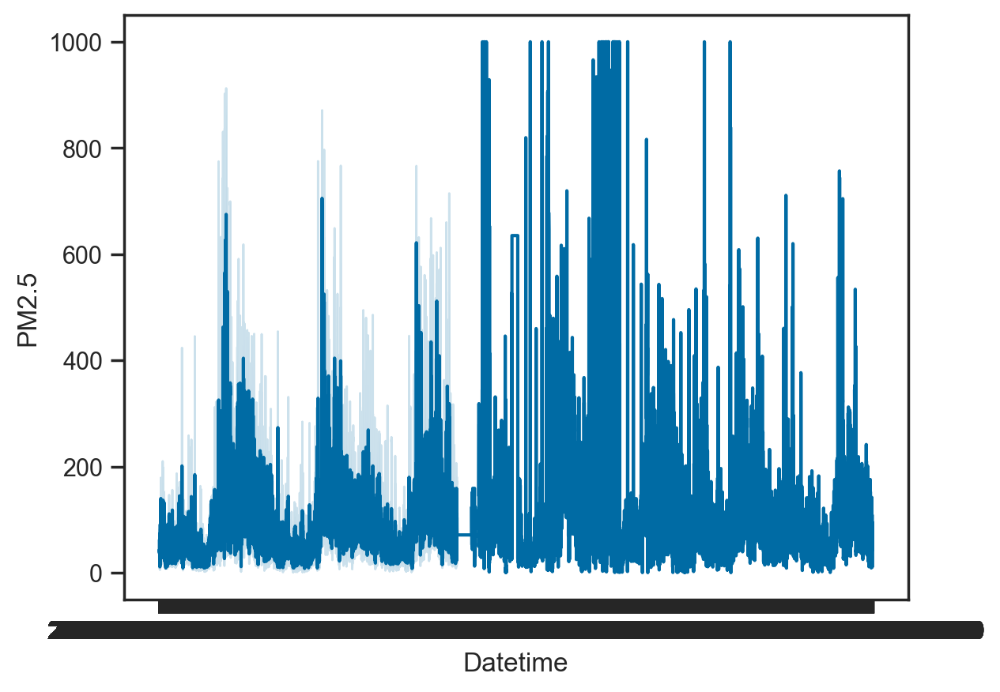

In [69]:
sns.lineplot(data = df, x='Datetime', y='PM2.5')

<Figure size 2400x200 with 0 Axes>

<AxesSubplot: xlabel='Datetime', ylabel='PM2.5'>

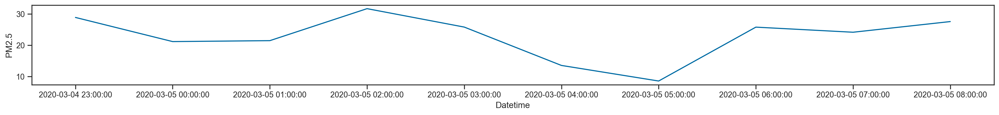

In [76]:
plt.figure(figsize=(24,2))
sns.lineplot(data = df[:10], x='Datetime', y='PM2.5')

<AxesSubplot: xlabel='Datetime', ylabel='PM2.5'>

<AxesSubplot: xlabel='Datetime', ylabel='NO'>

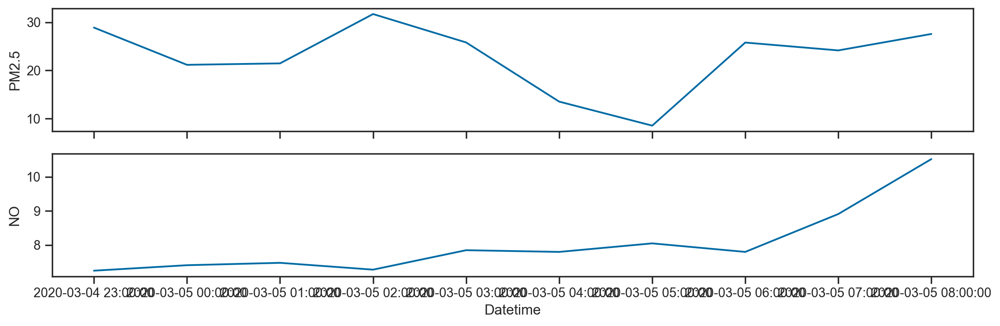

In [89]:
fig, ax = plt.subplots(2,1,figsize= (12,4), sharex=True)
# ax 
# ['Datetime', 'PM2.5','NO', 'NO2', 'NOx','SO2', 'CO']
sns.lineplot(data = df[:10], x='Datetime', y='PM2.5', ax = ax[0])
sns.lineplot(data = df[:10], x='Datetime', y='NO', ax = ax[1])
plt.tight_layout()

### Do scatter plot for each pollutant vs AQI

<Figure size 1200x600 with 0 Axes>

<AxesSubplot: xlabel='PM2.5', ylabel='AQI_calculated'>

Text(0.5, 1.0, '0.004202348511464171')

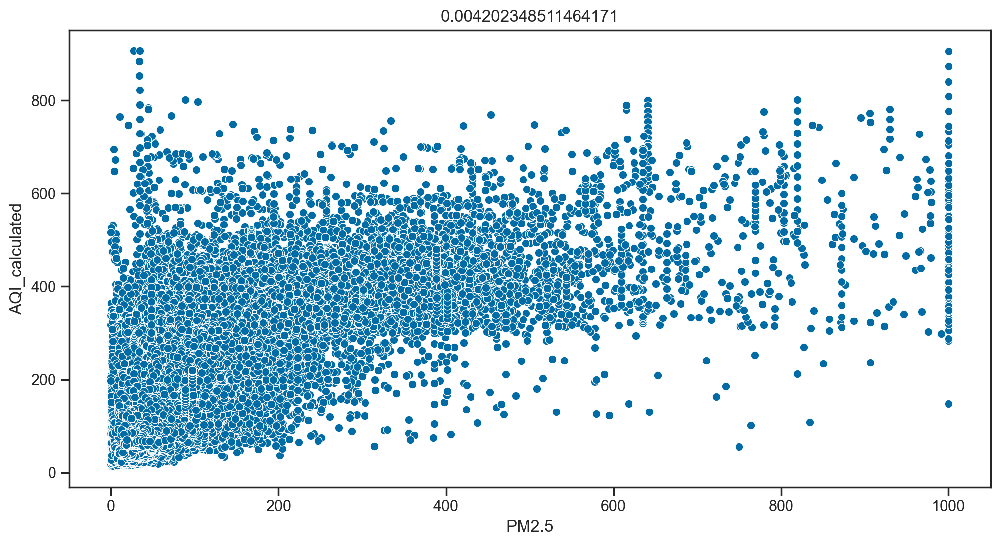

In [91]:
plt.figure(figsize=(12,6))
sns.scatterplot(data=df, x='PM2.5', y='AQI_calculated')
plt.title(r2_score(df['AQI_calculated'],df['PM2.5']))

In [24]:
plt.figure(figsize=(100,20))
sns.scatterplot(data=df, x='PM2.5', y='AQI_calculated')
plt.title(r2_score(df['AQI_calculated'],df['PM2.5']))

<Figure size 10000x2000 with 0 Axes>

<AxesSubplot: xlabel='PM2.5', ylabel='AQI_calculated'>

Text(0.5, 1.0, '0.004202348511464171')

<Figure size 1200x600 with 0 Axes>

<AxesSubplot: xlabel='PM2.5', ylabel='AQI_calculated'>

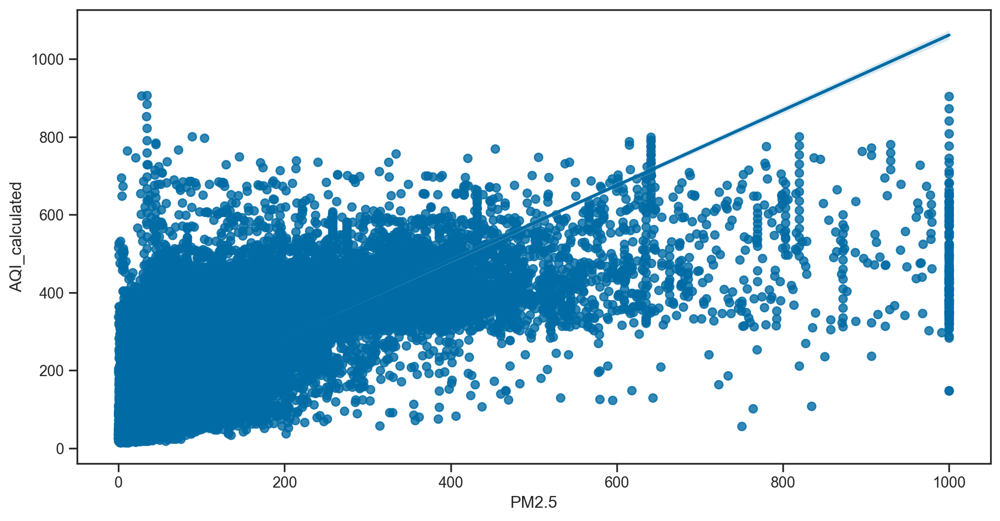

In [92]:
plt.figure(figsize=(12,6))
sns.regplot(data=df, x='PM2.5', y='AQI_calculated')

In [117]:
# 'NO', 'NO2', 'NOx','SO2', 'CO'

plt.figure(figsize=(100,20))
sns.scatterplot(data=df, x='NO', y='AQI_calculated')
plt.title("r2_score is {0} ".format(r2_score(df['AQI_calculated'],df['NO'])))

<Figure size 10000x2000 with 0 Axes>

<AxesSubplot: xlabel='NO', ylabel='AQI_calculated'>

Text(0.5, 1.0, 'r2_score is -1.851654778109935 ')

## Standardization &  Training with all other regression algorithms
- https://www.kaggle.com/code/abrish2003/diamond-price-stacked-regressor
### Conclusion: Not any better results. So ignore the below

In [94]:
from sklearn.pipeline import make_pipeline 
from sklearn.preprocessing import StandardScaler 
from sklearn.linear_model import ElasticNet, Lasso,LinearRegression,RidgeCV
# from catboost import CatBoostRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import StackingRegressor
from sklearn.svm import SVR

In [95]:
pipelines = {
    'en':make_pipeline(StandardScaler(), ElasticNet()),
    'lasso':make_pipeline(StandardScaler(), Lasso()),
    'Rcv':make_pipeline(StandardScaler(), RidgeCV()),
    'lr':make_pipeline(StandardScaler(), LinearRegression()),
    'rf':make_pipeline(StandardScaler(), RandomForestRegressor()),
    'gb':make_pipeline(StandardScaler(), GradientBoostingRegressor()),
    'dtc':make_pipeline(StandardScaler(),DecisionTreeRegressor()),
    'xg':make_pipeline(StandardScaler(),XGBRegressor()),
    'svr':make_pipeline(StandardScaler(),SVR())
}

In [98]:
df

,Datetime,PM2.5,PM2.5_24_avg,NO,NO2,NOx,NOx_SubIndex,SO2,SO2_SubIndex,CO,...,Station_No Station,Station_Sector 51,Station_Teri Gram,Station_Vikas Sadan,AQI_Bucket_Good,AQI_Bucket_Moderate,AQI_Bucket_Poor,AQI_Bucket_Satisfactory,AQI_Bucket_Severe,AQI_Bucket_Very Poor
0,2020-03-04 23:00:00,28.89,73.831667,7.25,21.37,28.63,35.7875,7.690000,9.612500,1.76,...,0,0,0,0,0,1,0,0,0,0
1,2020-03-05 00:00:00,21.17,71.019167,7.41,20.99,28.41,35.5125,7.440000,9.300000,1.71,...,0,0,0,0,0,1,0,0,0,0
2,2020-03-05 01:00:00,21.47,68.479583,7.48,20.49,27.97,34.9625,6.823333,8.529167,1.74,...,0,0,0,0,0,1,0,0,0,0
3,2020-03-05 02:00:00,31.70,66.369167,7.28,14.93,22.22,27.7750,6.633333,8.291667,1.60,...,0,0,0,0,0,1,0,0,0,0
4,2020-03-05 03:00:00,25.81,63.180417,7.85,17.92,25.77,32.2125,6.583333,8.229167,1.56,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147411,2023-03-26 03:00:00,83.22,49.372083,23.90,49.59,70.03,87.5375,41.300000,51.376923,0.87,...,0,0,0,1,0,0,0,1,0,0
147412,2023-03-26 04:00:00,71.96,50.378750,24.25,53.15,71.91,89.8875,40.560000,50.447179,0.66,...,0,0,0,1,0,0,0,1,0,0
147413,2023-03-26 05:00:00,75.47,51.747083,24.55,54.38,64.34,80.4250,40.820000,50.773846,0.28,...,0,0,0,1,0,0,0,1,0,0
147414,2023-03-26 06:00:00,69.07,52.885000,23.09,54.48,72.73,90.9125,39.290000,49.112500,0.43,...,0,0,0,1,0,0,0,1,0,0


In [100]:
X_train_std, X_test_std, y_train_std, y_test_std = train_test_split(df.drop([
    'Datetime', 'PM2.5_24_avg', 'NOx_SubIndex', 'SO2_SubIndex', 'CO_8_avg', 'Day', 'Month',
    'Year', 'Week', 'Hour', 'PM2.5_24_avg_Sub_Index', 'Station_NISE',
    'Station_No Station', 'Station_Sector 51', 'Station_Teri Gram',
    'Station_Vikas Sadan', 'CO_8_avg_Sub_Index', 'NO2_Sub_Index',
    'AQI_Bucket_Good', 'AQI_Bucket_Moderate', 'AQI_Bucket_Poor',
    'AQI_Bucket_Satisfactory', 'AQI_Bucket_Severe', 'AQI_Bucket_Very Poor', 'AQI_calculated'
],
                                                                       axis=1),
                                                    df['AQI_calculated'],
                                                    train_size=0.7)
X_train_std
X_test_std
y_train_std
y_test_std

,PM2.5,NO,NO2,NOx,SO2,CO
111854,87.50,14.24,30.88,42.88,18.06,0.62
101374,81.04,65.75,12.48,59.24,1.73,2.20
75215,276.19,17.38,25.45,24.13,1.86,1.65
143345,84.37,15.42,27.56,32.43,12.07,1.96
57545,105.53,24.40,55.82,39.37,10.88,0.02
...,...,...,...,...,...,...
2976,37.05,4.23,18.21,22.44,6.00,0.78
46916,74.76,25.86,22.20,33.42,2.92,1.09
62058,231.50,15.54,58.48,55.36,0.46,2.22
81027,131.41,4.01,7.00,2.96,1.98,1.15


,PM2.5,NO,NO2,NOx,SO2,CO
67732,51.82,4.42,11.64,9.62,14.760000,0.54
28742,70.74,19.34,11.27,14.14,9.460000,0.58
1835,67.58,9.20,19.79,29.00,9.433333,0.81
113125,130.62,8.16,11.43,18.48,9.810000,0.67
115755,25.80,2.27,44.70,26.17,2.600000,0.38
...,...,...,...,...,...,...
111368,71.08,12.22,36.09,24.72,1.450000,0.49
64194,16.32,5.96,46.55,35.38,3.710000,0.96
59205,30.69,7.56,8.04,15.32,2.440000,0.22
57811,73.75,2.53,57.11,21.12,1.990000,0.18


111854    272.0
101374    123.0
75215     386.0
143345     81.0
57545     301.0
          ...  
2976       78.0
46916     119.0
62058     379.0
81027     244.0
95167      99.0
Name: AQI_calculated, Length: 103184, dtype: float64

67732      53.0
28742     134.0
1835      157.0
113125    287.0
115755     56.0
          ...  
111368    157.0
64194     136.0
59205      45.0
57811     237.0
95289      48.0
Name: AQI_calculated, Length: 44223, dtype: float64

In [101]:
fit_models = {}
for algo, pipeline in pipelines.items():
    model = pipeline.fit(X_train_std, y_train_std)
    fit_models[algo] = model

In [102]:
from sklearn.metrics import mean_absolute_error, mean_squared_error,r2_score
maes=[]
al=[]
rmse=[]
r2=[]
for algo, model in fit_models.items():
    yhat = model.predict(X_test_std)
    al.append(algo)
    maes.append(mean_absolute_error(y_test,yhat))
    r2.append(r2_score(y_test,yhat))
    rmse.append(mean_squared_error(y_test,yhat)**(0.5))
    print(algo,'MEAN ABSOLUTE ERROR: ', mean_absolute_error(y_test,yhat))
    print(algo,'ROOT MEAN SQUARED ERROR: ',mean_squared_error(y_test,yhat)**(0.5))
    print(algo,'R2 Score: ',r2_score(y_test,yhat))
    print("\n\n")

en MEAN ABSOLUTE ERROR:  190.4636420059867
en ROOT MEAN SQUARED ERROR:  201.88091569156032
en R2 Score:  -2019406.1822836269



lasso MEAN ABSOLUTE ERROR:  190.53639459870246
lasso ROOT MEAN SQUARED ERROR:  212.84654638573383
lasso R2 Score:  -2244741.7637655246



Rcv MEAN ABSOLUTE ERROR:  190.52982279002333
Rcv ROOT MEAN SQUARED ERROR:  213.39512941894034
Rcv R2 Score:  -2256327.7136801947



lr MEAN ABSOLUTE ERROR:  190.52984642160789
lr ROOT MEAN SQUARED ERROR:  213.39895000608254
lr R2 Score:  -2256408.50819191



rf MEAN ABSOLUTE ERROR:  190.84619217651928
rf ROOT MEAN SQUARED ERROR:  220.614208743617
rf R2 Score:  -2411571.5093334615



gb MEAN ABSOLUTE ERROR:  190.16288679995378
gb ROOT MEAN SQUARED ERROR:  218.33225263630524
gb R2 Score:  -2361940.6032911856



dtc MEAN ABSOLUTE ERROR:  190.5763981070205
dtc ROOT MEAN SQUARED ERROR:  229.0946616917536
dtc R2 Score:  -2600537.595280375



xg MEAN ABSOLUTE ERROR:  190.03431035456038
xg ROOT MEAN SQUARED ERROR:  219.6459511622133

In [105]:
clf_rf = RandomForestRegressor()
clf_rf.fit(X_train_std,y_train_std)
clf_rf.score(X_test_std,y_test_std)

clf_rf_norm = make_pipeline(MinMaxScaler(), RandomForestRegressor())
clf_rf_norm.fit(X_train_std,y_train_std)
clf_rf_norm.score(X_test_std,y_test_std)

clf_rf_std = make_pipeline(StandardScaler(), RandomForestRegressor())
clf_rf_std.fit(X_train_std,y_train_std)
clf_rf_std.score(X_test_std,y_test_std)

RandomForestRegressor()

0.7751860656295568

Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                ('randomforestregressor', RandomForestRegressor())])

0.7760202540887289

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestregressor', RandomForestRegressor())])

0.7758337749347456

In [ ]:
#     'en':make_pipeline(StandardScaler(), ElasticNet()),
#     'lasso':make_pipeline(StandardScaler(), Lasso()),
#     'Rcv':make_pipeline(StandardScaler(), RidgeCV()),
#     'lr':make_pipeline(StandardScaler(), LinearRegression()),
#     'rf':make_pipeline(StandardScaler(), RandomForestRegressor()),
#     'gb':make_pipeline(StandardScaler(), GradientBoostingRegressor()),
#     'dtc':make_pipeline(StandardScaler(),DecisionTreeRegressor()),
#     'xg':make_pipeline(StandardScaler(),XGBRegressor()),
#     'svr':make_pipeline(StandardScaler(),SVR())

In [106]:
# ElasticNet

clf_en = ElasticNet()
clf_en.fit(X_train_std,y_train_std)
clf_en.score(X_test_std,y_test_std)

clf_en_norm = make_pipeline(MinMaxScaler(), ElasticNet())
clf_en_norm.fit(X_train_std,y_train_std)
clf_en_norm.score(X_test_std,y_test_std)

clf_en_std = make_pipeline(StandardScaler(), ElasticNet())
clf_en_std.fit(X_train_std,y_train_std)
clf_en_std.score(X_test_std,y_test_std)

ElasticNet()

0.5608650622211179

Pipeline(steps=[('minmaxscaler', MinMaxScaler()), ('elasticnet', ElasticNet())])

0.02064411339522043

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('elasticnet', ElasticNet())])

0.5078848523619992

In [107]:
# GradientBoostingRegressor

clf_gb = GradientBoostingRegressor()
clf_gb.fit(X_train_std,y_train_std)
clf_gb.score(X_test_std,y_test_std)

clf_gb_norm = make_pipeline(MinMaxScaler(), GradientBoostingRegressor())
clf_gb_norm.fit(X_train_std,y_train_std)
clf_gb_norm.score(X_test_std,y_test_std)

clf_gb_std = make_pipeline(StandardScaler(), GradientBoostingRegressor())
clf_gb_std.fit(X_train_std,y_train_std)
clf_gb_std.score(X_test_std,y_test_std)

GradientBoostingRegressor()

0.7178832217823289

Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                ('gradientboostingregressor', GradientBoostingRegressor())])

0.7178895914296956

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('gradientboostingregressor', GradientBoostingRegressor())])

0.7178840623694973

In [108]:
# XGBRegressor
clf_xgb = XGBRegressor()
clf_xgb.fit(X_train_std,y_train_std)
clf_xgb.score(X_test_std,y_test_std)

clf_xgb_norm = make_pipeline(MinMaxScaler(), XGBRegressor())
clf_xgb_norm.fit(X_train_std,y_train_std)
clf_xgb_norm.score(X_test_std,y_test_std)

clf_xgb_std = make_pipeline(StandardScaler(), XGBRegressor())
clf_xgb_std.fit(X_train_std,y_train_std)
clf_xgb_std.score(X_test_std,y_test_std)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
             grow_policy='depthwise', importance_type=None,
             interaction_constraints='', learning_rate=0.300000012, max_bin=256,
             max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
             max_depth=6, max_leaves=0, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, ...)

0.7571703264549229

Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                ('xgbregressor',
                 XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
                              colsample_bylevel=1, colsample_bynode=1,
                              colsample_bytree=1, early_stopping_rounds=None,
                              enable_categorical=False, eval_metric=None,
                              feature_types=None, gamma=0, gpu_id=-1,
                              grow_policy='depthwise', importance_type=None,
                              interaction_constraints='',
                              learning_rate=0.300000012, max_bin=256,
                              max_cat_threshold=64, max_cat_to_onehot=4,
                              max_delta_step=0, max_depth=6, max_leaves=0,
                              min_child_weight=1, missing=nan,
                              monotone_constraints='()', n_estimators=100,
                              n_jobs=0, num_parallel_tree=1, predictor='auto',
                              random_state=0, ...))])

0.7571618581063004

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('xgbregressor',
                 XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
                              colsample_bylevel=1, colsample_bynode=1,
                              colsample_bytree=1, early_stopping_rounds=None,
                              enable_categorical=False, eval_metric=None,
                              feature_types=None, gamma=0, gpu_id=-1,
                              grow_policy='depthwise', importance_type=None,
                              interaction_constraints='',
                              learning_rate=0.300000012, max_bin=256,
                              max_cat_threshold=64, max_cat_to_onehot=4,
                              max_delta_step=0, max_depth=6, max_leaves=0,
                              min_child_weight=1, missing=nan,
                              monotone_constraints='()', n_estimators=100,
                              n_jobs=0, num_parallel_tree=1, predictor='auto',
                              random_state=0, ...))])

0.7571812497173396

In [109]:
# SVR
clf_svr = SVR()
clf_svr.fit(X_train_std,y_train_std)
clf_svr.score(X_test_std,y_test_std)

clf_svr_norm = make_pipeline(MinMaxScaler(), SVR())
clf_svr_norm.fit(X_train_std,y_train_std)
clf_svr_norm.score(X_test_std,y_test_std)

clf_svr_std = make_pipeline(StandardScaler(), SVR())
clf_svr_std.fit(X_train_std,y_train_std)
clf_svr_std.score(X_test_std,y_test_std)

SVR()

0.6801491473905386

Pipeline(steps=[('minmaxscaler', MinMaxScaler()), ('svr', SVR())])

0.6812548314323288

Pipeline(steps=[('standardscaler', StandardScaler()), ('svr', SVR())])

0.6782972440439191

In [110]:
# RidgeCV
clf_ridge = RidgeCV()
clf_ridge.fit(X_train_std,y_train_std)
clf_ridge.score(X_test_std,y_test_std)

clf_ridge_norm = make_pipeline(MinMaxScaler(), RidgeCV())
clf_ridge_norm.fit(X_train_std,y_train_std)
clf_ridge_norm.score(X_test_std,y_test_std)

clf_ridge_std = make_pipeline(StandardScaler(), RidgeCV())
clf_ridge_std.fit(X_train_std,y_train_std)
clf_ridge_std.score(X_test_std,y_test_std)

RidgeCV()

0.561003045693342

Pipeline(steps=[('minmaxscaler', MinMaxScaler()), ('ridgecv', RidgeCV())])

0.5610147253846626

Pipeline(steps=[('standardscaler', StandardScaler()), ('ridgecv', RidgeCV())])

0.5610044168061576

In [112]:
# Lasso
clf_lasso = Lasso()
clf_lasso.fit(X_train_std,y_train_std)
clf_lasso.score(X_test_std,y_test_std)

clf_lasso_norm = make_pipeline(MinMaxScaler(), Lasso())
clf_lasso_norm.fit(X_train_std,y_train_std)
clf_lasso_norm.score(X_test_std,y_test_std)

clf_lasso_std = make_pipeline(StandardScaler(), Lasso())
clf_lasso_std.fit(X_train_std,y_train_std)
clf_lasso_std.score(X_test_std,y_test_std)

Lasso()

0.5609558287882513

Pipeline(steps=[('minmaxscaler', MinMaxScaler()), ('lasso', Lasso())])

0.5390550683797365

Pipeline(steps=[('standardscaler', StandardScaler()), ('lasso', Lasso())])

0.5608804826700322

# Next

## Use Optuna for hyperparameter tuning - will be good in resume